Cyna Shirazinejad, 7/7/21

# Notebook 6: detect single DNM2 peaks

outline:

* visualize the lifetime distribution of model's DNM2 positive events (DNM2+)
* visualize the frequency decomposition over DNM2 intensity through time measurements
* find the optimal peak-characteristic parameters for a single DNM2 burst
* confirm the model's selection with alternative statistics for goodness-of-fit
* visualize the effects of alternative peak-constraints in the parameter sweep
* visualize the lifetime distribution of single-peaked DNM2+ events or clathrin-coated pits (CCPs)
* visualize examples of CCPs, hotspots, or non-peaking DNM2+ events
* determine the boundaries of clusters and the overlap of cmeAnalysisDNM2+ and members of clusters
* plots AP2 lifetime cohorts of CCPs aligned to DNM2 peaks

# import all necessary Python modules

In [1]:
%load_ext autoreload
%autoreload 2
import sys
import pandas as pd
import numpy as np
from scipy import stats
from IPython.display import Image, display
import sklearn.preprocessing as preprocessing
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture as GMM
import random
import pickle
from sklearn.decomposition import PCA
import matplotlib as mpl
import matplotlib.patches as patches
from statsmodels.stats.diagnostic import anderson_statistic
from scipy.fft import rfft, rfftfreq
from scipy import signal
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
unique_user_path_notebook = str(np.load('unique_user_path_notebook.npy'))
unique_user_saved_outputs = str(np.load('unique_user_saved_outputs.npy'))
sys.path.append(unique_user_path_notebook+'/cmeAnalysisPostProcessingPythonScripts') # add custom Python scripts to the local path
import return_track_attributes
import display_tracks

# load pertinent dataframes from previous notebooks

In [2]:
# load dataframes
df_pcs_normal_scaled_with_gmm_cluster = pd.read_csv(unique_user_saved_outputs+'/dataframes/df_pcs_normal_scaled_with_gmm_cluster.zip')
df_merged_features = pd.read_csv(unique_user_saved_outputs+'/dataframes/df_merged_features.zip')
feature_units = np.load(unique_user_saved_outputs+'/dataframes/feature_units.npy')
index_DNM2positive = 0
number_of_track_splits = np.load(unique_user_saved_outputs+'/dataframes/number_of_track_splits.npy')
number_of_clusters = np.load(unique_user_saved_outputs+"/dataframes/number_of_clusters.npy")

In [3]:
df_merged_features

,lifetime,max_int_ap2,max_int_dnm2,dist_traveled_ap2,dist_traveled_dnm2,max_dist_between_ap2_dnm2,md_ap2,md_dnm2,time_to_peak_ap2,time_to_peak_dnm2,...,kurtosis_dnm2,number_significant_dnm2,max_consecutive_significant_dnm2,fraction_significant_dnm2,fraction_peak_ap2,fraction_peak_dnm2,experiment_number,number_of_channels,date,cmeAnalysis_dynamin2_prediction
0,216.0,1796.284550,740.516756,7.203812,7.203812,2.630656,0.566262,0.725913,159.0,186.0,...,0.889904,167.0,43.0,0.738938,0.703540,0.823009,0.0,2.0,200804.0,1.0
1,201.0,2215.532695,1505.433273,17.220726,14.507135,3.797526,0.424574,0.912671,111.0,107.0,...,8.009901,115.0,89.0,0.545024,0.526066,0.507109,0.0,2.0,200804.0,1.0
2,201.0,864.976087,421.405691,17.621866,17.130473,3.472332,0.566588,0.776404,42.0,44.0,...,0.807456,167.0,70.0,0.791469,0.199052,0.208531,0.0,2.0,200804.0,1.0
3,192.0,509.795166,356.302521,10.804211,13.292842,5.888569,0.428736,1.058177,44.0,190.0,...,4.081995,112.0,57.0,0.554455,0.217822,0.940594,0.0,2.0,200804.0,1.0
4,188.0,1636.422386,883.606436,11.255090,7.793074,5.531006,0.415792,0.753372,174.0,169.0,...,2.885473,169.0,80.0,0.853535,0.878788,0.853535,0.0,2.0,200804.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59234,2.0,28.623953,19.042675,1.879691,2.915253,2.389665,1.092336,1.354985,6.0,0.0,...,-0.851423,0.0,0.0,0.000000,0.500000,0.000000,7.0,2.0,200819.0,0.0
59235,2.0,15.164065,14.946216,7.447355,2.666432,6.454259,2.453558,1.923304,6.0,3.0,...,-0.138717,0.0,0.0,0.000000,0.500000,0.250000,7.0,2.0,200819.0,0.0
59236,2.0,21.879792,26.215772,4.384565,1.665404,4.318207,1.873770,2.418798,6.0,6.0,...,-0.691493,1.0,1.0,0.083333,0.500000,0.500000,7.0,2.0,200819.0,0.0
59237,2.0,20.236623,13.954595,1.079388,2.888644,3.897009,0.843483,2.105214,6.0,11.0,...,-0.942976,0.0,0.0,0.000000,0.500000,0.916667,7.0,2.0,200819.0,0.0


# load all valid tracks

In [4]:
# load all valid tracks
merged_all_valid_tracks = np.load(unique_user_saved_outputs+'/dataframes/merged_all_valid_tracks_0.npy', allow_pickle=True)

for i in range(1,number_of_track_splits):

    merged_all_valid_tracks = np.concatenate((merged_all_valid_tracks,
                                             np.load(unique_user_saved_outputs+'/dataframes/merged_all_valid_tracks_'+str(i)+'.npy', allow_pickle=True)))

# get indices of tracks in 5 GMM clusters

In [5]:
gmm_class_indices = []

for i in range(number_of_clusters):

    gmm_class_indices.append(df_pcs_normal_scaled_with_gmm_cluster[df_pcs_normal_scaled_with_gmm_cluster['gmm_predictions']==i].index.values)    

# set class index for DNM2+ events

In [6]:
# keep candidate ccp class mixed with hot-spots
tracks_dnm2_positive = merged_all_valid_tracks[gmm_class_indices[index_DNM2positive]]

# fit candidate CCPs and hotspot lifetime distribution to Rayleigh distribution

In [7]:
%%capture

plt.style.use('default')

lifetimes = [] # extract lifetimes of all ccp + hotspots

for i in range(len(tracks_dnm2_positive)):

    lifetimes.append(return_track_attributes.return_track_lifetime(tracks_dnm2_positive,i))

ray = stats.rayleigh # fit lifetimes to a Rayleigh distribution
param = ray.fit(lifetimes)

ks_pvals = stats.kstest(lifetimes,stats.rayleigh(*param).cdf)[1] # measure the goodness-of-fit to Rayleigh distribution

x = np.linspace(0, np.max(lifetimes), 100)
pdf_fitted = ray.pdf(x, loc=param[0], scale=param[1])


percentiles = np.linspace(0,100,51)
percentile_lifetime_thresholds = np.percentile(lifetimes, percentiles)
obs_freq, bins = np.histogram(lifetimes, percentile_lifetime_thresholds);
cum_obs_freq = np.cumsum(obs_freq)

cdf_fitted = stats.rayleigh.cdf(percentile_lifetime_thresholds, loc=param[-2], scale=param[-1]);

expected_frequency = []

for bin_ in range(len(percentiles)-1):

    expected_cdf_area = cdf_fitted[bin_+1] - cdf_fitted[bin_]
    expected_frequency.append(expected_cdf_area * len(lifetimes))

cum_expected_frequency = np.cumsum(np.array(expected_frequency))

chi_sq_stat, chi_sq_pval = stats.chisquare(cum_obs_freq, cum_expected_frequency);

obs_freq, bins = np.histogram(lifetimes, percentile_lifetime_thresholds,density=True)
pdf = stats.rayleigh.pdf(bins[1:], *param)
sse = np.sum(np.power(obs_freq - pdf, 2.0))   


plt.figure(figsize=(8,8),dpi=500)

plt.hist(lifetimes, density=1, label='raw lifetimes', bins='auto')

plt.plot(x,pdf_fitted, label='fitted lifetimes')

plt.xlabel('lifetime (s)', fontsize=20)
plt.ylabel('frequency density', fontsize=20)
plt.title('lifetimes of all DNM2 positive events'+
          '\np-value of Kolmogorov-Smirnov test: ' + str(ks_pvals)+
          '\np-value of Chi-squared test: ' + str(chi_sq_pval)+
          '\nSSE: ' + str(sse), fontsize=10)
plt.savefig(unique_user_saved_outputs+'/plots/dnm2_positive_events_fit_rayleigh.png', bbox_inches='tight')

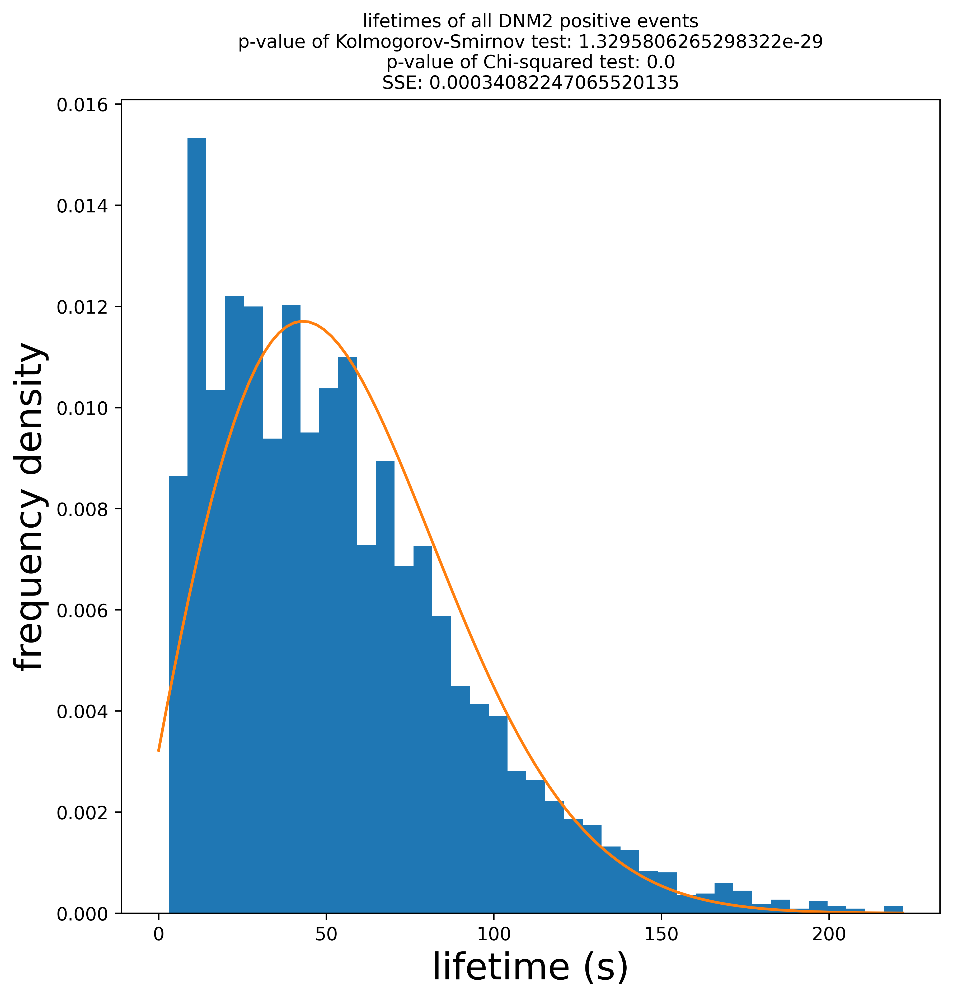

In [8]:
Image(filename=unique_user_saved_outputs+'/plots/dnm2_positive_events_fit_rayleigh.png', height=500, width=500)

# visualize all frequencies of DNM2 signal

In [9]:
all_dnm2_signal = []

for i in range(len(tracks_dnm2_positive)): # stack all DNM2 intensities

    raw_dnm2_intensity = list(return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_dnm2_positive,i,1))

    all_dnm2_signal += raw_dnm2_intensity    

In [10]:
dt = 1 # sampling interval

FFT = rfft(all_dnm2_signal) # real FFT of DNM2 signals

# Getting the related frequencies
freqs = rfftfreq(len(all_dnm2_signal), dt)

In [11]:
%%capture 

plt.style.use('default')

plt.figure(figsize=(8,8),dpi=500)
plt.hist2d(freqs, np.lib.scimath.log10(abs(FFT)), bins=100)
plt.xlabel('frequency (cycles/s)')
plt.ylabel('absolute value of FFT (log base 10 scaled)')
plt.title('FFT vs sample frequencies')
plt.savefig(unique_user_saved_outputs+'/plots/fft_of_dnm2_signals.png', bbox_inches='tight')

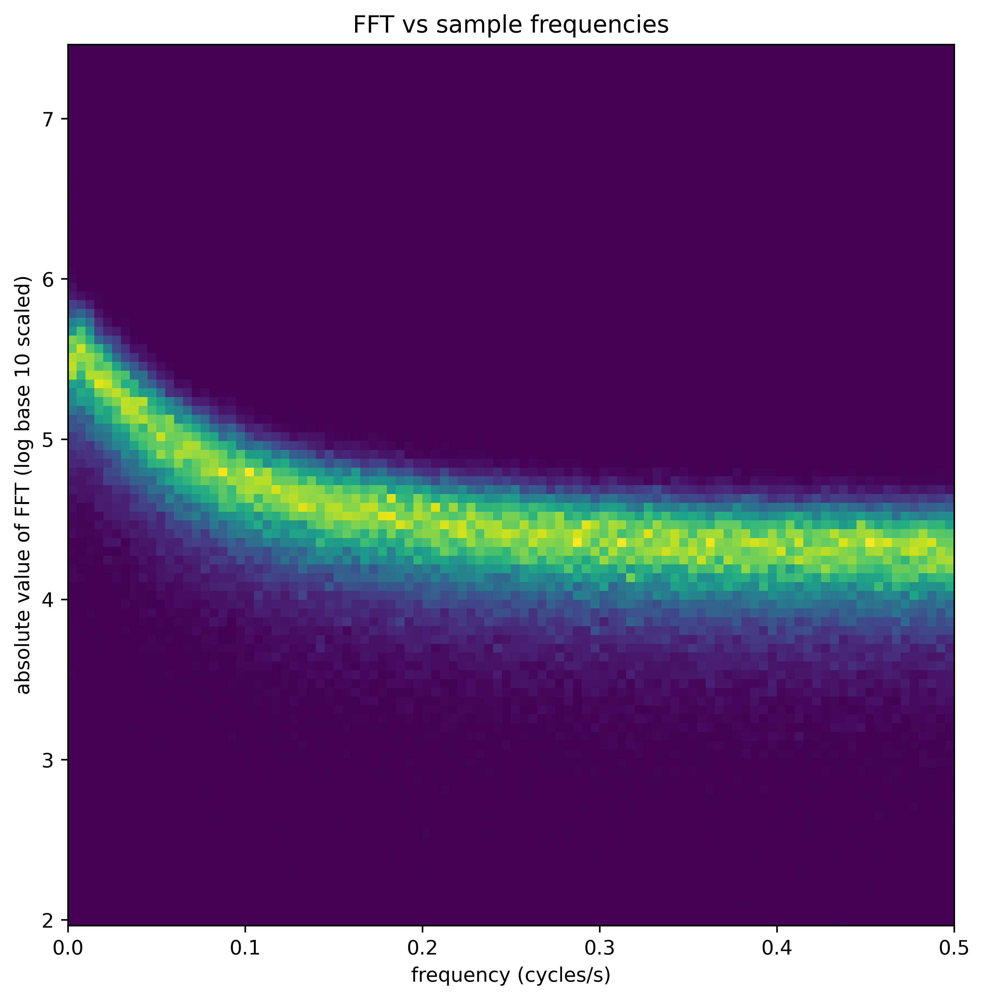

In [12]:
Image(filename=unique_user_saved_outputs+'/plots/fft_of_dnm2_signals.png', height=500, width=500)

# filter out all DNM2 traces where frequencies are greater than 0.2 cycles/second (greater than 5 second oscillations)

In [13]:
sos = signal.butter(4, 0.2, 'lp', fs=1, output='sos') # low-pass 4-th order Butterworth filter

filtered_amplitudes = [] # filtered DNM2 traces per track of interest

for i in range(len(tracks_dnm2_positive)):

    raw_intensity = return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_dnm2_positive,i,1)
    
    # add zeros to end to account for phase shift of near-track-end peaks
    filtered_amplitudes.append(list(list(signal.sosfilt(sos, raw_intensity)) + [0, 0, 0, 0, 0])) 

# set up a peak-finding parameter sweep over constraints: minimum peak height (a.u. fluorescence), minimum peak-to-peak distance (seconds), minimum peak width (seconds)

In [14]:
# a dictionary containing the one-hot encoding of single peaked traces (0: multiple peaks) for each peak-finding parameter combo
peak_detections_with_widths = {} 
number_of_peaks_in_event_per_model = {}

def find_single_peak_events_dist_height_width(test_distance, test_height, test_width):
    """fit lifetimes of single-peaked items found with specified peak finding paremeters to target Rayleigh distribution"""
    print('checking parameter combo: distance -', 
          test_distance, 
          'height - ',
          test_height, 
          'width - ',
           test_width)

    num_peaks = []
    
    current_param_outputs = [] # one-hot encoding of indices of tracks with a single peak (0: multiple peaks)

    num_single_peaked = 0 # initialize total number of tracks with a single peak

    for i in range(len(filtered_amplitudes)): # iterate through all filtered amplitudes
        
        pvals_dnm2 = return_track_attributes.return_pvals_detection_no_buffer(tracks_dnm2_positive, i, 1)
        
        # measure whether there is 1 peak with the specified peak-finding parameters
        if len(signal.find_peaks(filtered_amplitudes[i], 
                                 distance=test_distance, 
                                 height=test_height,
                                 width=test_width)[0])==1 and len(np.where(np.array(pvals_dnm2)<0.01)[0])>0:

            current_param_outputs.append(1)
            num_single_peaked += 1

        else:

            current_param_outputs.append(0)
        
        num_peaks.append(len(signal.find_peaks(filtered_amplitudes[i], 
                         distance=test_distance, 
                         height=test_height,
                         width=test_width)[0]))

        
    # store the indices of single-peaked tracks along with the current search parameters
    peak_detections_with_widths['min_dist_'+str(test_distance)+'_min_height_'+str(test_height)+'_min_width_'+str(test_width)] = current_param_outputs

    number_of_peaks_in_event_per_model['min_dist_'+str(test_distance)+'_min_height_'+str(test_height)+'_min_width_'+str(test_width)] = num_peaks
    
    # indices of single-peaked tracks
    indices_true = list(np.where(np.array(current_param_outputs)==1)[0])

    # single-peaked tracks
    tracks_true = np.array(tracks_dnm2_positive)[indices_true]

    lifetimes = []

    # gather lifetimes of single-peaked tracks
    for i in range(len(tracks_true)):

        lifetimes.append(return_track_attributes.return_track_lifetime(tracks_true,i))

    # initialize a Rayleigh distribution
    ray = stats.rayleigh

    param = ray.fit(lifetimes) # fit distribution

    ks_pvals = stats.kstest(lifetimes,stats.rayleigh(*param).cdf)[1] # measure Kolmogorov-Smirnov p-value between fitted and raw lifetimes

    ad_stat = anderson_statistic(lifetimes, dist=stats.rayleigh)
    
    percentiles = np.linspace(0,100,51)
    percentile_lifetime_thresholds = np.percentile(lifetimes, percentiles)
    obs_freq, bins = np.histogram(lifetimes, percentile_lifetime_thresholds);
    cum_obs_freq = np.cumsum(obs_freq)
    
    cdf_fitted = stats.rayleigh.cdf(percentile_lifetime_thresholds, loc=param[-2], scale=param[-1]);
    
    expected_frequency = []

    for bin_ in range(len(percentiles)-1):

        expected_cdf_area = cdf_fitted[bin_+1] - cdf_fitted[bin_]
        expected_frequency.append(expected_cdf_area * len(lifetimes))

    cum_expected_frequency = np.cumsum(np.array(expected_frequency))
        
    chi_sq_stat, chi_sq_pval = stats.chisquare(cum_obs_freq, cum_expected_frequency);
    
    obs_freq, bins = np.histogram(lifetimes, percentile_lifetime_thresholds,density=True)
    pdf = stats.rayleigh.pdf(bins[1:], *param)
    sse = np.sum(np.power(obs_freq - pdf, 2.0))    
    
    return num_single_peaked, ks_pvals, chi_sq_stat,  chi_sq_pval, sse # return the number of tracks with a single peak and the p-value of the goodness-of-fit

# vecetorize the function to allow for iterable inputs to search a parameter space of peak-finding constraints
vectorized_find_single_peak_events_dist_height_width = np.vectorize(find_single_peak_events_dist_height_width)

# perform parameter sweep over varying peak-finding constraints

In [15]:
distances_3 = np.arange(1,20,1) # minimum peak to peak distances
heights_3 = np.arange(50,300,25) # minimum peak heights
widths_3 = np.arange(1,10,1) # minimum peak widths

# create a 3-D mesh of all possible combinations of peak-finding parameters
distances_mesh_3, heights_mesh_3, widths_mesh_3 = np.meshgrid(distances_3,
                                                              heights_3, 
                                                              widths_3,
                                                              indexing='ij') 

In [16]:
%%capture
# calculate the number of single-peaked events and p-value of KS test fit to rayleigh distribution of lifetimes for all peak-finding parameters
a, b, c, d, e = vectorized_find_single_peak_events_dist_height_width(distances_mesh_3, 
                                                                  heights_mesh_3,
                                                                  widths_mesh_3)

num_single_peaked_with_width = a
significance_position_with_width = b
chi_squared_gof_stat = c
chi_squared_gof_pval = d
sse_param_sweep = e

In [17]:
np.save(unique_user_saved_outputs+"/dataframes/num_single_peaked_with_width", num_single_peaked_with_width)
np.save(unique_user_saved_outputs+"/dataframes/significance_position_with_width_rayleigh_fit", significance_position_with_width)
np.save(unique_user_saved_outputs+"/dataframes/chi_squared_gof_stat", chi_squared_gof_stat)
np.save(unique_user_saved_outputs+"/dataframes/chi_squared_gof_pval", chi_squared_gof_pval)
np.save(unique_user_saved_outputs+"/dataframes/sse_param_sweep", sse_param_sweep)

with open(unique_user_saved_outputs+'/dataframes/peak_detections_with_widths', 'wb') as f:
    pickle.dump(peak_detections_with_widths, f)
    
with open(unique_user_saved_outputs+'/dataframes/number_of_peaks_in_event_per_model', 'wb') as f:
    pickle.dump(number_of_peaks_in_event_per_model, f)

In [18]:
num_single_peaked_with_width = np.load(unique_user_saved_outputs+"/dataframes/num_single_peaked_with_width.npy")
significance_position_with_width = np.load(unique_user_saved_outputs+"/dataframes/significance_position_with_width_rayleigh_fit.npy")
chi_squared_gof_stat = np.load(unique_user_saved_outputs+"/dataframes/chi_squared_gof_stat.npy")
chi_squared_gof_pval = np.load(unique_user_saved_outputs+"/dataframes/chi_squared_gof_pval.npy")
sse_param_sweep = np.load(unique_user_saved_outputs+"/dataframes/sse_param_sweep.npy")

with open(unique_user_saved_outputs+'/dataframes/peak_detections_with_widths', 'rb') as f:
    peak_detections_with_widths = pickle.load(f)   
    
with open(unique_user_saved_outputs+'/dataframes/number_of_peaks_in_event_per_model', 'rb') as f:
    number_of_peaks_in_event_per_model = pickle.load(f) 

In [19]:
normal_scaler = preprocessing.QuantileTransformer(output_distribution='normal', random_state=817)
normal_scaled_data = normal_scaler.fit_transform(df_merged_features.values[:,:30])

pc_model = PCA(n_components=2, random_state=817)
reduced_data = pc_model.fit_transform(normal_scaled_data)
gmm = GMM(n_components=5, random_state=817)

gmm_prediction = gmm.fit_predict(reduced_data)

In [20]:
class MidpointNormalize(mpl.colors.Normalize): # https://stackoverflow.com/questions/7404116/defining-the-midpoint-of-a-colormap-in-matplotlib
    def __init__(self, vmin, vmax, midpoint=0, clip=False):
        self.midpoint = midpoint
        mpl.colors.Normalize.__init__(self, vmin, vmax, clip)

    def __call__(self, value, clip=None):
        normalized_min = max(0, 1 / 2 * (1 - abs((self.midpoint - self.vmin) / (self.midpoint - self.vmax))))
        normalized_max = min(1, 1 / 2 * (1 + abs((self.vmax - self.midpoint) / (self.midpoint - self.vmin))))
        normalized_mid = 0.5
        x, y = [self.vmin, self.midpoint, self.vmax], [normalized_min, normalized_mid, normalized_max]
        return np.ma.masked_array(np.interp(value, x, y))

In [21]:
%%capture
plt.style.use('default')
plt.rcParams['figure.dpi']=200
fig, ax = plt.subplots(1,1, constrained_layout=True, figsize=(4,3))

h=0.01 # https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_digits.html#sphx-glr-auto-examples-cluster-plot-kmeans-digits-py
# Plot the decision boundary. For that, we will assign a color to each
x_min, x_max = reduced_data[:, 0].min() - 1, reduced_data[:, 0].max() + 1
y_min, y_max = reduced_data[:, 1].min() - 4, reduced_data[:, 1].max() + 3
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Obtain labels for each point in mesh. Use last trained model.
Z = gmm.predict_proba(np.c_[xx.ravel(), yy.ravel()])
Z = np.max(Z, axis=1)

# Put the result into a color plot
Z = Z.reshape(xx.shape)

vmin = 0
vmax = 1
norm = MidpointNormalize(vmin=vmin, vmax=vmax, midpoint=0.95)
cmap = 'bwr'

plt.imshow(Z, interpolation='nearest',
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           aspect='auto', origin='lower', alpha=1,
           norm=norm,
           cmap=cmap)


indices_dnm2_pos = gmm_class_indices[index_DNM2positive]
ccp_predictions_all_indices = []

for ccp_predictions in peak_detections_with_widths.values():
    
    indices_dnm2_pos_ccp = np.where(np.array(ccp_predictions)==1)[0]
    
    indices_ccp_all = indices_dnm2_pos[indices_dnm2_pos_ccp]
    
    ccp_predictions_all_indices.append(indices_ccp_all)
    
fraction_of_models_event_ccp = np.zeros((df_merged_features.shape[0]))

for ccp_list in ccp_predictions_all_indices:
    
    for idx in ccp_list:
        
        fraction_of_models_event_ccp[idx] = fraction_of_models_event_ccp[idx] + 1

fraction_of_models_event_ccp = 1/len(ccp_predictions_all_indices)*fraction_of_models_event_ccp

sc = ax.scatter(df_pcs_normal_scaled_with_gmm_cluster['PC-0'],
           df_pcs_normal_scaled_with_gmm_cluster['PC-1'],
           c=fraction_of_models_event_ccp,
           s=1,
           alpha=1)
cba = fig.colorbar(sc,shrink=1, location='right')
cba.set_label('% of models that \nconsider event CCP', rotation=270, labelpad=25)
cba.set_alpha(1)
cba.draw_all()
ax.set_xlabel('PC-0');
ax.set_ylabel('PC-1');

ax.set_xticks([-5, 0, 5, 10], minor=False);
ax.set_xticklabels([-5, 0, 5, 10], minor=False);
ax.set_yticks([-10, -5, 0, 5, 10], minor=False);
ax.set_yticklabels([-10, -5, 0, 5, 10], minor=False);
ax.set_ylim([-7,11]);
ax.set_xlim([-9, 13]);
plt.savefig(unique_user_saved_outputs+'/plots/percent_models_consider_event_ccp_overlaid_pcs.png', bbox_inches='tight')

# percentage of models that consider event a CCP

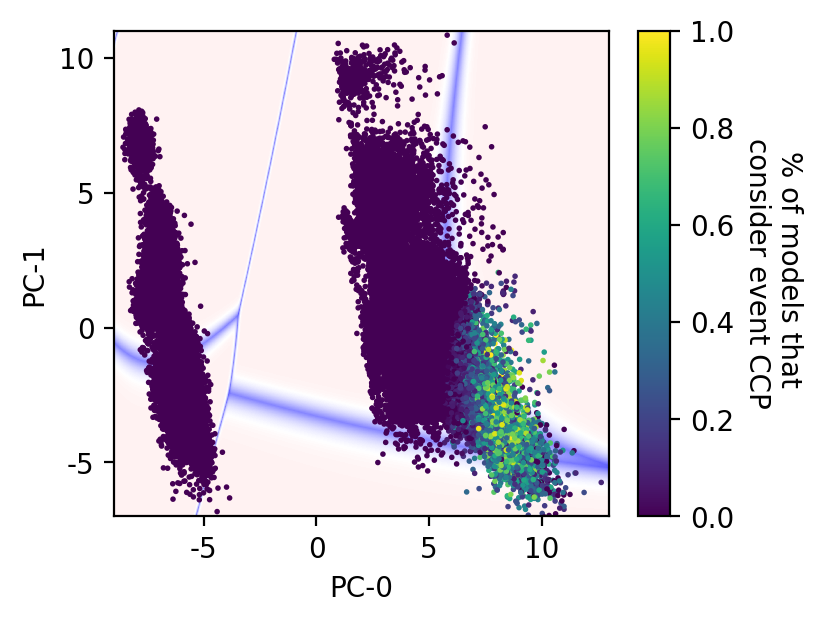

In [22]:
Image(filename=unique_user_saved_outputs+'/plots/percent_models_consider_event_ccp_overlaid_pcs.png', height=500, width=500)

In [23]:
%%capture
plt.style.use('default')
plt.rcParams['figure.dpi']=200
fig, ax = plt.subplots(1,1, constrained_layout=True, figsize=(4,3))

h=0.01 # https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_digits.html#sphx-glr-auto-examples-cluster-plot-kmeans-digits-py
# Plot the decision boundary. For that, we will assign a color to each
x_min, x_max = reduced_data[:, 0].min() - 1, reduced_data[:, 0].max() + 1
y_min, y_max = reduced_data[:, 1].min() - 4, reduced_data[:, 1].max() + 3
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Obtain labels for each point in mesh. Use last trained model.
Z = gmm.predict_proba(np.c_[xx.ravel(), yy.ravel()])
Z = np.max(Z, axis=1)

# Put the result into a color plot
Z = Z.reshape(xx.shape)

vmin = 0
vmax = 1
norm = MidpointNormalize(vmin=vmin, vmax=vmax, midpoint=0.95)
cmap = 'bwr'

ax.imshow(Z, interpolation='nearest',
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           aspect='auto', origin='lower', alpha=1,
           norm=norm,
           cmap=cmap)


indices_dnm2_pos = gmm_class_indices[index_DNM2positive]
ccp_predictions_all_indices = []

for ccp_predictions in peak_detections_with_widths.values():
    
    indices_dnm2_pos_ccp = np.where(np.array(ccp_predictions)==1)[0]
    
    indices_ccp_all = indices_dnm2_pos[indices_dnm2_pos_ccp]
    
    ccp_predictions_all_indices.append(indices_ccp_all)
    
fraction_of_models_event_ccp = np.zeros((df_merged_features.shape[0]))

for ccp_list in ccp_predictions_all_indices:
    
    for idx in ccp_list:
        
        fraction_of_models_event_ccp[idx] = fraction_of_models_event_ccp[idx] + 1

fraction_of_models_event_ccp = 1/len(ccp_predictions_all_indices)*fraction_of_models_event_ccp


sc = ax.scatter(df_pcs_normal_scaled_with_gmm_cluster['PC-0'],
           df_pcs_normal_scaled_with_gmm_cluster['PC-1'],
           c=fraction_of_models_event_ccp,
           s=1,
           alpha=1)
cba = fig.colorbar(sc,shrink=1, location='right')
cba.set_label('% of models that \nconsider event CCP', rotation=270, labelpad=25)
cba.set_alpha(1)
cba.draw_all()
ax.set_xlabel('PC-0');
ax.set_ylabel('PC-1');

ax.set_xticks([-5, 0, 5, 10], minor=False);
ax.set_xticklabels([-5, 0, 5, 10], minor=False);
ax.set_yticks([-10, -5, 0, 5, 10], minor=False);
ax.set_yticklabels([-10, -5, 0, 5, 10], minor=False);
ax.set_ylim([-7,4]);
ax.set_xlim([4,13]);
plt.savefig(unique_user_saved_outputs+'/plots/percent_models_consider_event_ccp_overlaid_pcs_zoom_dnm2cluster.png', bbox_inches='tight')

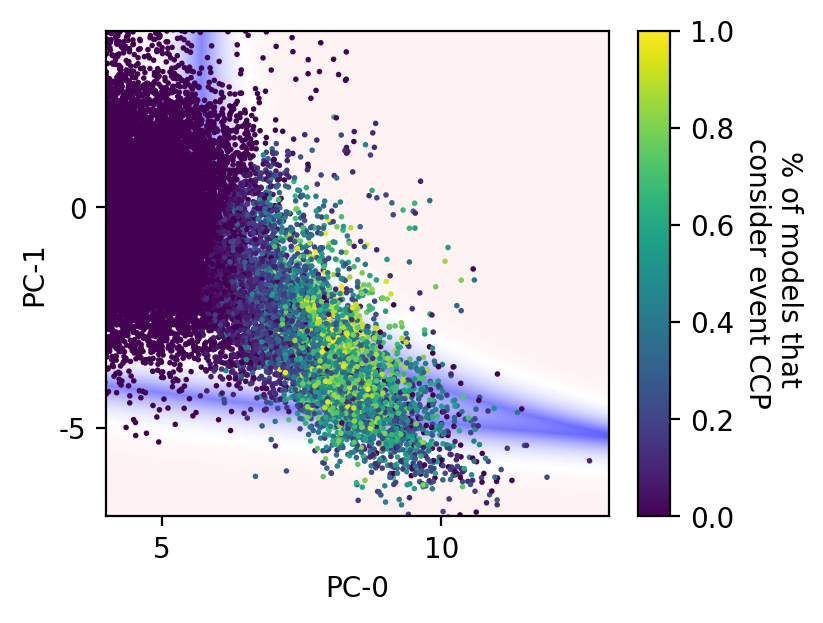

In [24]:
Image(filename=unique_user_saved_outputs+'/plots/percent_models_consider_event_ccp_overlaid_pcs_zoom_dnm2cluster.png', height=500, width=500)

# percentage of models that consider event a CCP, only considering models with good Rayleigh fit

In [25]:
%%capture
plt.style.use('default')
plt.rcParams['figure.dpi']=200
fig, ax = plt.subplots(1,1, constrained_layout=True, figsize=(4,3))

h=0.01 # https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_digits.html#sphx-glr-auto-examples-cluster-plot-kmeans-digits-py
# Plot the decision boundary. For that, we will assign a color to each
x_min, x_max = reduced_data[:, 0].min() - 1, reduced_data[:, 0].max() + 1
y_min, y_max = reduced_data[:, 1].min() - 4, reduced_data[:, 1].max() + 3
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Obtain labels for each point in mesh. Use last trained model.
Z = gmm.predict_proba(np.c_[xx.ravel(), yy.ravel()])
Z = np.max(Z, axis=1)

# Put the result into a color plot
Z = Z.reshape(xx.shape)
vmin = 0
vmax = 1
norm = MidpointNormalize(vmin=vmin, vmax=vmax, midpoint=0.95)
cmap = 'bwr'

ax.imshow(Z, interpolation='nearest',
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           aspect='auto', origin='lower', alpha=1,
           norm=norm,
           cmap=cmap)

fraction_of_models_event_ccp = np.zeros((df_merged_features.shape[0]))

for i, ccp_list in enumerate(ccp_predictions_all_indices):
    
    if significance_position_with_width.flatten()[i]>0.01:

        for idx in ccp_list:

            fraction_of_models_event_ccp[idx] = fraction_of_models_event_ccp[idx] + 1

fraction_of_models_event_ccp = 1/len(np.where(significance_position_with_width.flatten()>0.01)[0])*fraction_of_models_event_ccp


sc = ax.scatter(df_pcs_normal_scaled_with_gmm_cluster['PC-0'],
           df_pcs_normal_scaled_with_gmm_cluster['PC-1'],
           c=fraction_of_models_event_ccp,
           s=1,
           alpha=1)
cba = fig.colorbar(sc,shrink=1, location='right')
cba.set_label('% of models that \nconsider event CCP\n (only looking at KS p-val > 0.01)', rotation=270, labelpad=40)
cba.set_alpha(1)
cba.draw_all()
ax.set_xlabel('PC-0');
ax.set_ylabel('PC-1');

ax.set_xticks([-5, 0, 5, 10], minor=False);
ax.set_xticklabels([-5, 0, 5, 10], minor=False);
ax.set_yticks([-10, -5, 0, 5, 10], minor=False);
ax.set_yticklabels([-10, -5, 0, 5, 10], minor=False);
ax.set_ylim([-7,4]);
ax.set_xlim([4,13]);
plt.savefig(unique_user_saved_outputs+'/plots/percent_models_sigKS_consider_event_ccp_overlaid_pcs.png', bbox_inches='tight')

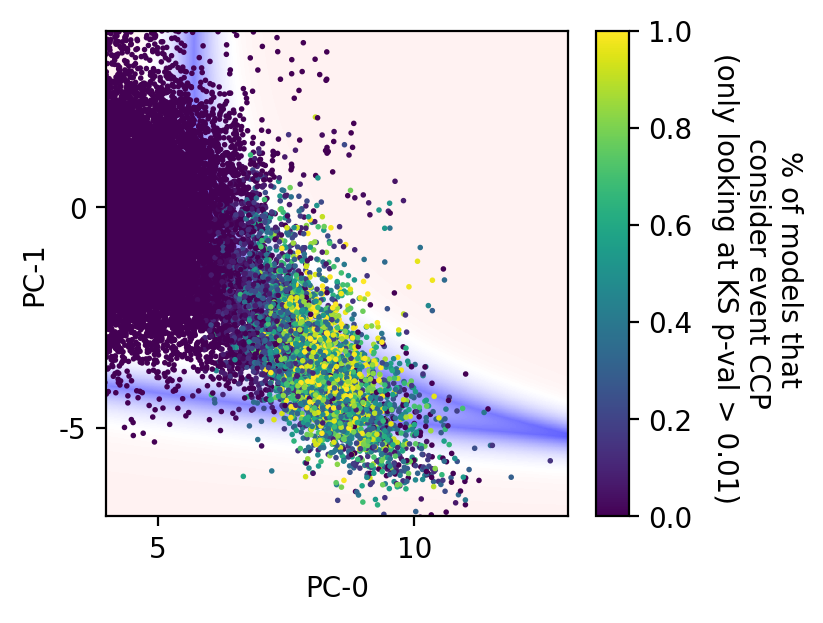

In [26]:
Image(filename=unique_user_saved_outputs+'/plots/percent_models_sigKS_consider_event_ccp_overlaid_pcs.png', height=500, width=500)

# percentage of models that consider event a hot-spot, only considering models with good Rayleigh fit

In [27]:
%%capture
plt.style.use('default')
plt.rcParams['figure.dpi']=200
fig, ax = plt.subplots(1,1, constrained_layout=True, figsize=(4,3))

h=0.01 # https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_digits.html#sphx-glr-auto-examples-cluster-plot-kmeans-digits-py
# Plot the decision boundary. For that, we will assign a color to each
x_min, x_max = reduced_data[:, 0].min() - 1, reduced_data[:, 0].max() + 1
y_min, y_max = reduced_data[:, 1].min() - 4, reduced_data[:, 1].max() + 3
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Obtain labels for each point in mesh. Use last trained model.
Z = gmm.predict_proba(np.c_[xx.ravel(), yy.ravel()])
Z = np.max(Z, axis=1)

# Put the result into a color plot
Z = Z.reshape(xx.shape)
vmin = 0
vmax = 1
norm = MidpointNormalize(vmin=vmin, vmax=vmax, midpoint=0.95)
cmap = 'bwr'

ax.imshow(Z, interpolation='nearest',
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           aspect='auto', origin='lower', alpha=1,
           norm=norm,
           cmap=cmap)

indices_dnm2_pos = gmm_class_indices[index_DNM2positive]
ccp_predictions_all_indices = []

for ccp_predictions in number_of_peaks_in_event_per_model.values():
    
    indices_dnm2_pos_ccp = np.where(np.array(ccp_predictions)>=2)[0]
    
    indices_ccp_all = indices_dnm2_pos[indices_dnm2_pos_ccp]
    
    ccp_predictions_all_indices.append(indices_ccp_all)
    
fraction_of_models_event_ccp = np.zeros((df_merged_features.shape[0]))

for i, ccp_list in enumerate(ccp_predictions_all_indices):
    
    if significance_position_with_width.flatten()[i]>0.01:

        for idx in ccp_list:

            fraction_of_models_event_ccp[idx] = fraction_of_models_event_ccp[idx] + 1

fraction_of_models_event_ccp = 1/len(np.where(significance_position_with_width.flatten()>0.01)[0])*fraction_of_models_event_ccp


sc = ax.scatter(df_pcs_normal_scaled_with_gmm_cluster['PC-0'],
           df_pcs_normal_scaled_with_gmm_cluster['PC-1'],
           c=fraction_of_models_event_ccp,
           s=1,
           alpha=1)
cba = fig.colorbar(sc,shrink=1, location='right')
cba.set_label('% of models that \nconsider event at least 2-peaked\n (only looking at KS p-val > 0.01)', rotation=270, labelpad=40)
cba.set_alpha(1)
cba.draw_all()
ax.set_xlabel('PC-0');
ax.set_ylabel('PC-1');

ax.set_xticks([-5, 0, 5, 10], minor=False);
ax.set_xticklabels([-5, 0, 5, 10], minor=False);
ax.set_yticks([-10, -5, 0, 5, 10], minor=False);
ax.set_yticklabels([-10, -5, 0, 5, 10], minor=False);
ax.set_ylim([-7,4]);
ax.set_xlim([4,13]);
plt.savefig(unique_user_saved_outputs+'/plots/percent_models_sigKS_consider_event_hotspot_overlaid_pcs.png', bbox_inches='tight')

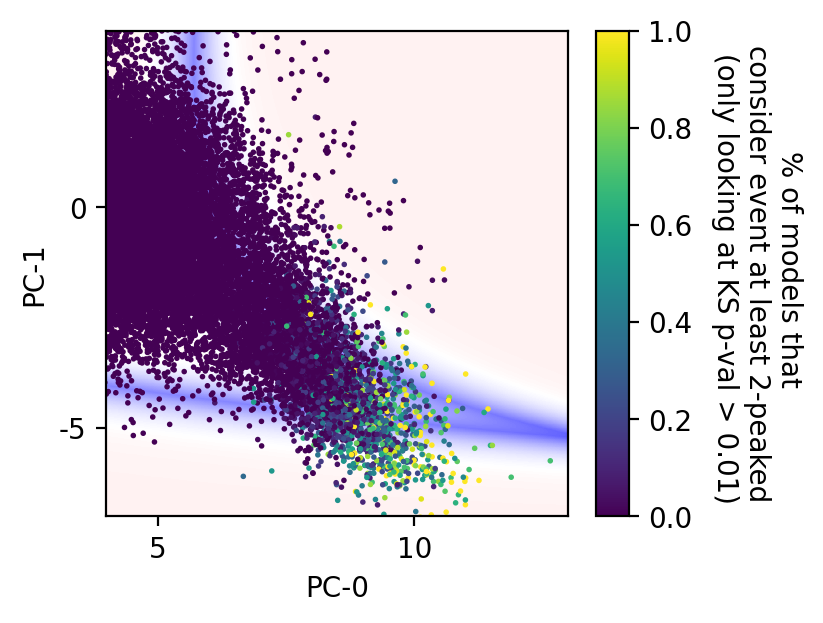

In [28]:
Image(filename=unique_user_saved_outputs+'/plots/percent_models_sigKS_consider_event_hotspot_overlaid_pcs.png', height=500, width=500)

# percentage of models that consider event non-peaked, only considering models with good Rayleigh fit

In [29]:
%%capture
plt.style.use('default')
plt.rcParams['figure.dpi']=200
fig, ax = plt.subplots(1,1, constrained_layout=True, figsize=(4,3))

h=0.01 # https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_digits.html#sphx-glr-auto-examples-cluster-plot-kmeans-digits-py
# Plot the decision boundary. For that, we will assign a color to each
x_min, x_max = reduced_data[:, 0].min() - 1, reduced_data[:, 0].max() + 1
y_min, y_max = reduced_data[:, 1].min() - 4, reduced_data[:, 1].max() + 3
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Obtain labels for each point in mesh. Use last trained model.
Z = gmm.predict_proba(np.c_[xx.ravel(), yy.ravel()])
Z = np.max(Z, axis=1)

# Put the result into a color plot
Z = Z.reshape(xx.shape)
vmin = 0
vmax = 1
norm = MidpointNormalize(vmin=vmin, vmax=vmax, midpoint=0.95)
cmap = 'bwr'

ax.imshow(Z, interpolation='nearest',
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           aspect='auto', origin='lower', alpha=1,
           norm=norm,
           cmap=cmap)

indices_dnm2_pos = gmm_class_indices[index_DNM2positive]
ccp_predictions_all_indices = []

for ccp_predictions in number_of_peaks_in_event_per_model.values():
    
    indices_dnm2_pos_ccp = np.where(np.array(ccp_predictions)==0)[0]
    
    indices_ccp_all = indices_dnm2_pos[indices_dnm2_pos_ccp]
    
    ccp_predictions_all_indices.append(indices_ccp_all)
    
fraction_of_models_event_ccp = np.zeros((df_merged_features.shape[0]))

for i, ccp_list in enumerate(ccp_predictions_all_indices):
    
    if significance_position_with_width.flatten()[i]>0.01:

        for idx in ccp_list:

            fraction_of_models_event_ccp[idx] = fraction_of_models_event_ccp[idx] + 1

fraction_of_models_event_ccp = 1/len(np.where(significance_position_with_width.flatten()>0.01)[0])*fraction_of_models_event_ccp


sc = ax.scatter(df_pcs_normal_scaled_with_gmm_cluster['PC-0'],
           df_pcs_normal_scaled_with_gmm_cluster['PC-1'],
           c=fraction_of_models_event_ccp,
           s=1,
           alpha=1)
cba = fig.colorbar(sc,shrink=1, location='right')
cba.set_label('% of models that \nconsider event non-peaked\n (only looking at KS p-val > 0.01)', rotation=270, labelpad=40)
cba.set_alpha(1)
cba.draw_all()
ax.set_xlabel('PC-0');
ax.set_ylabel('PC-1');

ax.set_xticks([-5, 0, 5, 10], minor=False);
ax.set_xticklabels([-5, 0, 5, 10], minor=False);
ax.set_yticks([-10, -5, 0, 5, 10], minor=False);
ax.set_yticklabels([-10, -5, 0, 5, 10], minor=False);
ax.set_ylim([-7,4]);
ax.set_xlim([4,13]);
plt.savefig(unique_user_saved_outputs+'/plots/percent_models_sigKS_consider_event_nonpeaked_overlaid_pcs.png', bbox_inches='tight')

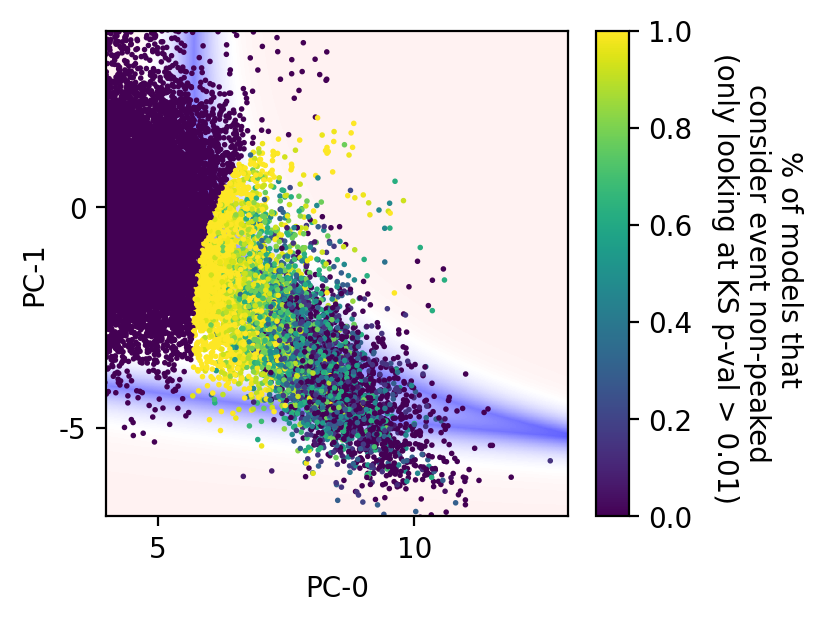

In [30]:
Image(filename=unique_user_saved_outputs+'/plots/percent_models_sigKS_consider_event_nonpeaked_overlaid_pcs.png', height=500, width=500)

# number of single-peaked events across candidate models

In [31]:
%%capture
plt.style.use('default')
plt.figure(dpi=500, figsize=(4,4))
plt.hist(num_single_peaked_with_width.flatten(), bins='doane')
plt.xlabel('number of single-peaked events \n(per peak finding condition)')
plt.ylabel('counts')
plt.savefig(unique_user_saved_outputs+'/plots/num_single_peaked.png', bbox_inches='tight')

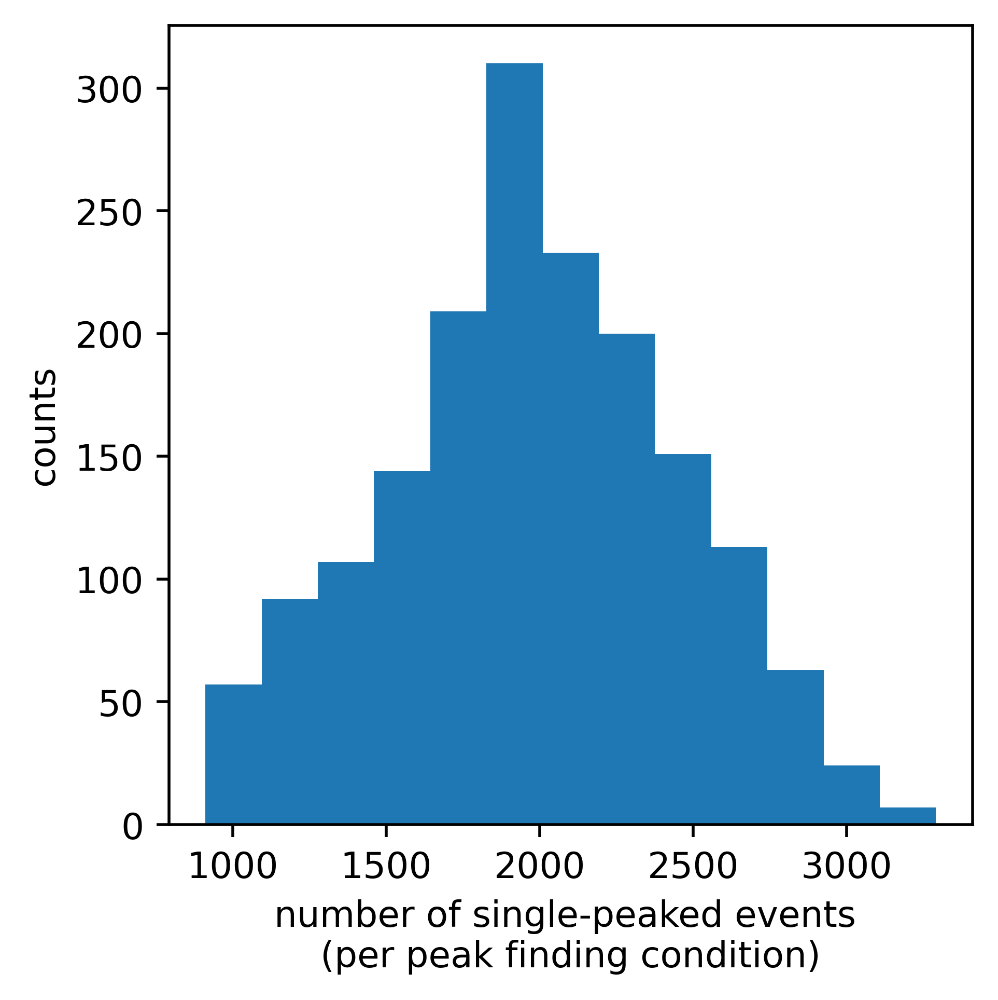

In [32]:
Image(filename=unique_user_saved_outputs+'/plots/num_single_peaked.png', height=500, width=500)

# KS-test p-value across candidate models

In [33]:
%%capture
plt.style.use('default')
plt.figure(dpi=500, figsize=(4,4))
plt.hist(significance_position_with_width.flatten(), bins='doane')
plt.xlabel('p-value of KS-test \n(per peak finding condition)')
plt.ylabel('counts')
plt.savefig(unique_user_saved_outputs+'/plots/ks_val_per_ccpmodel.png', bbox_inches='tight')

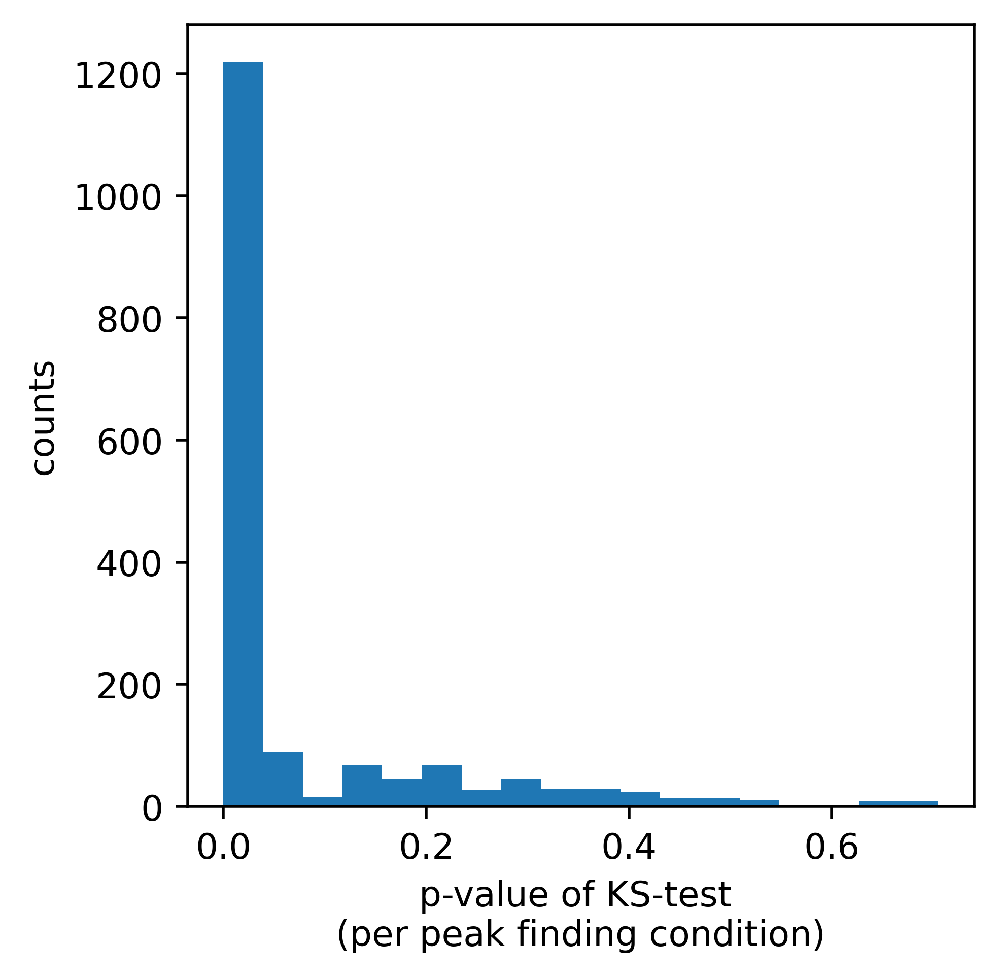

In [34]:
Image(filename=unique_user_saved_outputs+'/plots/ks_val_per_ccpmodel.png', height=500, width=500)

# Chi-squared p-value across candidate models

In [35]:
%%capture
plt.style.use('default')
plt.figure(dpi=500, figsize=(4,4))
plt.hist(chi_squared_gof_pval.flatten(), bins='doane')
plt.xlabel('Chi-squared goodness-of-fit p-value \n(per peak finding condition)')
plt.ylabel('counts')
plt.savefig(unique_user_saved_outputs+'/plots/cspval_val_per_ccpmodel.png', bbox_inches='tight')

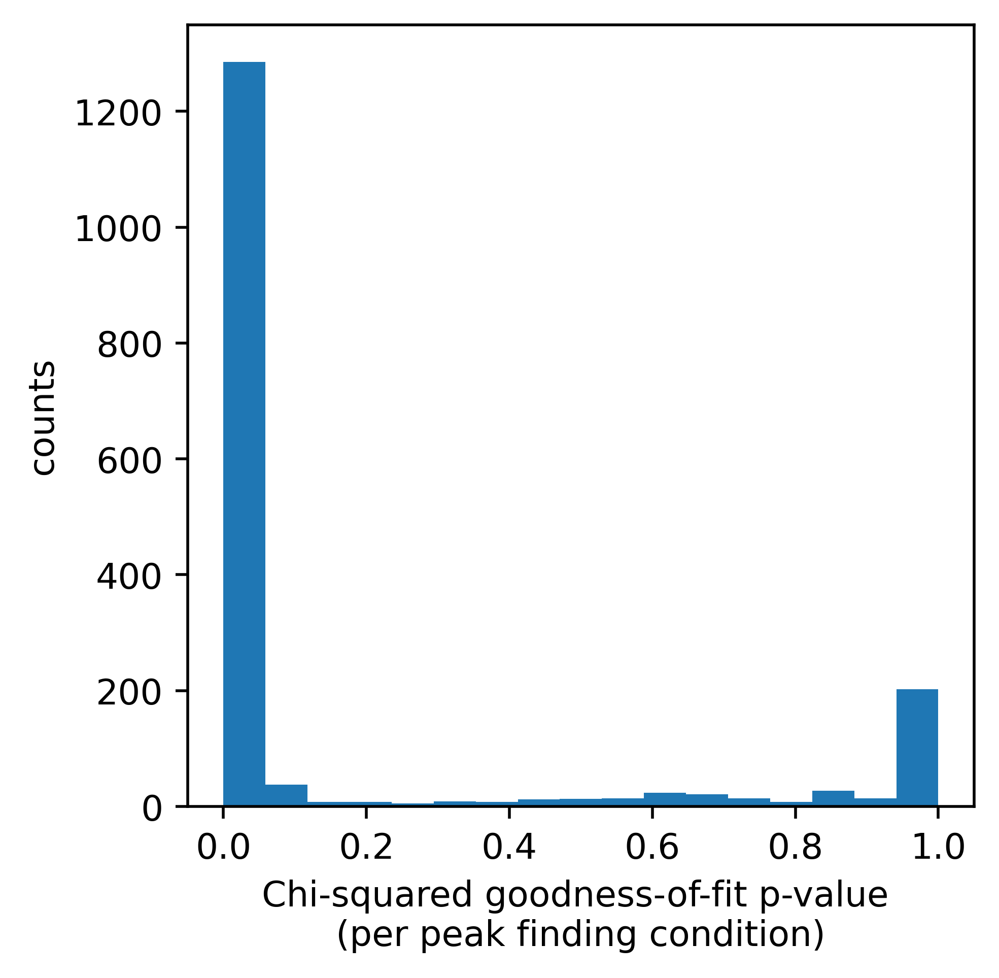

In [36]:
Image(filename=unique_user_saved_outputs+'/plots/cspval_val_per_ccpmodel.png', height=500, width=500)

In [37]:
%%capture
plt.style.use('default')
plt.figure(dpi=500, figsize=(4,4))
plt.hist(chi_squared_gof_stat.flatten(), bins='doane')
plt.xlabel('Chi-squared statistic \n(per peak finding condition)')
plt.ylabel('counts')
plt.savefig(unique_user_saved_outputs+'/plots/csstat_val_per_ccpmodel.png', bbox_inches='tight')

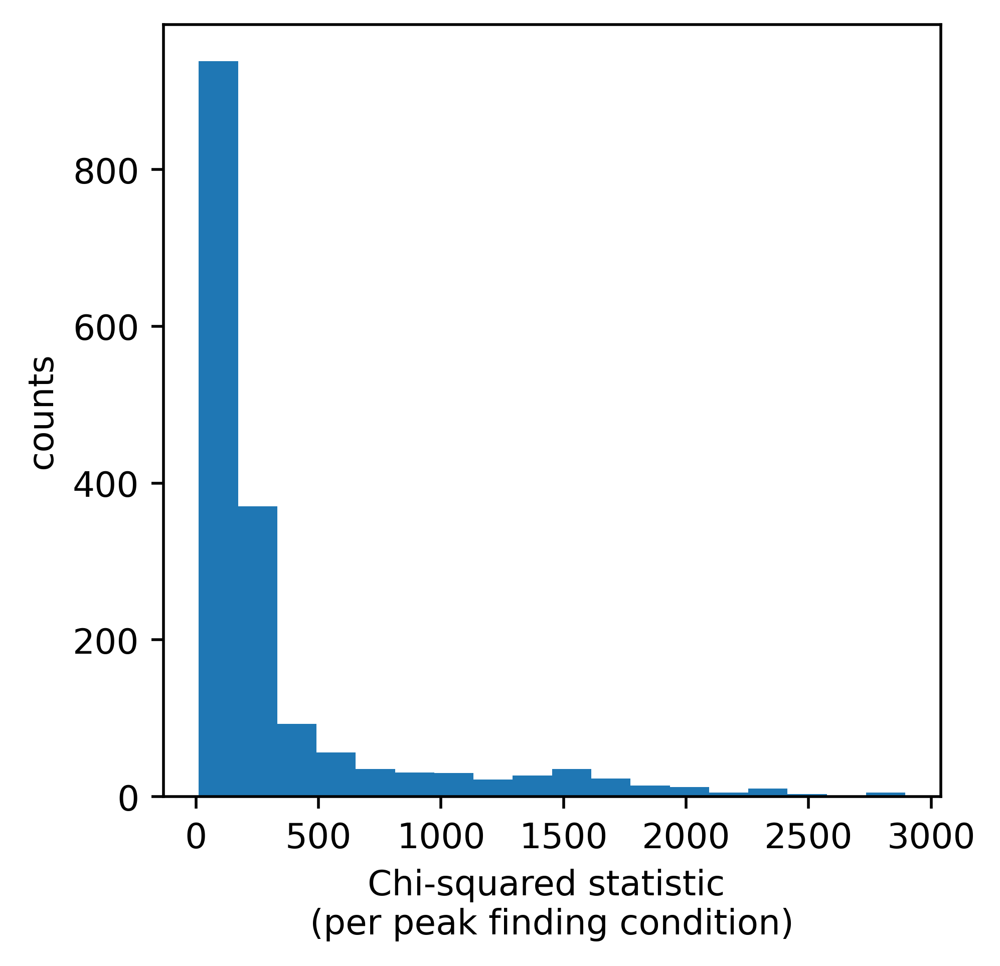

In [38]:
Image(filename=unique_user_saved_outputs+'/plots/csstat_val_per_ccpmodel.png', height=500, width=500)

In [39]:
%%capture
plt.style.use('default')
plt.figure(dpi=500, figsize=(4,4))
plt.scatter(chi_squared_gof_pval.flatten(), chi_squared_gof_stat.flatten(), alpha=0.2)
plt.xlabel('Chi-squared GOF p-value')
plt.ylabel('Chi-squared GOF statistic')
plt.savefig(unique_user_saved_outputs+'/plots/chisqstat_vs_chisqpval.png', bbox_inches='tight')

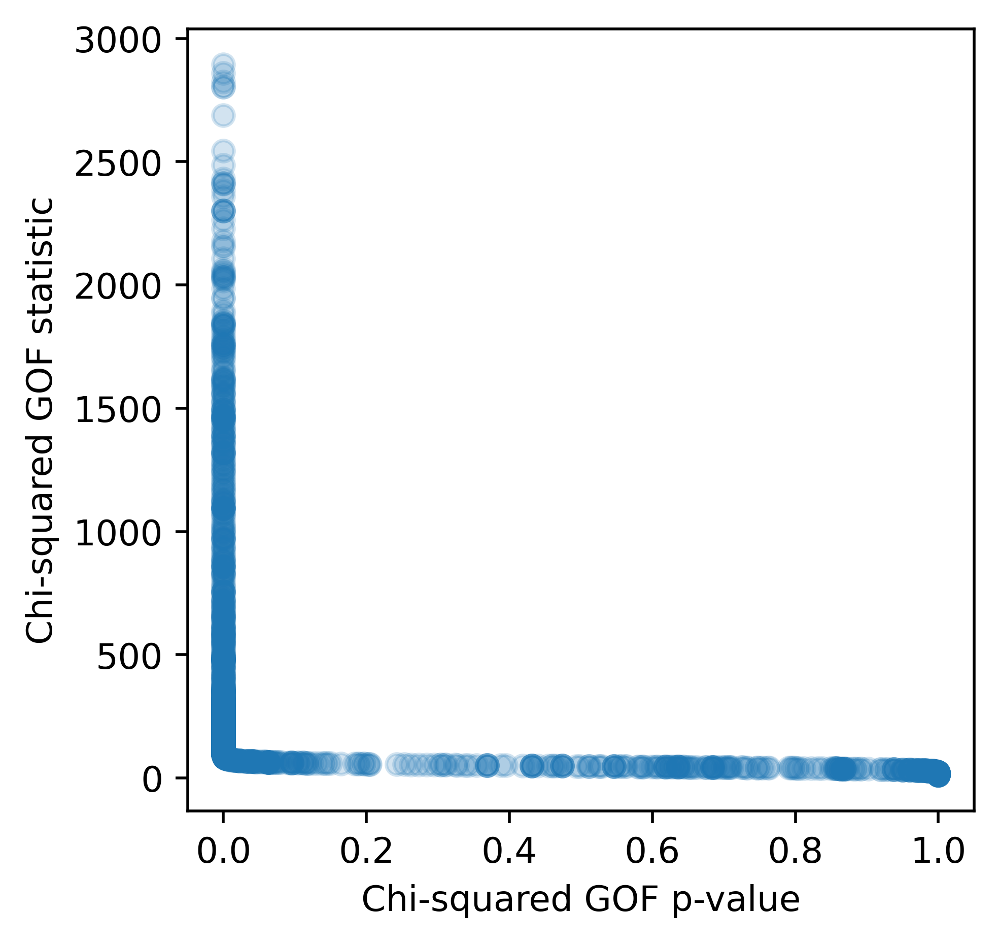

In [40]:
Image(filename=unique_user_saved_outputs+'/plots/chisqstat_vs_chisqpval.png', height=500, width=500)

# comparisons between goodness-of-fit statistics and numbers of CCPs

In [41]:
%%capture
plt.style.use('default')
plt.figure(dpi=500, figsize=(4,4))
sc = plt.scatter(chi_squared_gof_stat.flatten(), num_single_peaked_with_width.flatten(), alpha=0.2, c=chi_squared_gof_pval.flatten())
plt.xlabel('Chi-squared GOF statistic')
plt.ylabel('number of \nsingle-peaked events')
cba = plt.colorbar(sc, label='p-value of Chi-squared test')
plt.savefig(unique_user_saved_outputs+'/plots/numsingle_peaked_vs_csgofstat_colored_csgofpval.png', bbox_inches='tight')

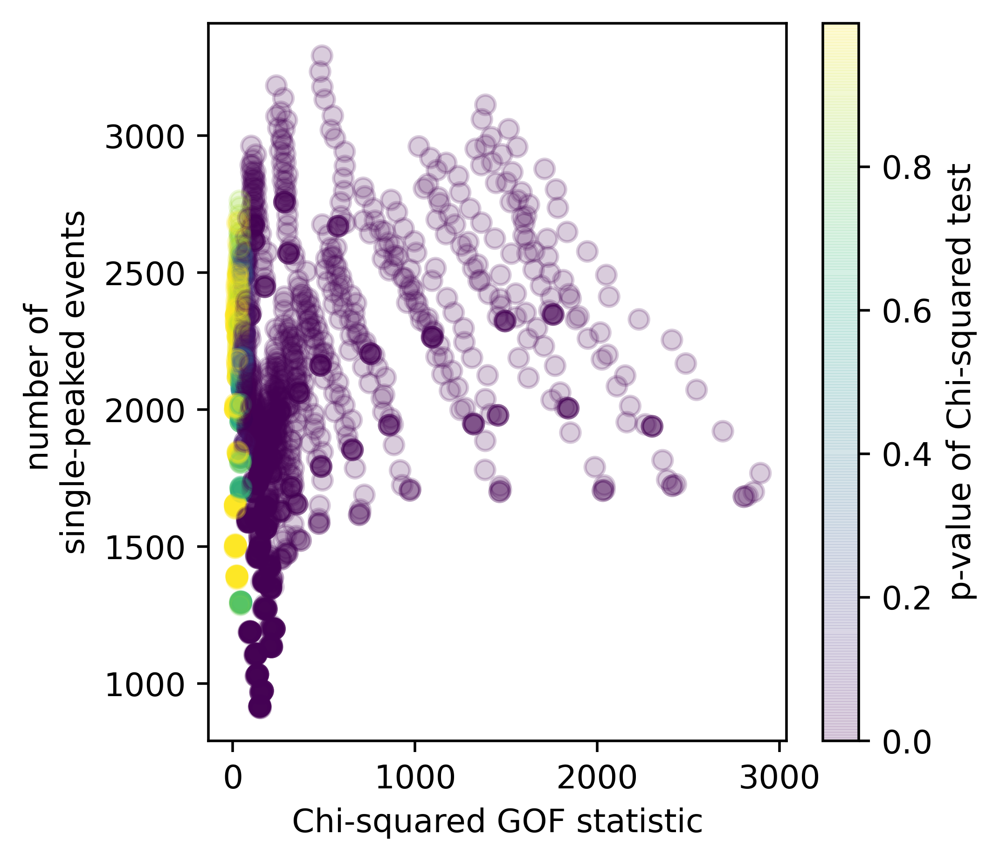

In [42]:
Image(filename=unique_user_saved_outputs+'/plots/numsingle_peaked_vs_csgofstat_colored_csgofpval.png', height=500, width=500)

In [43]:
%%capture
plt.style.use('default')
plt.figure(dpi=500, figsize=(4,4))
sc = plt.scatter(chi_squared_gof_pval.flatten(), num_single_peaked_with_width.flatten(), alpha=0.1, c=chi_squared_gof_stat.flatten())
plt.xlabel('Chi-squared GOF p-value')
plt.ylabel('number of \nsingle-peaked events')
cba = plt.colorbar(sc, label='Chi-squared statistic')
plt.savefig(unique_user_saved_outputs+'/plots/chi_squared_gof_pval_vs_num_single_peaked_with_width_colored_chi_squared_gof_stat.png', bbox_inches='tight')

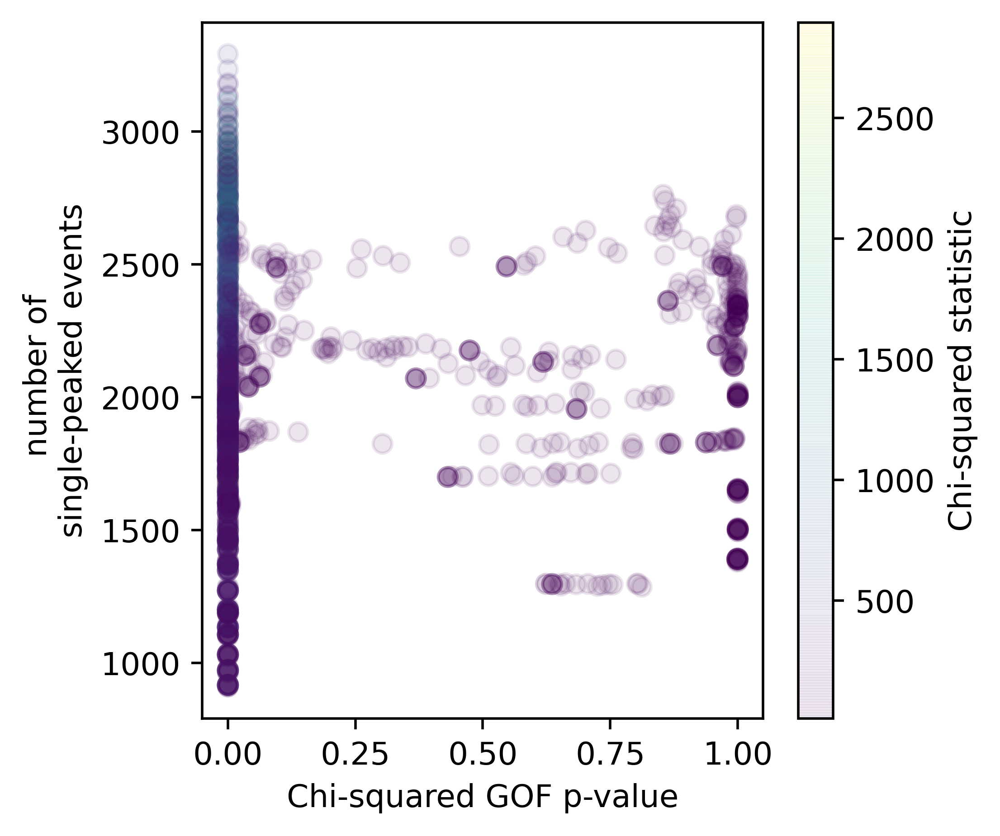

In [44]:
Image(filename=unique_user_saved_outputs+'/plots/chi_squared_gof_pval_vs_num_single_peaked_with_width_colored_chi_squared_gof_stat.png', height=500, width=500)

In [45]:
%%capture
plt.style.use('default')
plt.figure(dpi=500, figsize=(4,4))
sc = plt.scatter(significance_position_with_width.flatten(), num_single_peaked_with_width.flatten(), alpha=0.2, c=chi_squared_gof_stat.flatten())
plt.xlabel('KS-test p-value')
plt.ylabel('number of \nsingle-peaked events')
cba = plt.colorbar(sc, label='Chi-squared statistic')
plt.savefig(unique_user_saved_outputs+'/plots/significance_position_with_width_vs_num_single_peaked_with_width_colored_chi_squared_gof_stat.png', bbox_inches='tight')

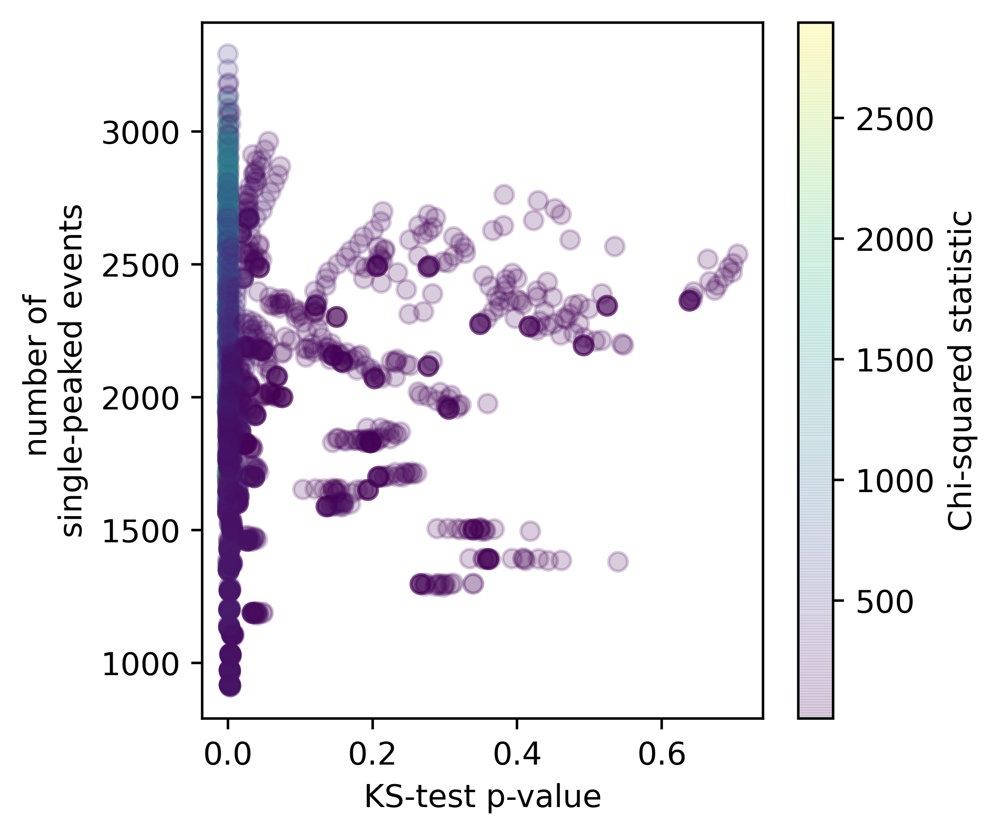

In [46]:
Image(filename=unique_user_saved_outputs+'/plots/significance_position_with_width_vs_num_single_peaked_with_width_colored_chi_squared_gof_stat.png', height=500, width=500)

In [47]:
%%capture
plt.style.use('default')
plt.figure(dpi=500, figsize=(4,4))
sc = plt.scatter(significance_position_with_width.flatten(), num_single_peaked_with_width.flatten(), alpha=0.2, c=chi_squared_gof_pval.flatten())
plt.xlabel('KS-test p-value')
plt.ylabel('number of \nsingle-peaked events')
cba = plt.colorbar(sc, label='p-value of Chi-squared test')
plt.savefig(unique_user_saved_outputs+'/plots/significance_position_with_width_vs_num_single_peaked_with_width_colored_chi_squared_gof_pval.png', bbox_inches='tight')

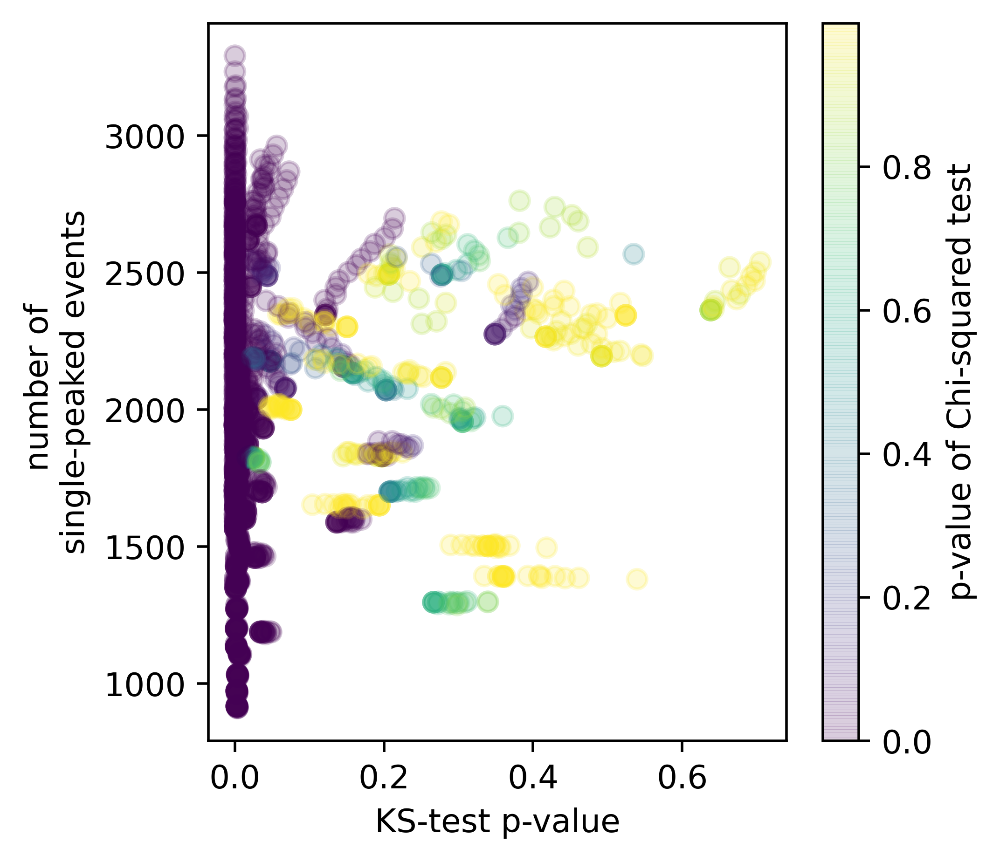

In [48]:
Image(filename=unique_user_saved_outputs+'/plots/significance_position_with_width_vs_num_single_peaked_with_width_colored_chi_squared_gof_pval.png', height=500, width=500)

In [49]:
%%capture
plt.style.use('default')
plt.figure(dpi=500, figsize=(4,4))
sc = plt.scatter(significance_position_with_width.flatten(), sse_param_sweep.flatten(), alpha=0.2, c=chi_squared_gof_pval.flatten())
plt.yscale('log')
plt.xlabel('KS-test p-value')
plt.ylabel('SSE')
cba = plt.colorbar(sc, label='p-value of Chi-squared test')
plt.tight_layout()
plt.savefig(unique_user_saved_outputs+'/plots/three_stats_tests_ccp_finding.png', bbox_inches='tight')

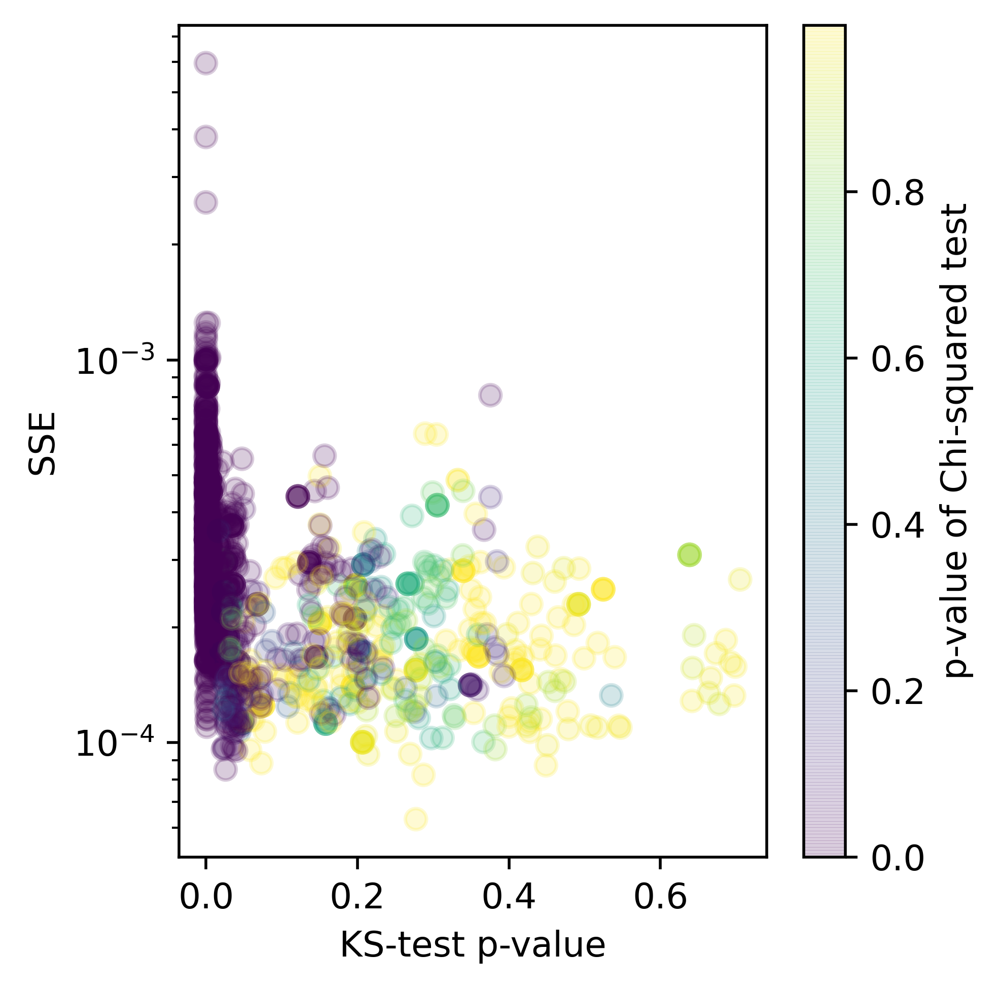

In [50]:
Image(filename=unique_user_saved_outputs+'/plots/three_stats_tests_ccp_finding.png', height=500, width=500)

In [51]:
all_peak_predictions_with_widths = []

for combo in peak_detections_with_widths.keys():

    all_peak_predictions_with_widths.append(peak_detections_with_widths[combo])

all_peak_predictions_with_widths = np.array(all_peak_predictions_with_widths).T

df_peak_predictions_with_widths = pd.DataFrame(data=all_peak_predictions_with_widths, columns=peak_detections_with_widths.keys())

ind_best_fit = np.unravel_index(np.argmax(significance_position_with_width, axis=None), significance_position_with_width.shape)

distance_best_fit = distances_3[ind_best_fit[0]]
height_best_fit = heights_3[ind_best_fit[1]]
width_best_fit = widths_3[ind_best_fit[2]]

np.save(unique_user_saved_outputs+'/dataframes/parameters_best_fit_peak_finding', 
        [distance_best_fit, height_best_fit, width_best_fit])

print('best fit parameters for distance, height, and width:', distance_best_fit, height_best_fit, width_best_fit)

track_indices_best_fit_model_single_peak = peak_detections_with_widths['min_dist_'+str(distance_best_fit)+'_min_height_'+str(height_best_fit)+'_min_width_'+str(width_best_fit)]

np.save(unique_user_saved_outputs+'/dataframes/indices_ccp_predictions_' + \
        'min_dist_'+str(distance_best_fit)+'_min_height_'+str(height_best_fit)+ \
        '_min_width_'+str(width_best_fit)+ '.npy',
        track_indices_best_fit_model_single_peak)

indices_true = list(np.where(np.array(track_indices_best_fit_model_single_peak)==1)[0])

tracks_true = np.array(tracks_dnm2_positive)[indices_true]

indices_false = list(np.where(np.array(track_indices_best_fit_model_single_peak)==0)[0])

tracks_false = np.array(tracks_dnm2_positive)[indices_false]

lifetimes_ccp = []

print('the number of CCPs kept:', len(indices_true))
print('the number of hotspots discarded:', len(indices_false))

for i in range(len(tracks_true)):

    lifetimes_ccp.append(return_track_attributes.return_track_lifetime(tracks_true,i))

ray_ccp = stats.rayleigh
param_ccp = ray_ccp.fit(lifetimes_ccp)

ks_pvals_ccp = stats.kstest(lifetimes_ccp,stats.rayleigh(*param_ccp).cdf)[1]

x_ccp = np.linspace(0, np.max(lifetimes_ccp), 100)
pdf_fitted_ccp = ray_ccp.pdf(x_ccp, loc=param_ccp[0], scale=param_ccp[1])

percentiles = np.linspace(0,100,51)
percentile_lifetime_thresholds = np.percentile(lifetimes_ccp, percentiles)
obs_freq, bins = np.histogram(lifetimes_ccp, percentile_lifetime_thresholds);
cum_obs_freq = np.cumsum(obs_freq)

cdf_fitted = stats.rayleigh.cdf(percentile_lifetime_thresholds, loc=param_ccp[-2], scale=param_ccp[-1]);

expected_frequency = []

for bin_ in range(len(percentiles)-1):

    expected_cdf_area = cdf_fitted[bin_+1] - cdf_fitted[bin_]
    expected_frequency.append(expected_cdf_area * len(lifetimes_ccp))

cum_expected_frequency = np.cumsum(np.array(expected_frequency))

chi_sq_stat, chi_sq_pval = stats.chisquare(cum_obs_freq, cum_expected_frequency);

obs_freq, bins = np.histogram(lifetimes_ccp, percentile_lifetime_thresholds,density=True)
pdf = stats.rayleigh.pdf(bins[1:], *param_ccp)
sse = np.sum(np.power(obs_freq - pdf, 2.0))  
print('p-value of Kolmogorov-Smirnov test: ' + str(ks_pvals_ccp)+
      '\np-value of Chi-squared test: ' + str(chi_sq_pval)+
      '\nSSE: ' + str(sse))

best fit parameters for distance, height, and width: 17 125 5
the number of CCPs kept: 2538
the number of hotspots discarded: 3400
p-value of Kolmogorov-Smirnov test: 0.7050846928199832
p-value of Chi-squared test: 0.9675335271211433
SSE: 0.00026692785695562926


# slice of heatmap of number of the number of CCPs along varying values of the search parameters' axes: minimum peak height, peak width, and peak-to-peak distance

In [52]:
%%capture
plt.style.use('default')
plt.rcParams['figure.dpi']=500
fig, axs = plt.subplots(1,1, constrained_layout=True, figsize=(10,10))

sc = axs.imshow(num_single_peaked_with_width[:,:,ind_best_fit[2]], 
                alpha=0.9, 
                origin='lower', 
                interpolation='none', 
                cmap='Greys', 
                aspect='auto')
cba = fig.colorbar(sc,shrink=1, location='right')
cba.set_label('# with single peak', rotation=270, labelpad=15)

sc1 = axs.imshow(significance_position_with_width[:,:,ind_best_fit[2]], 
                 alpha=0.3, 
                 origin='lower', 
                 interpolation='none', 
                 cmap='viridis', 
                 aspect='auto')
cba1 = plt.colorbar(sc1,shrink=1, location='top')
cba1.set_label('p-value of KS-test between single-peaked event lifetimes and fitted Rayleigh distribution', 
               rotation=0, 
               labelpad=15)
plt.ylabel('minimum distance between peaks (frames)')
plt.xlabel('minimum peak height (a.u)')

# Major ticks
axs.set_xticks(np.arange(0,len(heights_3),1))
axs.set_yticks(np.arange(0,len(distances_3),1))

# Labels for major ticks
axs.set_xticklabels(np.arange(heights_3[0], heights_3[-1]+1, 25))
axs.set_yticklabels(np.arange(distances_3[0], distances_3[-1]+1, 1))

# Minor ticks
axs.set_xticks(np.arange(-.5, len(heights_3), 1), minor=True)
axs.set_yticks(np.arange(-.5, len(distances_3), 1), minor=True)

# Gridlines based on minor ticks
axs.grid(which='minor', color='w', linestyle='-', linewidth=1)
# plt.tight_layout()

plt.savefig(unique_user_saved_outputs+'/plots/distance_height_width_distheight_projection_hotspot_parameter_sweep.png', bbox_inches='tight')

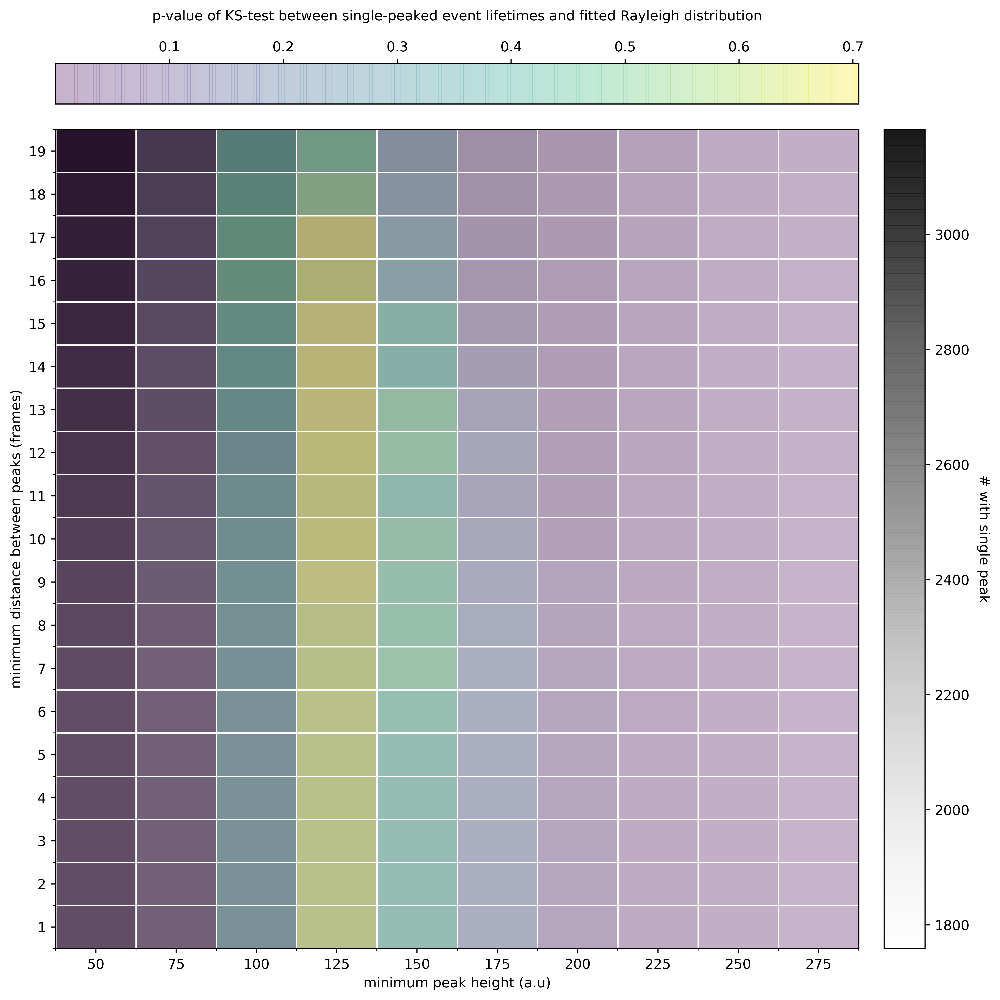

In [53]:
Image(filename=unique_user_saved_outputs+'/plots/distance_height_width_distheight_projection_hotspot_parameter_sweep.png', height=500, width=500)

In [54]:
%%capture

plt.style.use('default')

plt.rcParams['figure.dpi']=500
fig, axs = plt.subplots(1,1, constrained_layout=True, figsize=(10,10))

sc = axs.imshow(num_single_peaked_with_width[:,ind_best_fit[1],:], 
                alpha=0.9, 
                origin='lower', 
                interpolation='none', 
                cmap='Greys', 
                aspect='auto')
cba = fig.colorbar(sc,shrink=1, location='right')
cba.set_label('# with single peak', rotation=270, labelpad=15)


plt.ylabel('minimum distance between peaks (frames)')
plt.xlabel('minimum peak widths (frames)')


# Major ticks
axs.set_xticks(np.arange(0,len(widths_3),1))
axs.set_yticks(np.arange(0,len(distances_3),1))

# Labels for major ticks
axs.set_xticklabels(np.arange(widths_3[0], widths_3[-1]+1, 1))
axs.set_yticklabels(np.arange(distances_3[0], distances_3[-1]+1, 1))

# Minor ticks
axs.set_xticks(np.arange(-.5, len(widths_3), 1), minor=True)
axs.set_yticks(np.arange(-.5, len(distances_3), 1), minor=True)

# Gridlines based on minor ticks
axs.grid(which='minor', color='w', linestyle='-', linewidth=1)

plt.savefig(unique_user_saved_outputs+'/plots/distance_height_width_distwidth_projection_hotspot_parameter_sweep_numccps.png')

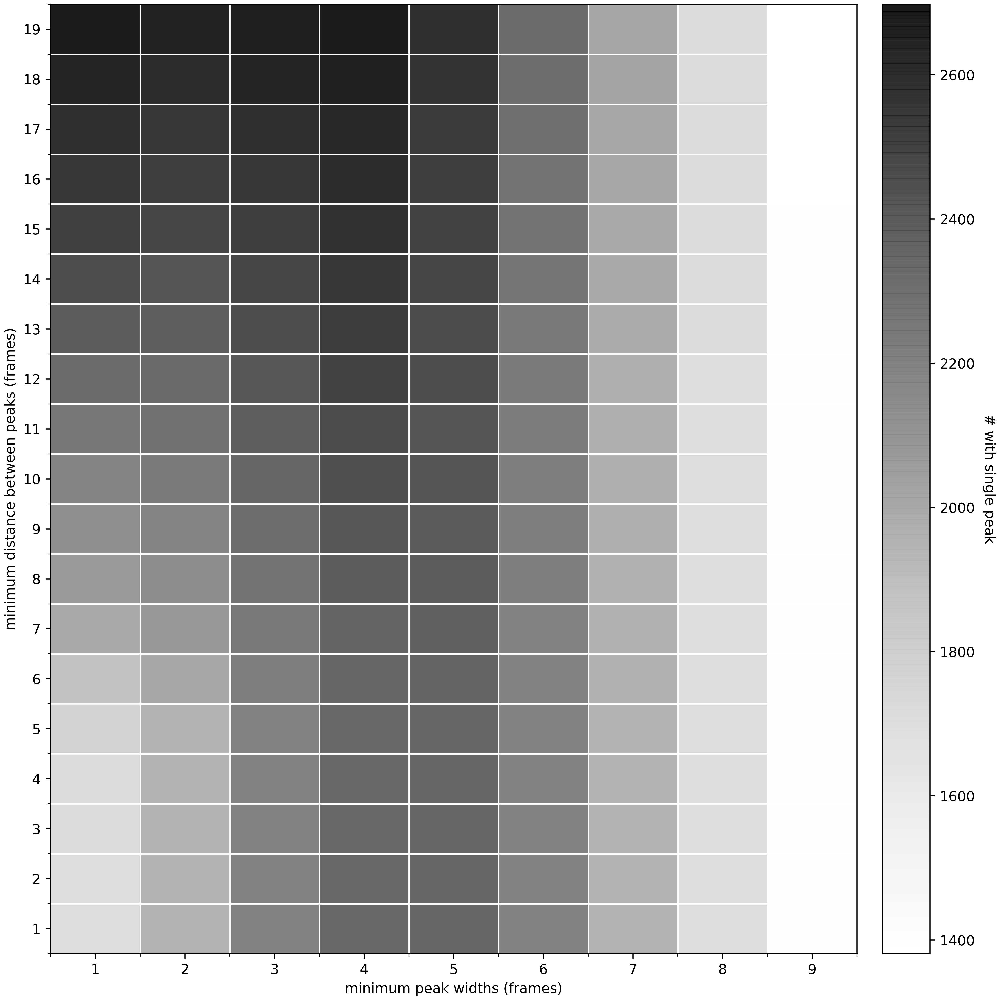

In [55]:
Image(filename=unique_user_saved_outputs+'/plots/distance_height_width_distwidth_projection_hotspot_parameter_sweep_numccps.png', height=500, width=500)

In [56]:
%%capture

plt.style.use('default')

plt.rcParams['figure.dpi']=500
fig, axs = plt.subplots(1,1, constrained_layout=True, figsize=(10,10))

sc1 = axs.imshow(significance_position_with_width[:,ind_best_fit[1],:], 
                 alpha=0.3, 
                 origin='lower', 
                 interpolation='none', 
                 cmap='viridis', 
                 aspect='auto')
cba1 = plt.colorbar(sc1,shrink=1, location='top')
cba1.set_label('p-value of KS-test between single-peaked event lifetimes and fitted Rayleigh distribution', 
               rotation=0, 
               labelpad=15)

plt.ylabel('minimum distance between peaks (frames)')
plt.xlabel('minimum peak widths (frames)')


# Major ticks
axs.set_xticks(np.arange(0,len(widths_3),1))
axs.set_yticks(np.arange(0,len(distances_3),1))

# Labels for major ticks
axs.set_xticklabels(np.arange(widths_3[0], widths_3[-1]+1, 1))
axs.set_yticklabels(np.arange(distances_3[0], distances_3[-1]+1, 1))

# Minor ticks
axs.set_xticks(np.arange(-.5, len(widths_3), 1), minor=True)
axs.set_yticks(np.arange(-.5, len(distances_3), 1), minor=True)

# Gridlines based on minor ticks
axs.grid(which='minor', color='w', linestyle='-', linewidth=1)

plt.savefig(unique_user_saved_outputs+'/plots/distance_height_width_distwidth_projection_hotspot_parameter_sweep_peakwidth.png')

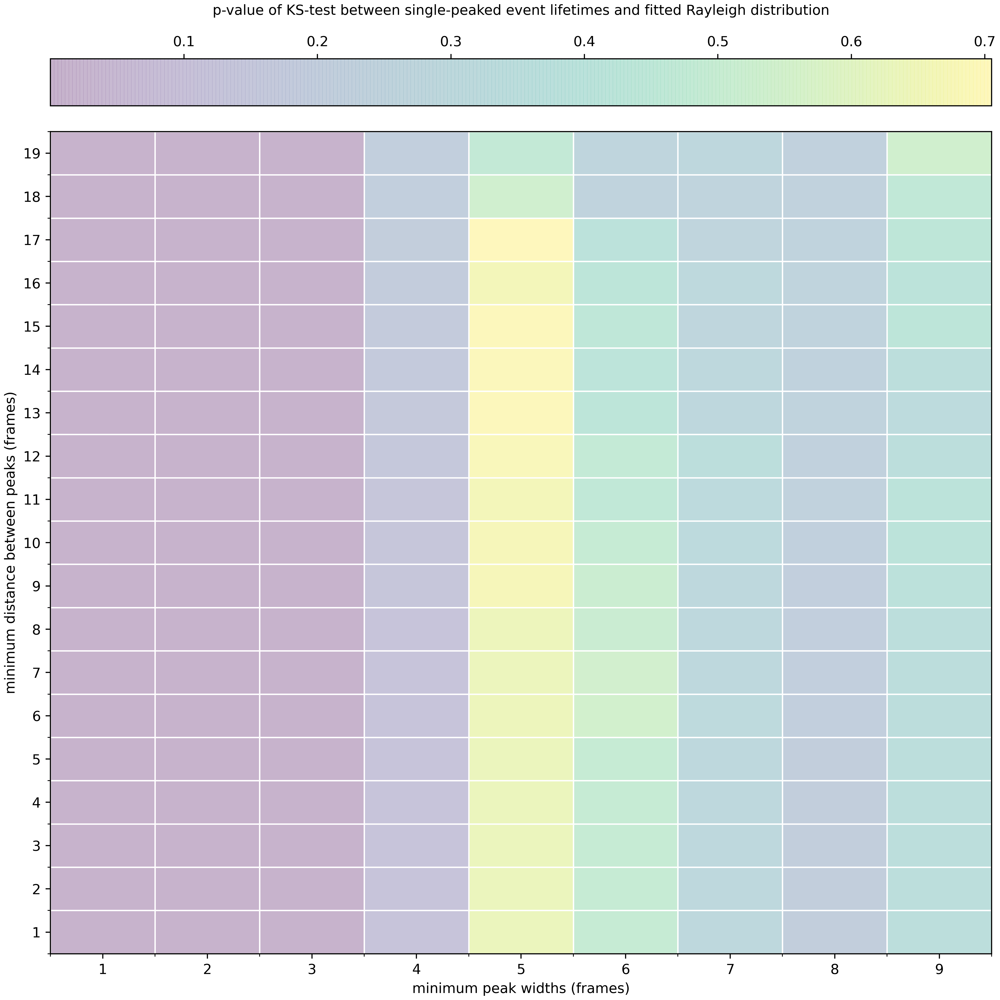

In [57]:
Image(filename=unique_user_saved_outputs+'/plots/distance_height_width_distwidth_projection_hotspot_parameter_sweep_peakwidth.png', height=500, width=500)

In [58]:
%%capture

plt.style.use('default')

plt.rcParams['figure.dpi']=500
fig, axs = plt.subplots(1,1, constrained_layout=True, figsize=(10,10))

sc1 = axs.imshow(chi_squared_gof_pval[:,ind_best_fit[1],:], 
                 alpha=0.3, 
                 origin='lower', 
                 interpolation='none', 
                 cmap='viridis', 
                 aspect='auto')
cba1 = plt.colorbar(sc1,shrink=1, location='top')
cba1.set_label('p-value of chi-squared between single-peaked event lifetimes and fitted Rayleigh distribution', 
               rotation=0, 
               labelpad=15)

plt.ylabel('minimum distance between peaks (frames)')
plt.xlabel('minimum peak widths (frames)')


# Major ticks
axs.set_xticks(np.arange(0,len(widths_3),1))
axs.set_yticks(np.arange(0,len(distances_3),1))

# Labels for major ticks
axs.set_xticklabels(np.arange(widths_3[0], widths_3[-1]+1, 1))
axs.set_yticklabels(np.arange(distances_3[0], distances_3[-1]+1, 1))

# Minor ticks
axs.set_xticks(np.arange(-.5, len(widths_3), 1), minor=True)
axs.set_yticks(np.arange(-.5, len(distances_3), 1), minor=True)

# Gridlines based on minor ticks
axs.grid(which='minor', color='w', linestyle='-', linewidth=1)

plt.savefig(unique_user_saved_outputs+'/plots/distance_height_width_distwidth_projection_hotspot_parameter_sweep_widthdist_cspval.png')

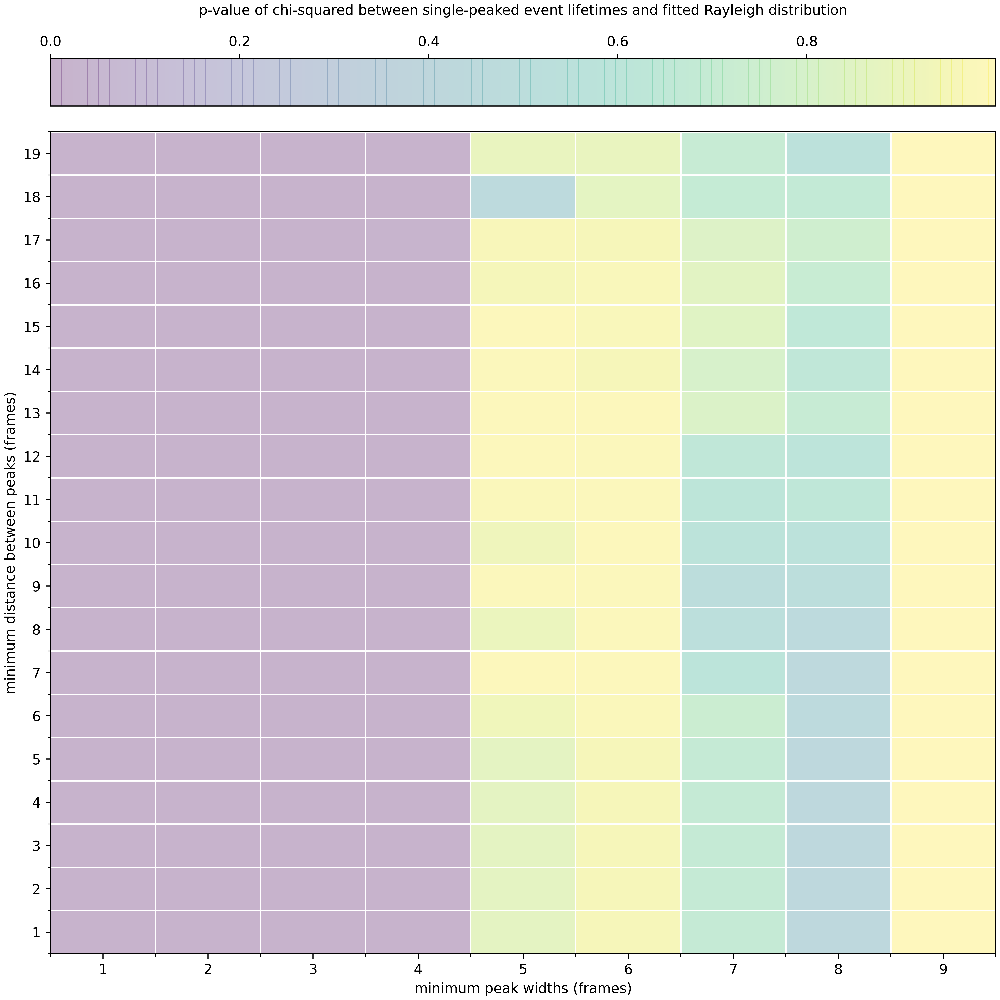

In [59]:
Image(filename=unique_user_saved_outputs+'/plots/distance_height_width_distwidth_projection_hotspot_parameter_sweep_widthdist_cspval.png', height=500, width=500)

In [60]:
%%capture

plt.style.use('default')

plt.rcParams['figure.dpi']=500
fig, axs = plt.subplots(1,1, constrained_layout=True, figsize=(10,10))

sc1 = axs.imshow(sse_param_sweep[:,ind_best_fit[1],:], 
                 alpha=0.3, 
                 origin='lower', 
                 interpolation='none', 
                 cmap='viridis', 
                 aspect='auto')
cba1 = plt.colorbar(sc1,shrink=1, location='top')
cba1.set_label('SSE between single-peaked event lifetimes and fitted Rayleigh distribution', 
               rotation=0, 
               labelpad=15)

plt.ylabel('minimum distance between peaks (frames)')
plt.xlabel('minimum peak widths (frames)')


# Major ticks
axs.set_xticks(np.arange(0,len(widths_3),1))
axs.set_yticks(np.arange(0,len(distances_3),1))

# Labels for major ticks
axs.set_xticklabels(np.arange(widths_3[0], widths_3[-1]+1, 1))
axs.set_yticklabels(np.arange(distances_3[0], distances_3[-1]+1, 1))

# Minor ticks
axs.set_xticks(np.arange(-.5, len(widths_3), 1), minor=True)
axs.set_yticks(np.arange(-.5, len(distances_3), 1), minor=True)

# Gridlines based on minor ticks
axs.grid(which='minor', color='w', linestyle='-', linewidth=1)

plt.savefig(unique_user_saved_outputs+'/plots/distance_height_width_distwidth_projection_hotspot_parameter_sweep_widthdist_sse.png')

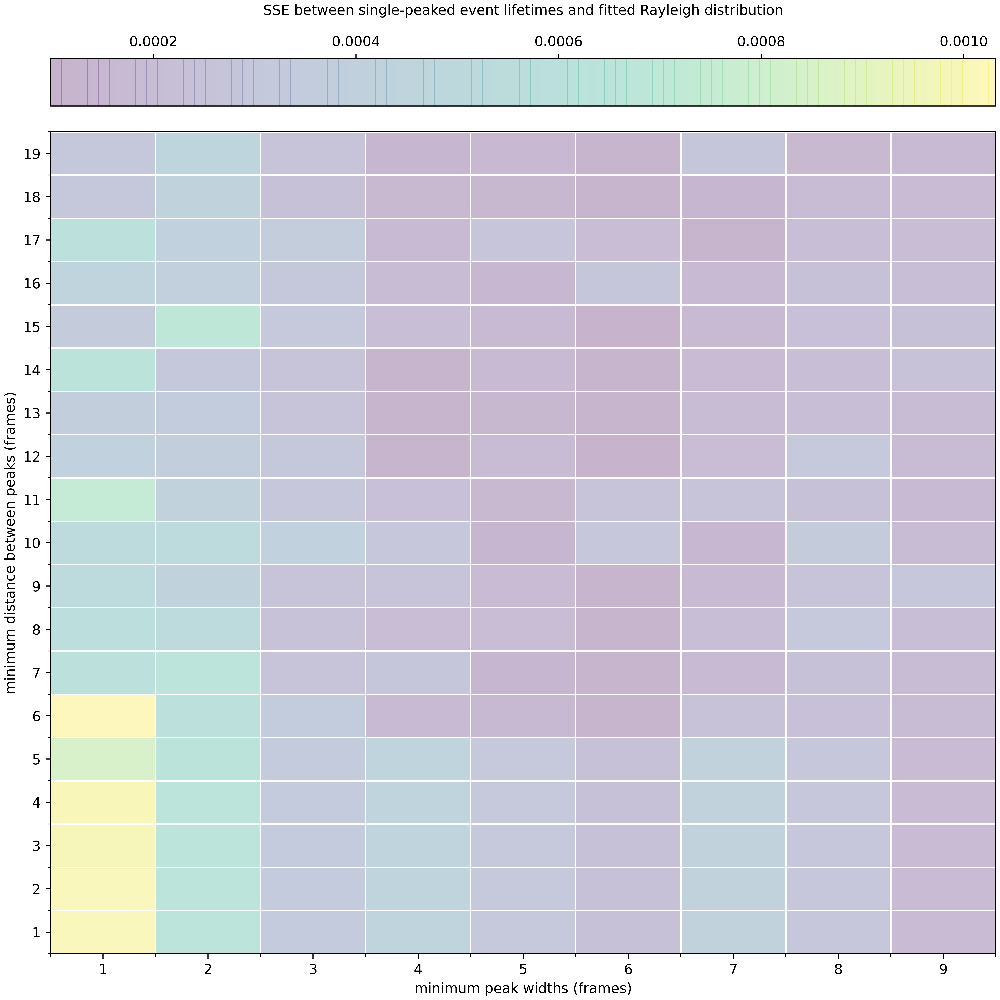

In [61]:
Image(filename=unique_user_saved_outputs+'/plots/distance_height_width_distwidth_projection_hotspot_parameter_sweep_widthdist_sse.png', height=500, width=500)

In [62]:
%%capture

plt.style.use('default')

plt.rcParams['figure.dpi']=500
fig, axs = plt.subplots(1,1, constrained_layout=True, figsize=(10,10))

sc = axs.imshow(num_single_peaked_with_width[:,ind_best_fit[1],:], 
                alpha=0.9, 
                origin='lower', 
                interpolation='none', 
                cmap='Greys', 
                aspect='auto')
cba = fig.colorbar(sc,shrink=1, location='right')
cba.set_label('# with single peak', rotation=270, labelpad=15)

sc1 = axs.imshow(significance_position_with_width[:,ind_best_fit[1],:], 
                 alpha=0.3, 
                 origin='lower', 
                 interpolation='none', 
                 cmap='viridis', 
                 aspect='auto')
cba1 = plt.colorbar(sc1,shrink=1, location='top')
cba1.set_label('p-value of KS-test between single-peaked event lifetimes and fitted Rayleigh distribution', 
               rotation=0, 
               labelpad=15)

plt.ylabel('minimum distance between peaks (frames)')
plt.xlabel('minimum peak widths (frames)')


# Major ticks
axs.set_xticks(np.arange(0,len(widths_3),1))
axs.set_yticks(np.arange(0,len(distances_3),1))

# Labels for major ticks
axs.set_xticklabels(np.arange(widths_3[0], widths_3[-1]+1, 1))
axs.set_yticklabels(np.arange(distances_3[0], distances_3[-1]+1, 1))

# Minor ticks
axs.set_xticks(np.arange(-.5, len(widths_3), 1), minor=True)
axs.set_yticks(np.arange(-.5, len(distances_3), 1), minor=True)

# Gridlines based on minor ticks
axs.grid(which='minor', color='w', linestyle='-', linewidth=1)




plt.savefig(unique_user_saved_outputs+'/plots/distance_height_width_distwidth_projection_hotspot_parameter_sweep_widthdist_ks.png', bbox_inches='tight')

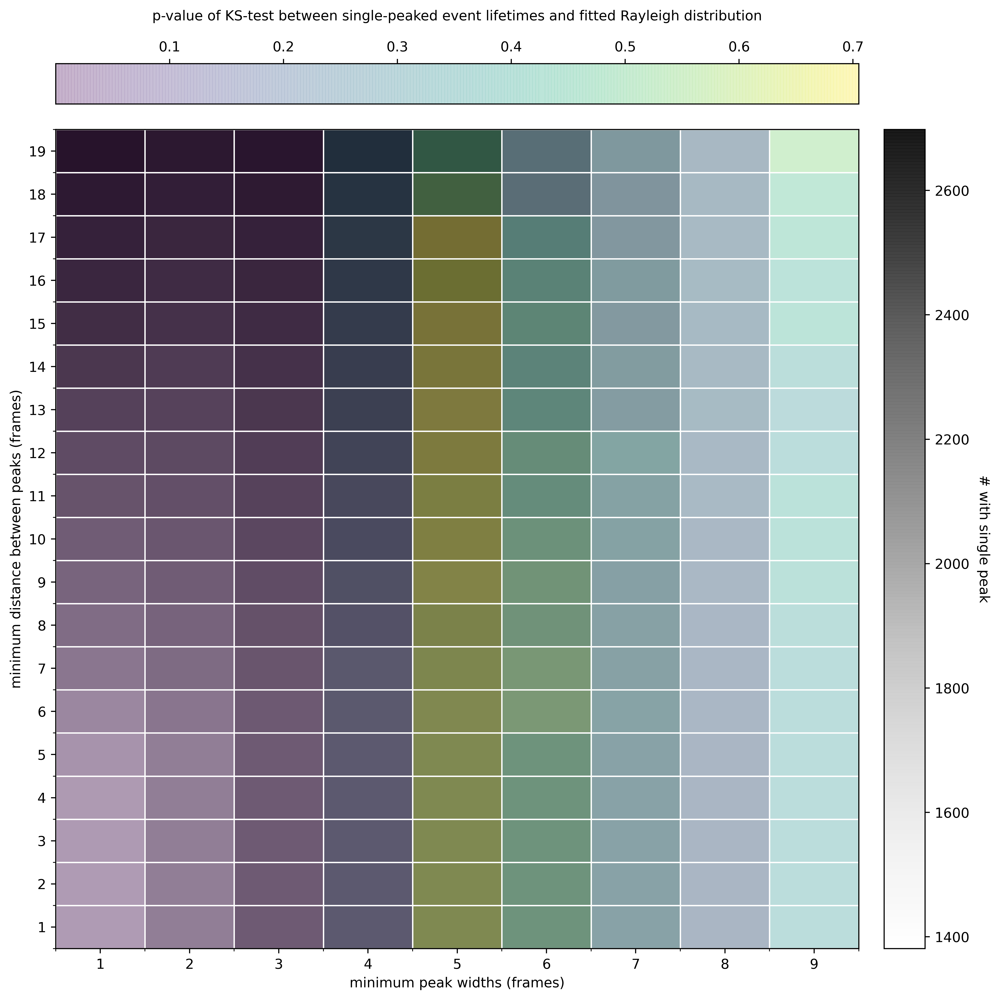

In [63]:
display(Image(filename=unique_user_saved_outputs+'/plots/distance_height_width_distwidth_projection_hotspot_parameter_sweep_widthdist_ks.png', height=500, width=500))

# lifetime distribution of CCPs

In [64]:
%%capture

plt.style.use('default')
plt.figure(figsize=(8,8),dpi=500)

plt.hist(lifetimes_ccp, density=1, label='raw lifetimes', bins='auto')

plt.plot(x_ccp,pdf_fitted_ccp, label='fitted lifetimes')


plt.xlabel('lifetime (s)', fontsize=20)
plt.ylabel('frequency density', fontsize=20)
plt.legend()
plt.title('lifetimes of all CCP events\np-value of Kolmogorov-Smirnov test: ' + str(ks_pvals_ccp) + 
          '\np-value of Chi-squared test: ' + str(chi_sq_pval)+
          '\nSSE: ' + str(sse), fontsize=10)
plt.savefig(unique_user_saved_outputs+'/plots/ccp_events_fit_rayleigh.png', bbox_inches='tight')

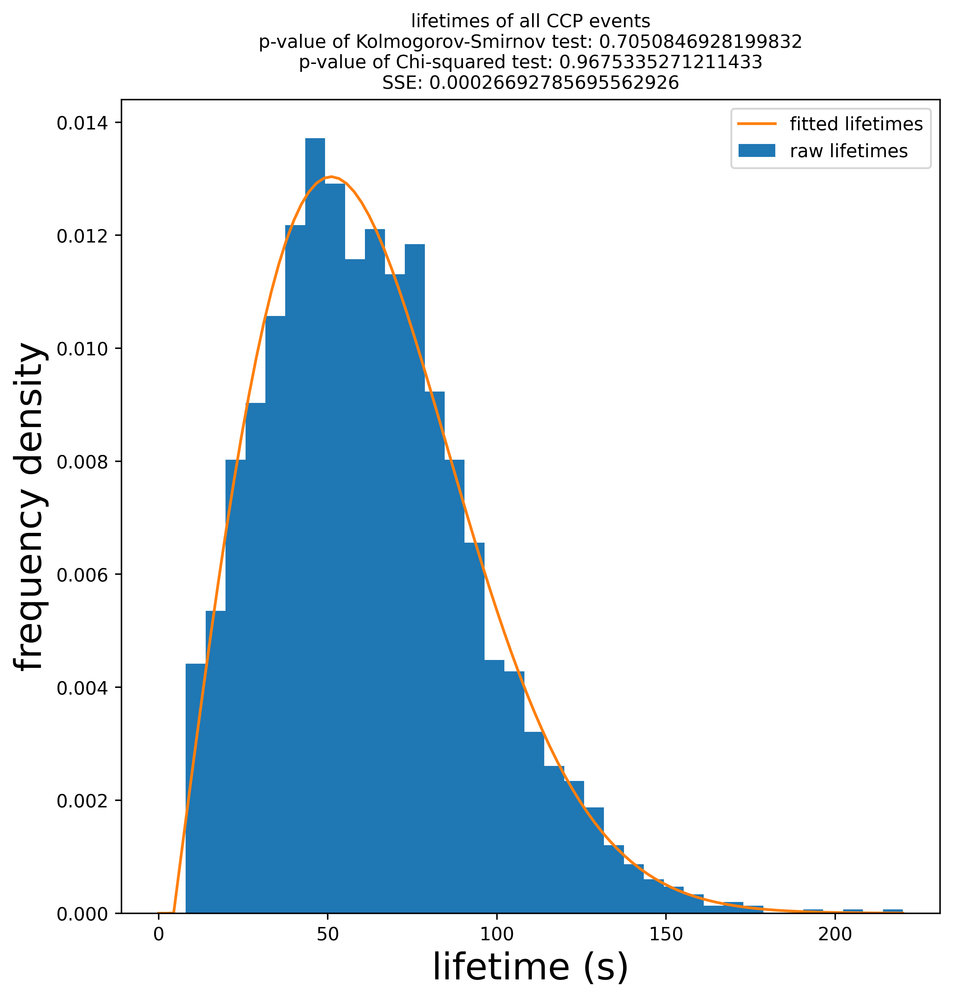

In [65]:
Image(filename=unique_user_saved_outputs+'/plots/ccp_events_fit_rayleigh.png', height=500, width=500)

# lifetime distribution of non-peaked and multi-peaked events

In [66]:
%%capture

plt.style.use('default')

lifetimes_hotspot = []
for i in range(len(tracks_false)):

    lifetimes_hotspot.append(return_track_attributes.return_track_lifetime(tracks_false,i))

ray_hotspot = stats.rayleigh
param_hotspot = ray.fit(lifetimes_hotspot)

ks_pvals_hotspot = stats.kstest(lifetimes_hotspot,stats.rayleigh(*param_hotspot).cdf)[1]

x_hotspot = np.linspace(0, np.max(lifetimes_hotspot), 100)
pdf_fitted_hotspot = ray.pdf(x_hotspot, loc=param_hotspot[0], scale=param_hotspot[1])

plt.figure(figsize=(8,8),dpi=500)

plt.hist(lifetimes_hotspot, density=1, label='raw lifetimes', bins='auto')

plt.plot(x_hotspot,pdf_fitted_hotspot, label='fitted lifetimes')


plt.xlabel('lifetime (s)', fontsize=20)
plt.ylabel('frequency density', fontsize=20)
plt.title('lifetimes of all hotspot and non-peaked events\np-value of Kolmogorov-Smirnov test: ' + str(ks_pvals_hotspot))
plt.savefig(unique_user_saved_outputs+'/plots/hotspot_events_fit_rayleigh.png', bbox_inches='tight')

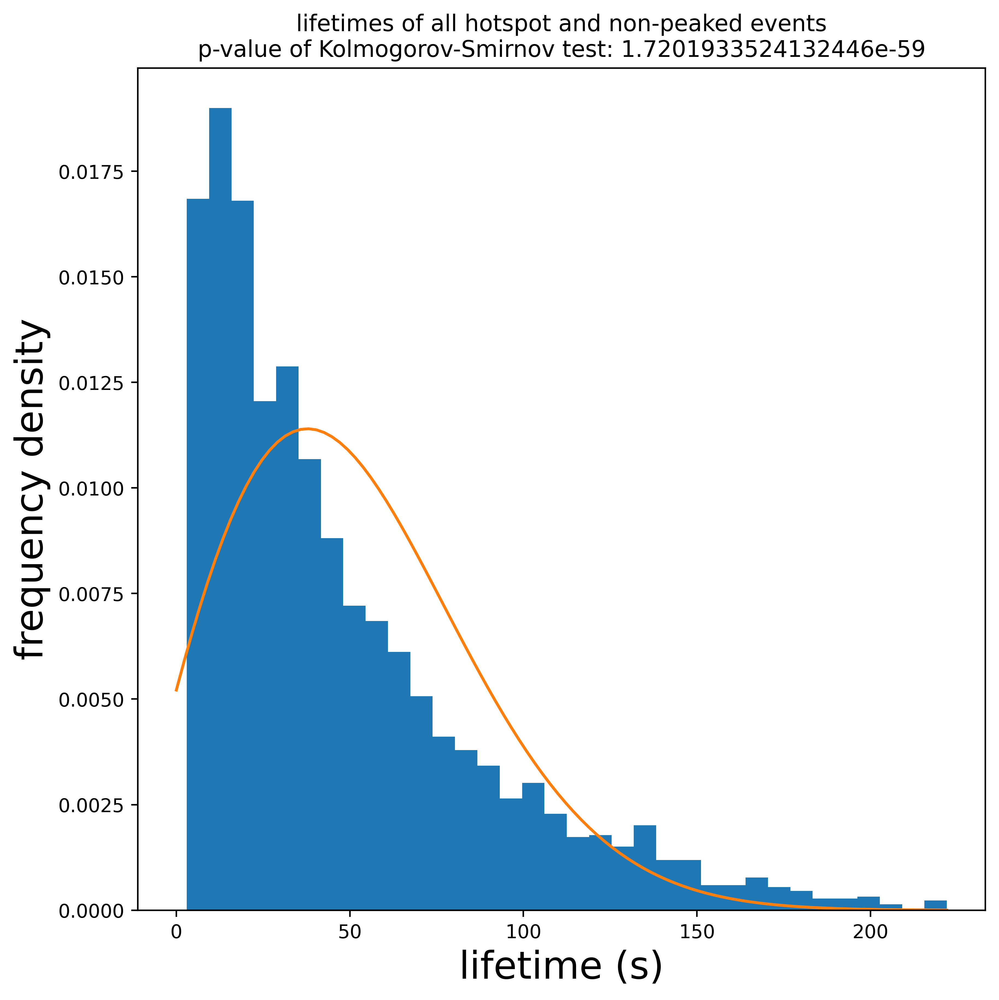

In [67]:
Image(filename=unique_user_saved_outputs+'/plots/hotspot_events_fit_rayleigh.png', height=500, width=500)

# plot an example CCP and example hot-spot

In [68]:
%%capture
fig, axes = plt.subplots(2, 1, dpi=500, figsize=(3,5))

for i in [18]:

    raw_intensity_ap2 = np.array(return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_true,i,0))
    raw_intensity_dnm2 = np.array(return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_true,i,1))
    
    axes[0].plot(raw_intensity_ap2, label='AP2', color='m')
    axes[0].plot(raw_intensity_dnm2, label='DNM2', color='g')
    
    axes[0].set_xlabel('time (s)')
    axes[0].set_ylabel('a.u. fluorescence')
    axes[0].set_xlim([0,210])
    axes[0].set_ylim([0, 1000])
    axes[0].legend(loc='upper right')
    axes[0].set_title('CCP')
    
for i in [2]:

    raw_intensity_ap2 = np.array(return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_false,i,0))
    raw_intensity_dnm2 = np.array(return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_false,i,1))

    axes[1].plot(raw_intensity_ap2, label='AP2', color='m')
    axes[1].plot(raw_intensity_dnm2, label='DNM2', color='g')

    
    axes[1].set_xlabel('time (s)')
    axes[1].set_ylabel('a.u. fluorescence')
    axes[1].set_xlim([0,210])
    axes[1].set_ylim([0, 1000])
    axes[1].set_title('hot-spot')
    
plt.tight_layout()
plt.savefig(unique_user_saved_outputs+'/plots/example_ccp_hotspot_subplot.png', bbox_inches='tight')

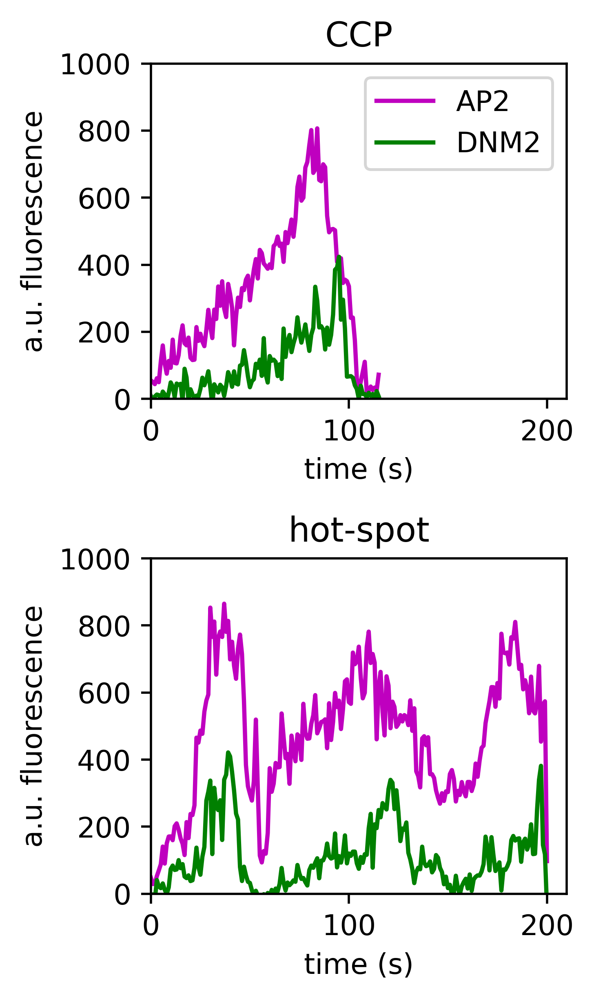

In [69]:
Image(filename=unique_user_saved_outputs+'/plots/example_ccp_hotspot_subplot.png', height=500, width=500)

# examples of CCPs

In [70]:
%%capture

plt.style.use('default')
plt.figure(dpi=500)
subplot_index = 1

num_plot = 25
number_of_columns = 5
number_of_channels = 2
tracks = tracks_true


track_indices = list(range(len(tracks)))
num_rows = int(np.ceil(num_plot/number_of_columns))

f = plt.figure(figsize=(3*number_of_columns+5,3*num_rows+5),dpi=100)

tracks_to_plot = tracks

random_indices = list(range(len(tracks_to_plot)))
random.shuffle(random_indices)
track_indices = random_indices[:num_plot]

tracks_to_plot = display_tracks.select_tracks_by_indices(tracks_to_plot, track_indices)    

lifetimes = []

for i in range(len(tracks_to_plot)):

    lifetimes.append(return_track_attributes.return_track_lifetime(tracks_to_plot,i))

sorted_lifetime_indices = sorted(range(len(lifetimes)), key=lambda k: lifetimes[k], reverse=True)

tracks_to_plot_list = [tracks_to_plot[i] for i in sorted_lifetime_indices][:num_plot]




for i in range(len(tracks_to_plot_list)):

    ax = f.add_subplot(num_rows,number_of_columns,subplot_index)

    raw_intensity_ap2 = np.array(return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_to_plot_list,i,0))
    raw_intensity = np.array(return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_to_plot_list,i,1))

    plt.plot(raw_intensity, label='raw DNM2 intensity')
    plt.plot(raw_intensity_ap2, label='raw AP2')
    sos = signal.butter(4, 0.2, 'lp', fs=1, output='sos')
    filtered_intensity = np.array(list(list(signal.sosfilt(sos, raw_intensity)) +  [0, 0, 0, 0, 0]))

    plt.plot(filtered_intensity, label='filtered DNM2 intensity')
    plt.xlabel('time (s)')
    plt.ylabel('a.u. fluorescence')
    plt.legend(loc='upper left')
    peaks = signal.find_peaks(filtered_intensity, distance=distance_best_fit, height=height_best_fit, width=width_best_fit)[0]
    plt.plot(peaks,filtered_intensity[peaks], 'x', markersize=10)
    subplot_index+=1

plt.tight_layout()

plt.savefig(unique_user_saved_outputs+'/plots/sample_ccps_kept.png', bbox_inches='tight')

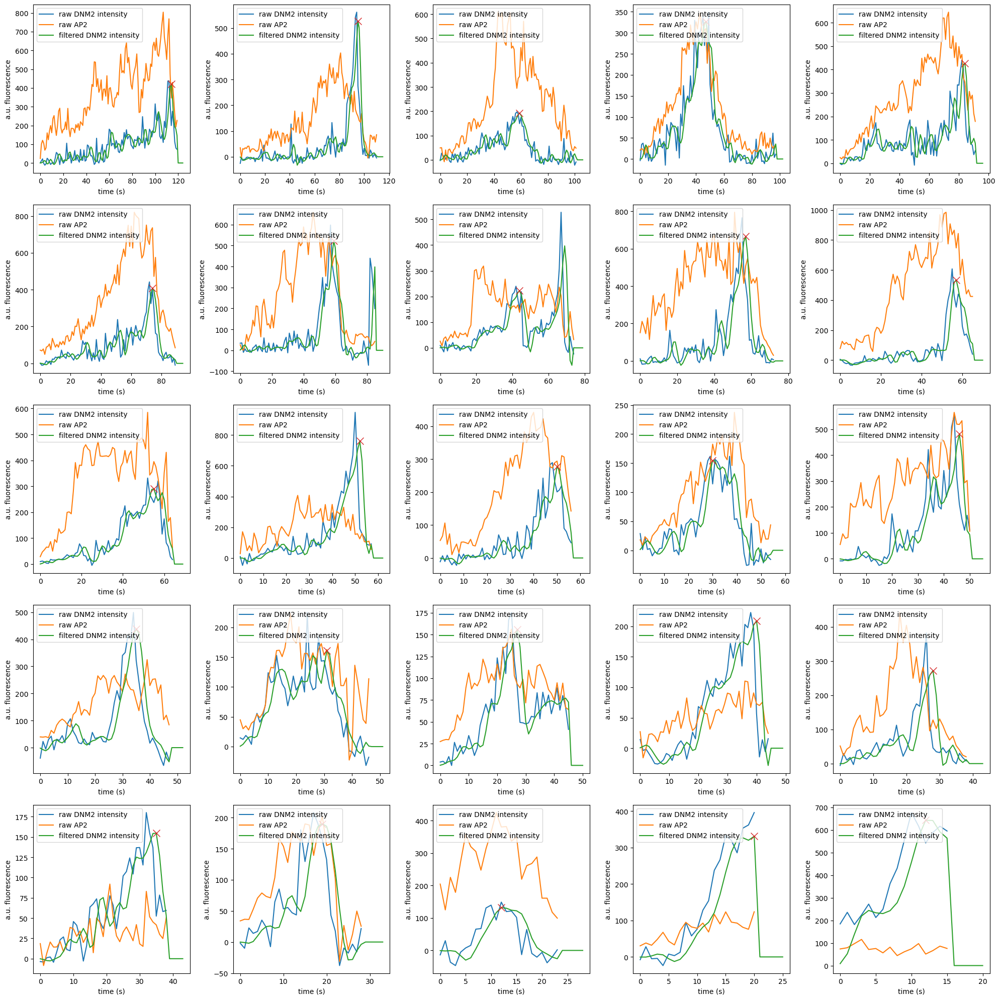

In [71]:
Image(filename=unique_user_saved_outputs+'/plots/sample_ccps_kept.png', height=500, width=500)

# examples of hot-spots and non-peaked events

In [72]:
%%capture

plt.figure(dpi=500)
subplot_index = 1

num_plot = 25
number_of_columns = 5
number_of_channels = 2
tracks = tracks_false


track_indices = list(range(len(tracks)))
num_rows = int(np.ceil(num_plot/number_of_columns))

f = plt.figure(figsize=(3*number_of_columns+5,3*num_rows+5),dpi=100)

tracks_to_plot = tracks

random_indices = list(range(len(tracks_to_plot)))
random.shuffle(random_indices)
track_indices = random_indices[:num_plot]

tracks_to_plot = display_tracks.select_tracks_by_indices(tracks_to_plot, track_indices)    

lifetimes = []

for i in range(len(tracks_to_plot)):

    lifetimes.append(return_track_attributes.return_track_lifetime(tracks_to_plot,i))

sorted_lifetime_indices = sorted(range(len(lifetimes)), key=lambda k: lifetimes[k], reverse=True)

tracks_to_plot_list = [tracks_to_plot[i] for i in sorted_lifetime_indices][:num_plot]




for i in range(len(tracks_to_plot_list)):

    ax = f.add_subplot(num_rows,number_of_columns,subplot_index)

    raw_intensity = np.array(return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_to_plot_list,i,1))
    raw_intensity_ap2 = np.array(return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_to_plot_list,i,0))
    plt.plot(raw_intensity, label='raw DNM2 intensity')
    plt.plot(raw_intensity_ap2, label='raw AP2 intensity')
    sos = signal.butter(4, 0.2, 'lp', fs=1, output='sos')
    filtered_intensity = np.array(list(list(signal.sosfilt(sos, raw_intensity)) +  [0, 0, 0, 0, 0]))

    plt.plot(filtered_intensity, label='filtered DNM2 intensity')
    plt.xlabel('time (s)')
    plt.ylabel('a.u. fluorescence')
    plt.legend(loc='upper left')
    peaks = signal.find_peaks(filtered_intensity, distance=distance_best_fit, height=height_best_fit, width=width_best_fit)[0]
    plt.plot(peaks,filtered_intensity[peaks], 'x', markersize=10)

    subplot_index+=1

plt.tight_layout()    

plt.savefig(unique_user_saved_outputs+'/plots/sample_hotspots_and_nonpeaked_events_discarded.png', bbox_inches='tight')

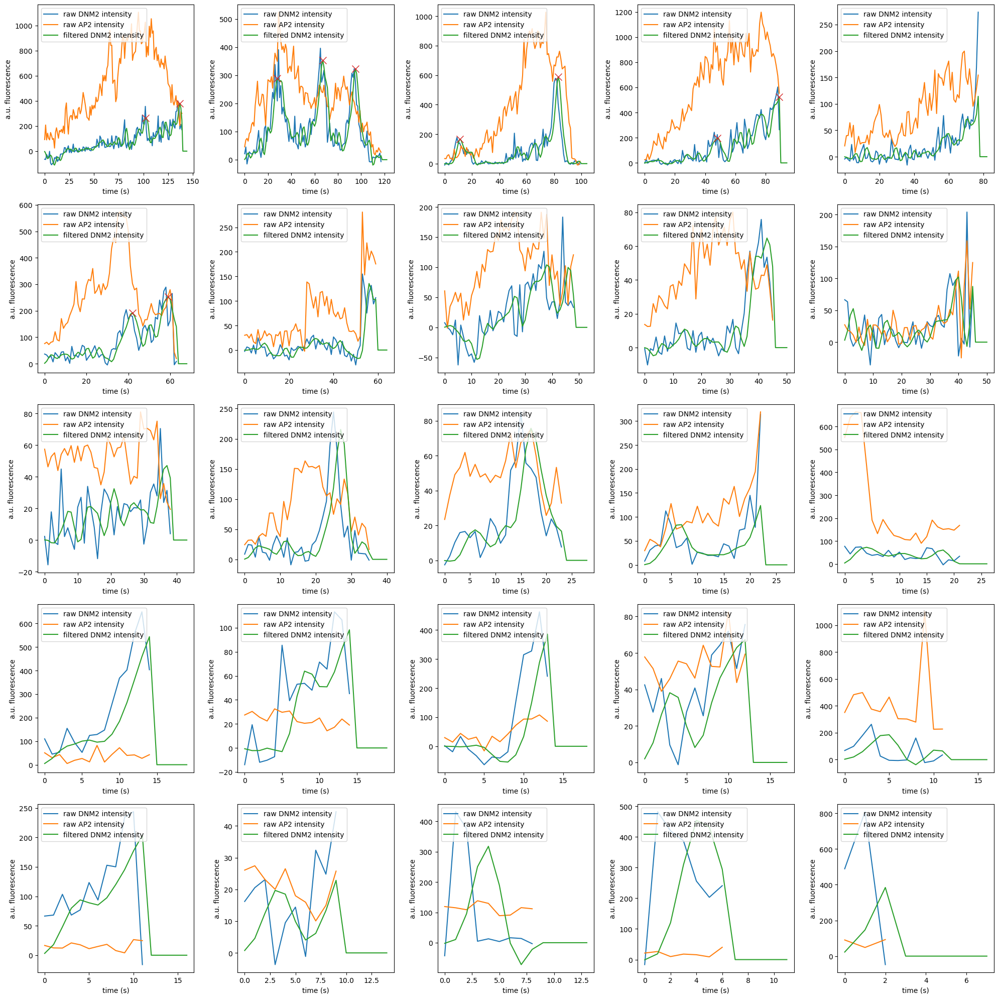

In [73]:
Image(filename=unique_user_saved_outputs+'/plots/sample_hotspots_and_nonpeaked_events_discarded.png', height=500, width=500)

# upload hot-spot predictions and mixture model data

In [74]:
best_fit_peak_params = np.load(unique_user_saved_outputs+'/dataframes/parameters_best_fit_peak_finding.npy')
ccp_predictions = np.load(unique_user_saved_outputs+'/dataframes/indices_ccp_predictions_' + \
                              'min_dist_'+str(best_fit_peak_params[0])+'_min_height_'+str(best_fit_peak_params[1])+ \
                              '_min_width_'+str(best_fit_peak_params[2])+ '.npy')
gmm_prediction = np.load(unique_user_saved_outputs+"/dataframes/gmm_prediction_5_comp_2pcs_gs.npy")

reduced_data = np.load(unique_user_saved_outputs+"/dataframes/pcd_g_scaled_data.npy")

with open(unique_user_saved_outputs+'/dataframes/gmm', 'rb') as f:
    gmm = pickle.load(f)

In [75]:
cmeDNM2Predictions = df_merged_features['cmeAnalysis_dynamin2_prediction'].values

indices_dnm2_positive = []
indices_dnm2_negative = []

for i in range(len(cmeDNM2Predictions)):

    if cmeDNM2Predictions[i]==1:

        indices_dnm2_positive.append(i)

    else:

        indices_dnm2_negative.append(i)

# PC-0 and PC-1 of candidate authentic CCPs (DNM2 positive cluster)

In [76]:
dnm2_positive_event_indices = df_pcs_normal_scaled_with_gmm_cluster[df_pcs_normal_scaled_with_gmm_cluster['gmm_predictions']==0].index.values

pc0_dnm2_pos = df_pcs_normal_scaled_with_gmm_cluster['PC-0'][dnm2_positive_event_indices].values
pc1_dnm2_pos = df_pcs_normal_scaled_with_gmm_cluster['PC-1'][dnm2_positive_event_indices].values

pc0_ccp = pc0_dnm2_pos[np.where(ccp_predictions==1)[0]]
pc0_misc = pc0_dnm2_pos[np.where(ccp_predictions==0)[0]]

pc1_ccp = pc1_dnm2_pos[np.where(ccp_predictions==1)[0]]
pc1_misc = pc1_dnm2_pos[np.where(ccp_predictions==0)[0]]

In [77]:
fraction_ccp = np.around(len(pc0_ccp)/len(dnm2_positive_event_indices), 4)
fraction_misc = np.around(len(pc1_misc)/len(dnm2_positive_event_indices), 4)

In [78]:
fraction_ccp

0.4274

# plot the decision boundaries of 5-means clusters, cluster centroids, and log-scale counts of PC components

In [79]:
%%capture

plt.style.use('default')

plt.rcParams['figure.dpi']=500

fig, ax = plt.subplots(1,1, constrained_layout=True, figsize=(5,5))


plt.rcParams.update({'font.size': 8})


h=0.01 # https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_digits.html#sphx-glr-auto-examples-cluster-plot-kmeans-digits-py
# Plot the decision boundary. For that, we will assign a color to each
x_min, x_max = reduced_data[:, 0].min() - 10, reduced_data[:, 0].max() + 10
y_min, y_max = reduced_data[:, 1].min() - 10, reduced_data[:, 1].max() + 10
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Obtain labels for each point in mesh. Use last trained model.
Z = gmm.predict_proba(np.c_[xx.ravel(), yy.ravel()])
Z = np.max(Z, axis=1)

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.imshow(Z, interpolation='nearest',
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           cmap='viridis',
           aspect='auto', origin='lower', alpha=0.2)

cba = plt.colorbar(location='right')
cba.set_label(label='fit probability of data to nearest cluster', rotation=270, labelpad=15)

sc = ax.hist2d(reduced_data[:,0],
             reduced_data[:,1],
             bins=100,
             norm=mpl.colors.LogNorm(),
             alpha=1,
             density=True,
             cmap='jet')

cba = fig.colorbar(sc[3], ax=ax, location='bottom')
cba.set_label('event density', rotation=0)


gmm_classes = []

for i in range(len(set(gmm_prediction))):

    gmm_classes.append(np.where(gmm_prediction==i)[0])


percent_cmeAnalysis_dnm2_positive_in_cluster = []

for i,labels_list in enumerate(gmm_classes):

    num_intersecting_cmeAnalysisDNM2Pos_gmmCluster = len(set(labels_list).intersection(indices_dnm2_positive))

    percent_cmeAnalysis_dnm2_positive_in_cluster.append(100*num_intersecting_cmeAnalysisDNM2Pos_gmmCluster/len(indices_dnm2_positive))

#     print(np.sum(percent_cmeAnalysis_dnm2_positive_in_cluster))

centroids = gmm.means_
num_events_in_centroid = len(np.where(gmm_prediction==0)[0])

percentage_in_centroid_ccp = 100*np.around(num_events_in_centroid/len(gmm_prediction),4)

for i in range(len(centroids)):
    
    if i==index_DNM2positive:
        
        num_events_in_centroid = len(np.where(gmm_prediction==i)[0])

        percentage_in_centroid = 100*np.around(num_events_in_centroid/len(gmm_prediction),4)

        plt.text(centroids[i][0]+1, 
                 centroids[i][1]-0.75,
                 "cluster " + str(i) +
                 "\n{:.2f}".format(percent_cmeAnalysis_dnm2_positive_in_cluster[i])+'%' + '$\mathregular{^{**}}$' + 
                 "\n{:.2f}".format(percentage_in_centroid)+'%' + '$\mathregular{^{*}}$',
                 color='black',
                 bbox=dict(boxstyle="square",
                           facecolor='green',
                       ec=(0.5, 1, 0.5),
                       fc=(0.8, 1, 0.8),
                       ))
    else:
        
        num_events_in_centroid = len(np.where(gmm_prediction==i)[0])

        percentage_in_centroid = 100*np.around(num_events_in_centroid/len(gmm_prediction),4)

        plt.text(centroids[i][0]+1, 
                 centroids[i][1]-0.75,
                 "cluster " + str(i) +
                 "\n{:.2f}".format(percent_cmeAnalysis_dnm2_positive_in_cluster[i])+'%' + '$\mathregular{^{**}}$' + 
                 "\n{:.2f}".format(percentage_in_centroid)+'%' + '$\mathregular{^{*}}$',
                 color='black',
                 bbox=dict(boxstyle="square",
                           color='red',
                       ec=(1., 0.5, 0.5),
                       fc=(1., 0.8, 0.8),
                       ))



plt.text(-9.5, 13.5,
         'total number of valid tracks: ' + "{:,}".format(len(cmeDNM2Predictions)) + 
         '\n - DNM2 positive calculated by cmeAnalysis: ' + str(100*np.around(len(indices_dnm2_positive)/len(cmeDNM2Predictions),4))+'%' + 
         '\n - DNM2 positive calculated by feature clustering: ' + "{:.2f}".format(percentage_in_centroid_ccp)+'%' + 
         '\n - individual CCPs calculated by model fitting: ' + "{:.2f}".format(percentage_in_centroid_ccp*fraction_ccp)+'%' +
         '\nlegend: ' +
         '\n$\mathregular{^{*}}$' + ' percentage of all events in cluster' +
         '\n$\mathregular{^{**}}$' + ' percentage of cmeAnalysis DNM2 positive events in cluster',
         fontsize=5,
         horizontalalignment='left', 
         verticalalignment='top')
rect = patches.Rectangle((-10,9.6),
                         17,
                         8,
                         linewidth=1,
                         alpha=1, 
                         ec=(0.5, 0.5, 0.5),
                         fc=(0.8, 0.8, 0.8))
ax.add_patch(rect)


ax.set_title('principal components feature projections \noverlaid with cluster boundaries')        

plt.scatter(centroids[:, 0], centroids[:, 1],
            marker='x', s=169, linewidths=3,
            color='w', zorder=10)


plt.ylim([-8,14])
plt.xlim([-10,15])
plt.xticks([-5, 0, 5, 10], labels=[-5, 0, 5, 10])
plt.yticks([-5, 0, 5, 10], labels=[-5, 0, 5, 10])
ax.set_xlabel('PC-0')
ax.set_ylabel('PC-1')
plt.savefig(unique_user_saved_outputs+'/plots/PC_overlay_with_cluster_boundaries.png', bbox_inches='tight')

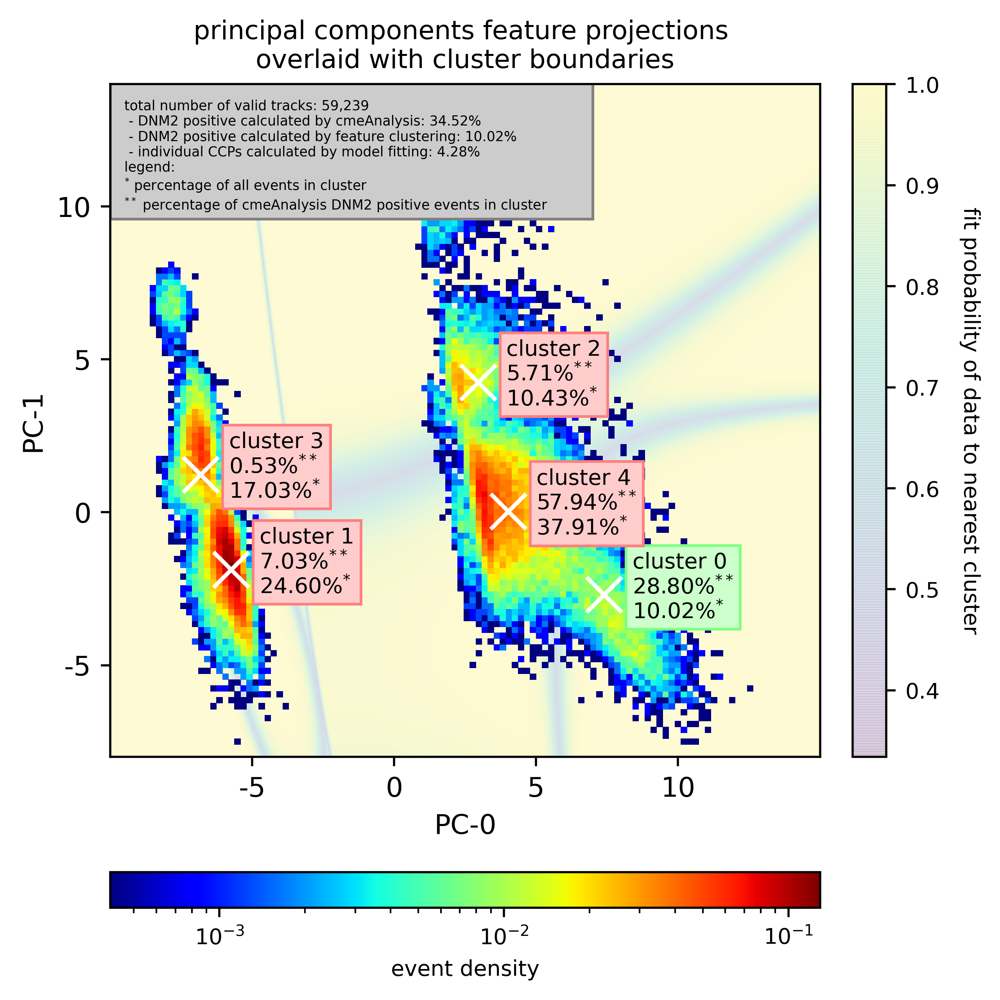

In [80]:
Image(filename=unique_user_saved_outputs+'/plots/PC_overlay_with_cluster_boundaries.png', height=500, width=500)

In [81]:
%%capture

plt.style.use('default')

plt.rcParams['figure.dpi']=500

fig, ax = plt.subplots(1,1, constrained_layout=True, figsize=(5,5))


plt.rcParams.update({'font.size': 8})


h=0.01 # https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_digits.html#sphx-glr-auto-examples-cluster-plot-kmeans-digits-py
# Plot the decision boundary. For that, we will assign a color to each
x_min, x_max = reduced_data[:, 0].min() - 10, reduced_data[:, 0].max() + 10
y_min, y_max = reduced_data[:, 1].min() - 10, reduced_data[:, 1].max() + 10
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Obtain labels for each point in mesh. Use last trained model.
Z = gmm.predict_proba(np.c_[xx.ravel(), yy.ravel()])
Z = np.max(Z, axis=1)

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.imshow(Z, interpolation='nearest',
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           cmap='viridis',
           aspect='auto', origin='lower', alpha=0.2)

cba = plt.colorbar(location='right')
cba.set_label(label='fit probability of data to nearest cluster', rotation=270, labelpad=15)

sc = ax.hist2d(reduced_data[:,0],
             reduced_data[:,1],
             bins=100,
             norm=mpl.colors.LogNorm(),
             alpha=1,
             density=True,
             cmap='jet')

cba = fig.colorbar(sc[3], ax=ax, location='bottom')
cba.set_label('event density', rotation=0)


gmm_classes = []

for i in range(len(set(gmm_prediction))):

    gmm_classes.append(np.where(gmm_prediction==i)[0])


percent_cmeAnalysis_dnm2_positive_in_cluster = []

for i,labels_list in enumerate(gmm_classes):

    num_intersecting_cmeAnalysisDNM2Pos_gmmCluster = len(set(labels_list).intersection(indices_dnm2_positive))

    percent_cmeAnalysis_dnm2_positive_in_cluster.append(100*num_intersecting_cmeAnalysisDNM2Pos_gmmCluster/len(indices_dnm2_positive))

#     print(np.sum(percent_cmeAnalysis_dnm2_positive_in_cluster))

centroids = gmm.means_
num_events_in_centroid = len(np.where(gmm_prediction==0)[0])

percentage_in_centroid_ccp = 100*np.around(num_events_in_centroid/len(gmm_prediction),4)

for i in range(len(centroids)):
    
    if i==index_DNM2positive:
        
        num_events_in_centroid = len(np.where(gmm_prediction==i)[0])

        percentage_in_centroid = 100*np.around(num_events_in_centroid/len(gmm_prediction),4)

        plt.text(centroids[i][0]+1, 
                 centroids[i][1]-0.75,
                 "cluster " + str(i),
                 color='black',
                 bbox=dict(boxstyle="square",
                           facecolor='green',
                       ec=(0.5, 1, 0.5),
                       fc=(0.8, 1, 0.8),
                       ))
    else:
        
        num_events_in_centroid = len(np.where(gmm_prediction==i)[0])

        percentage_in_centroid = 100*np.around(num_events_in_centroid/len(gmm_prediction),4)

        plt.text(centroids[i][0]+1, 
                 centroids[i][1]-0.75,
                 "cluster " + str(i),
                 color='black',
                 bbox=dict(boxstyle="square",
                           color='red',
                       ec=(1., 0.5, 0.5),
                       fc=(1., 0.8, 0.8),
                       ))




ax.set_title('principal components feature projections \noverlaid with cluster boundaries')        

plt.scatter(centroids[:, 0], centroids[:, 1],
            marker='x', s=169, linewidths=3,
            color='w', zorder=10)


plt.ylim([-11,12])
plt.xlim([-10,13])
plt.xticks([-5, 0, 5, 10], labels=[-5, 0, 5, 10])
plt.yticks([-10, -5, 0, 5, 10], labels=[-10, -5, 0, 5, 10])
ax.set_xlabel('PC-0')
ax.set_ylabel('PC-1')
plt.savefig(unique_user_saved_outputs+'/plots/PC_overlay_with_cluster_boundaries_paperversion.png', bbox_inches='tight')

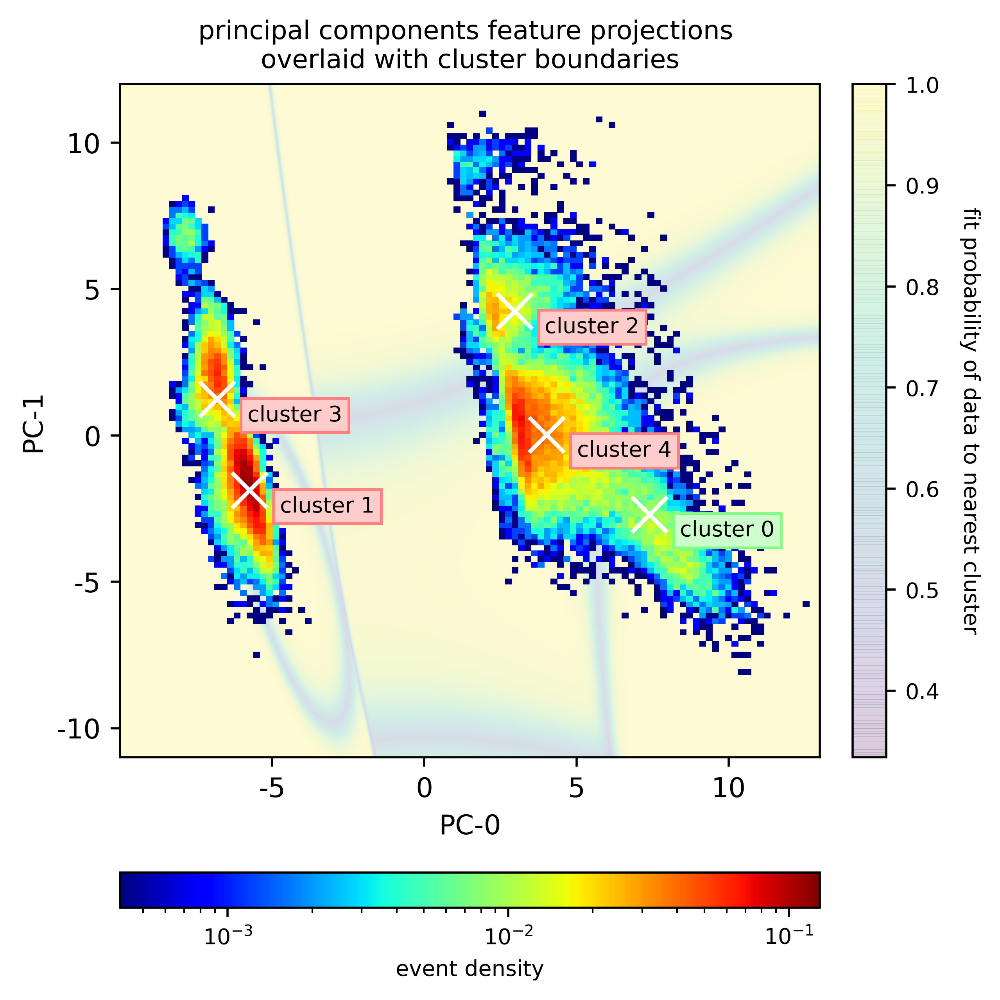

In [82]:
Image(filename=unique_user_saved_outputs+'/plots/PC_overlay_with_cluster_boundaries_paperversion.png', height=500, width=500)

# counting the fraction of events in all five of the clusters that have 1 or more DNM2 peak

In [83]:
fraction_one_peak = []
fraction_two_or_more_peaks = []

for j in range(number_of_clusters):
    
    
    num_one_peak = 0
    num_two_or_more_peaks = 0
    
    indices_cluster = np.where(gmm_prediction==j)[0]
    
    tracks_in_cluster = merged_all_valid_tracks[indices_cluster]
    
    filtered_amplitudes = [] # filtered DNM2 traces per track of interest

    for i in range(len(tracks_in_cluster)):

        raw_intensity = return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_in_cluster,i,1)

        # add zeros to end to account for phase shift of near-track-end peaks
        filtered_amplitudes.append(list(list(signal.sosfilt(sos, raw_intensity)) + [0, 0, 0, 0, 0])) 
        
    
    for i in range(len(filtered_amplitudes)): # iterate through all filtered amplitudes
        
        pvals_dnm2 = return_track_attributes.return_pvals_detection_no_buffer(tracks_in_cluster, i, 1)
        
        # measure whether there is 1 peak with the specified peak-finding parameters
        num_peaks = len(signal.find_peaks(filtered_amplitudes[i], 
                                          distance=distance_best_fit, 
                                          height=height_best_fit,
                                          width=width_best_fit)[0])
        
        if num_peaks==1:
            
            num_one_peak+=1
        
        elif num_peaks>1:
            
            num_two_or_more_peaks+=1
            
    fraction_one_peak.append(num_one_peak/len(filtered_amplitudes))
    fraction_two_or_more_peaks.append(num_two_or_more_peaks/len(filtered_amplitudes))
        



In [84]:
fraction_one_peak

[0.4274166385988548, 0.0, 0.0004853583562530335, 0.0, 0.00040074806305102857]

In [85]:
fraction_two_or_more_peaks

[0.1066015493432132, 0.0, 0.0, 0.0, 0.0]

In [86]:
num_peaks = [] # count the number of peaks
filtered_amplitudes = []

indices_cluster = np.where(gmm_prediction==index_DNM2positive)[0]

tracks_in_cluster = merged_all_valid_tracks[indices_cluster]

filtered_amplitudes = [] # filtered DNM2 traces per track of interest

for i in range(len(tracks_in_cluster)):

    raw_intensity = return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_in_cluster,i,1)

    # add zeros to end to account for phase shift of near-track-end peaks
    filtered_amplitudes.append(list(list(signal.sosfilt(sos, raw_intensity)) + [0, 0, 0, 0, 0])) 
        

for i in range(len(filtered_amplitudes)): # iterate through all filtered amplitudes

    # measure the number of peaks 
    num_peaks_temp = len(signal.find_peaks(filtered_amplitudes[i], 
                             distance=distance_best_fit, 
                             height=height_best_fit,
                             width=width_best_fit)[0])
    num_peaks.append(num_peaks_temp)

In [87]:
len(np.where(np.array(num_peaks)==0)[0])

2767

In [88]:
len(np.where(np.array(num_peaks)==0)[0])/len(num_peaks)

0.465981812057932

# number of peaks in DNM2+ events

In [89]:
%%capture
plt.figure(dpi=500)
plt.hist(num_peaks)
plt.xlabel('number of peaks in DNM2+ events')
plt.ylabel('counts')
plt.savefig(unique_user_saved_outputs+'/plots/num_peaks_best_ccpmodel.png', bbox_inches='tight')

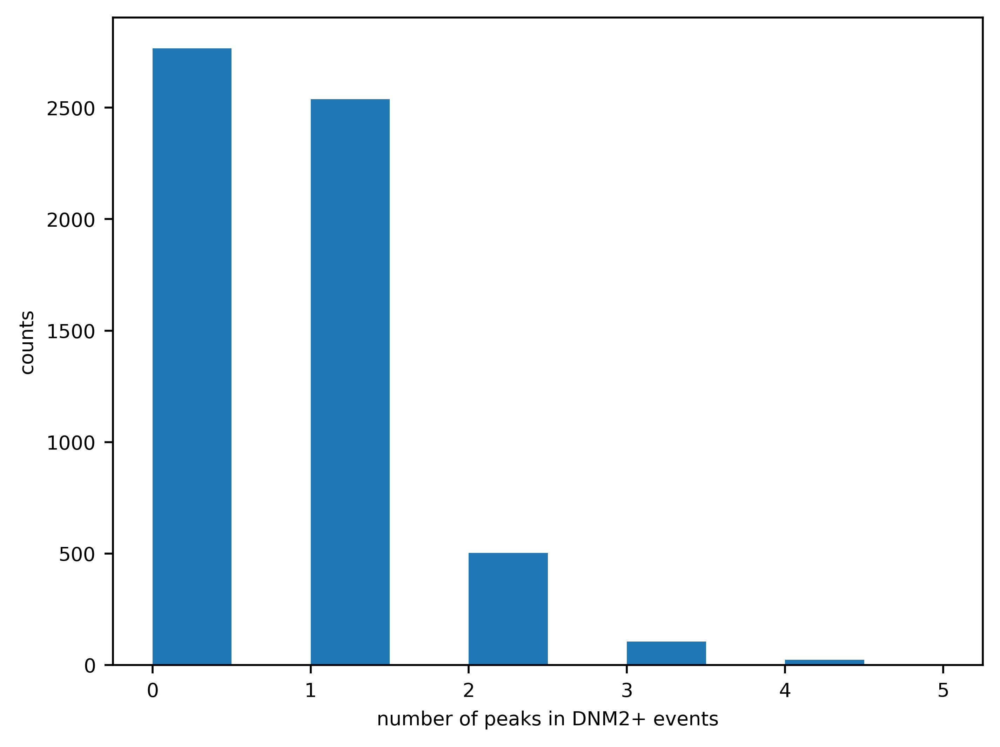

In [90]:
Image(filename=unique_user_saved_outputs+'/plots/num_peaks_best_ccpmodel.png', unconfined=True, height=700, width=700)

In [91]:
df = df_merged_features

dnm2_positive_event_indices = np.where(gmm_prediction==index_DNM2positive)[0]

In [92]:
len(dnm2_positive_event_indices)

5938

In [93]:
pc0_dnm2_positive = df_pcs_normal_scaled_with_gmm_cluster['PC-0'].values[dnm2_positive_event_indices]
pc1_dnm2_positive = df_pcs_normal_scaled_with_gmm_cluster['PC-1'].values[dnm2_positive_event_indices]

# the number of peaks overlaid on the events' principal component projections

In [94]:
%%capture
plt.figure(dpi=500)
plt.style.use('default')
sc = plt.scatter(pc0_dnm2_positive, pc1_dnm2_positive, c=num_peaks, alpha=0.3, cmap='Pastel1')
cb = plt.colorbar(sc)
cb.set_alpha(1)
cb.draw_all()
cb.set_label('number of peaks', rotation=270, labelpad=25)
plt.xlabel('PC-0')
plt.ylabel('PC-1')
plt.savefig(unique_user_saved_outputs+'/plots/num_peaks_overlaid_pcs.png', bbox_inches='tight')

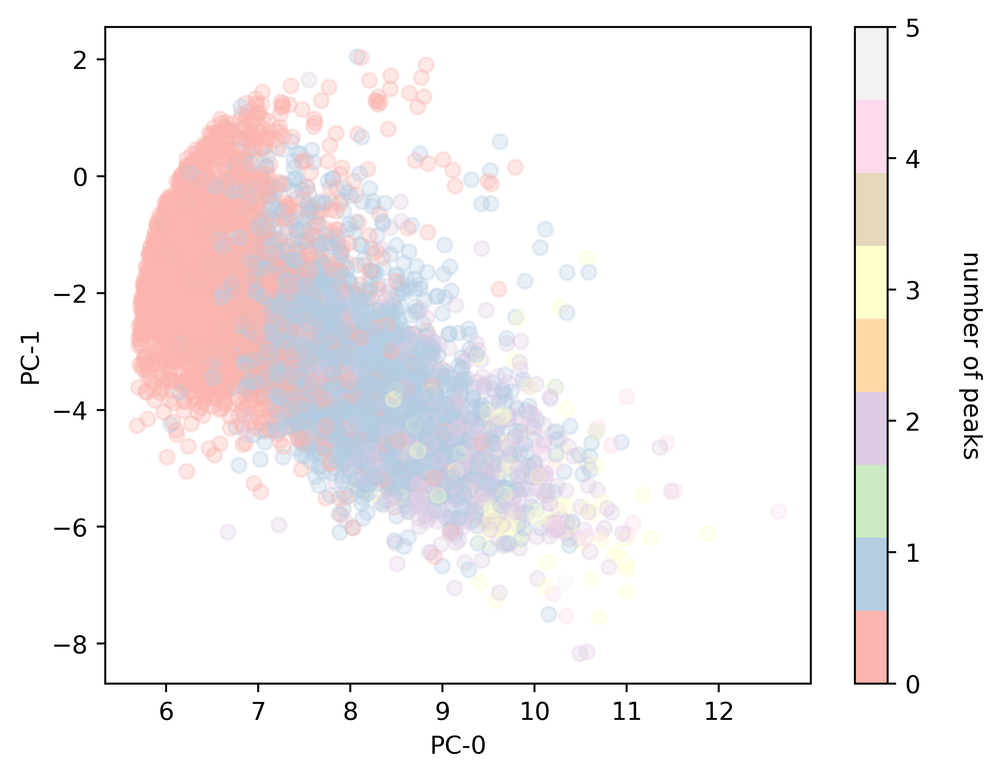

In [95]:
Image(filename=unique_user_saved_outputs+'/plots/num_peaks_overlaid_pcs.png', unconfined=True, height=700, width=700)

In [96]:
with open(unique_user_saved_outputs+'/dataframes/gmm_trained', 'rb') as f:
    gmm_model = pickle.load(f)                

(array([ 145.,  170.,  129.,  131.,  136.,  158.,  178.,  226.,  286.,
        4379.]),
 array([0.49970776, 0.54973699, 0.59976621, 0.64979543, 0.69982466,
        0.74985388, 0.7998831 , 0.84991233, 0.89994155, 0.94997078,
        1.        ]),
 <a list of 10 Patch objects>)

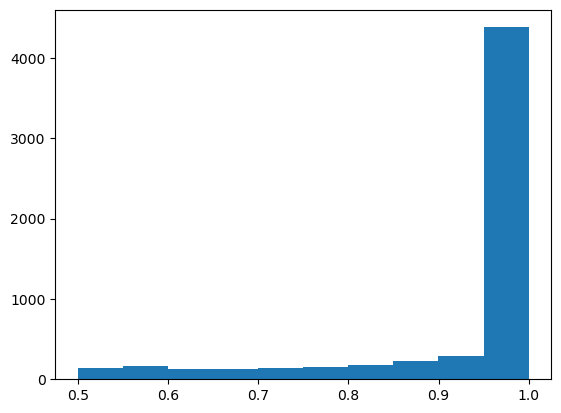

In [97]:
plt.hist(gmm_model.predict_proba(df_pcs_normal_scaled_with_gmm_cluster.values[:,:2])[:,index_DNM2positive][dnm2_positive_event_indices])

In [98]:
probs = gmm_model.predict_proba(df_pcs_normal_scaled_with_gmm_cluster.values[:,:2])[:,index_DNM2positive][dnm2_positive_event_indices]

# comparing principle component projections of events with the probability that events are DNM2+

In [99]:
%%capture
plt.figure(dpi=500)
sc = plt.scatter(pc0_dnm2_positive, pc1_dnm2_positive, c=probs)
plt.xlabel('PC-0')
plt.ylabel('PC-1')
cb = plt.colorbar(sc)
cb.set_alpha(1)
cb.draw_all()
cb.set_label('probability of event being in DNM2+', rotation=270, labelpad=20)
plt.tight_layout()
plt.savefig(unique_user_saved_outputs+'/plots/probs_dnm2plus_overlaidpcs.png', bbox_inches='tight')

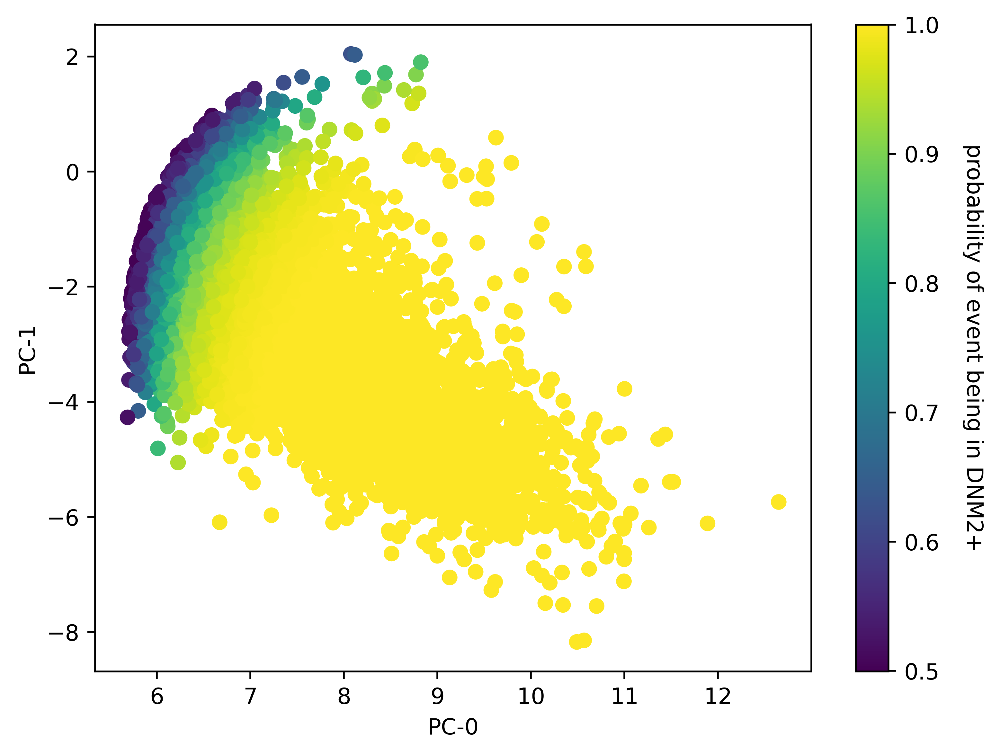

In [100]:
Image(filename=unique_user_saved_outputs+'/plots/probs_dnm2plus_overlaidpcs.png', unconfined=True, height=700, width=700)

# comparing value of principal components and the number of peaks in events

In [101]:
%%capture
plt.figure(dpi=500)
sc = plt.hist2d(probs, num_peaks, bins=20, cmap='viridis', norm=mpl.colors.LogNorm());
plt.xlabel('probability of event being in DNM2+')
plt.ylabel('number of peaks')
cb = plt.colorbar(sc[3])
cb.set_alpha(1)
cb.draw_all()
cb.set_label('counts', rotation=270, labelpad=20)
plt.tight_layout()
plt.savefig(unique_user_saved_outputs+'/plots/num_peaks_vs_probsdnm2plus.png', bbox_inches='tight')

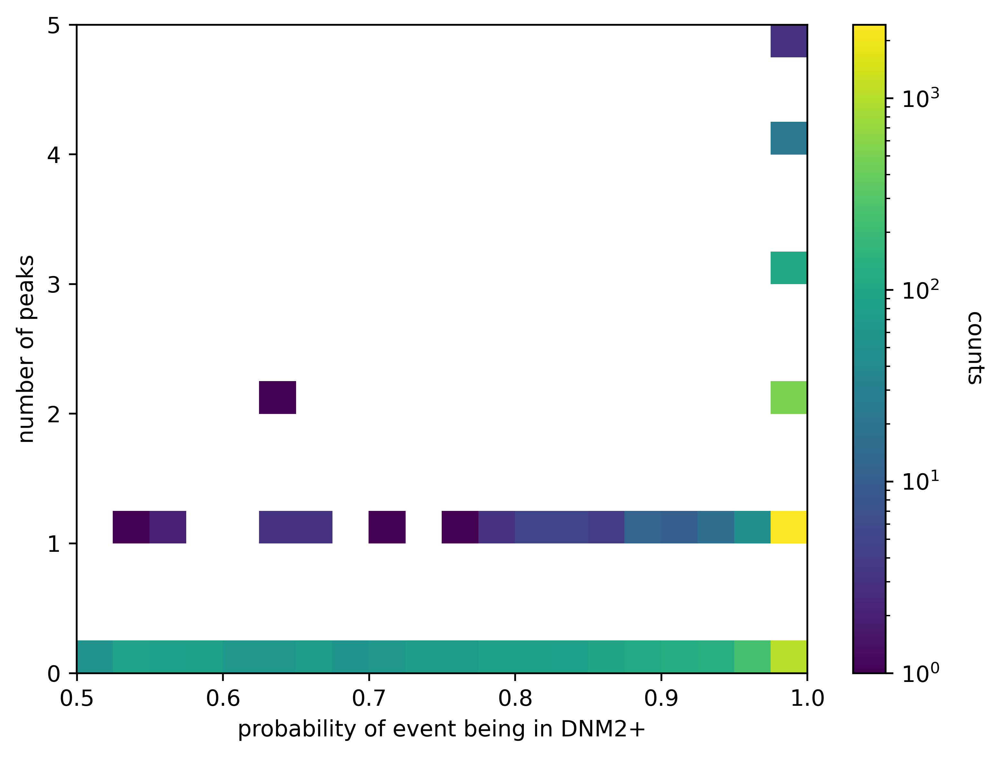

In [102]:
Image(filename=unique_user_saved_outputs+'/plots/num_peaks_vs_probsdnm2plus.png', unconfined=True, height=700, width=700)

In [103]:
%%capture
plt.figure(dpi=500)
sc = plt.hist2d(num_peaks, pc0_dnm2_positive, bins=20, cmap='viridis', norm=mpl.colors.LogNorm());
plt.xlabel('number of peaks')
plt.ylabel('PC-0; DNM2+')
cb = plt.colorbar(sc[3])
cb.set_alpha(1)
cb.draw_all()
cb.set_label('counts', rotation=270, labelpad=20)
plt.tight_layout()
plt.savefig(unique_user_saved_outputs+'/plots/pc0_vs_numpeaks.png', bbox_inches='tight')

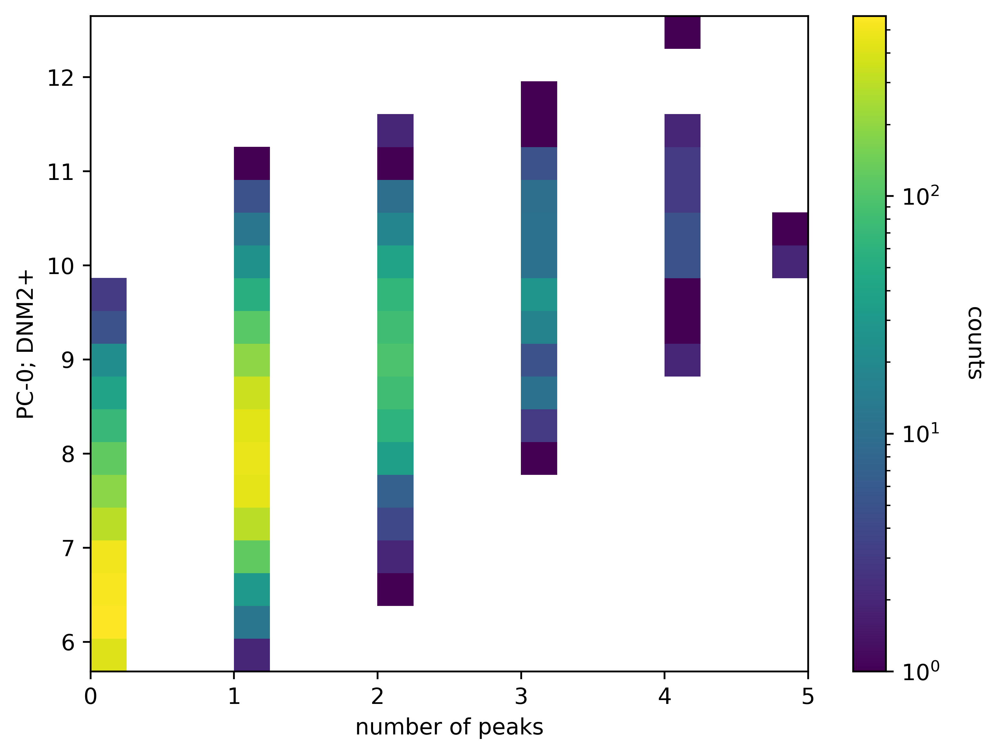

In [104]:
Image(filename=unique_user_saved_outputs+'/plots/pc0_vs_numpeaks.png', unconfined=True, height=700, width=700)

In [105]:
%%capture
plt.figure(dpi=500)
sc = plt.hist2d(num_peaks, pc1_dnm2_positive, bins=20, cmap='viridis', norm=mpl.colors.LogNorm());
plt.xlabel('number of peaks')
plt.ylabel('PC-1; DNM2+')
cb = plt.colorbar(sc[3])
cb.set_alpha(1)
cb.draw_all()
cb.set_label('counts', rotation=270, labelpad=20)
plt.tight_layout()
plt.savefig(unique_user_saved_outputs+'/plots/pc1_vs_numpeaks.png', bbox_inches='tight')

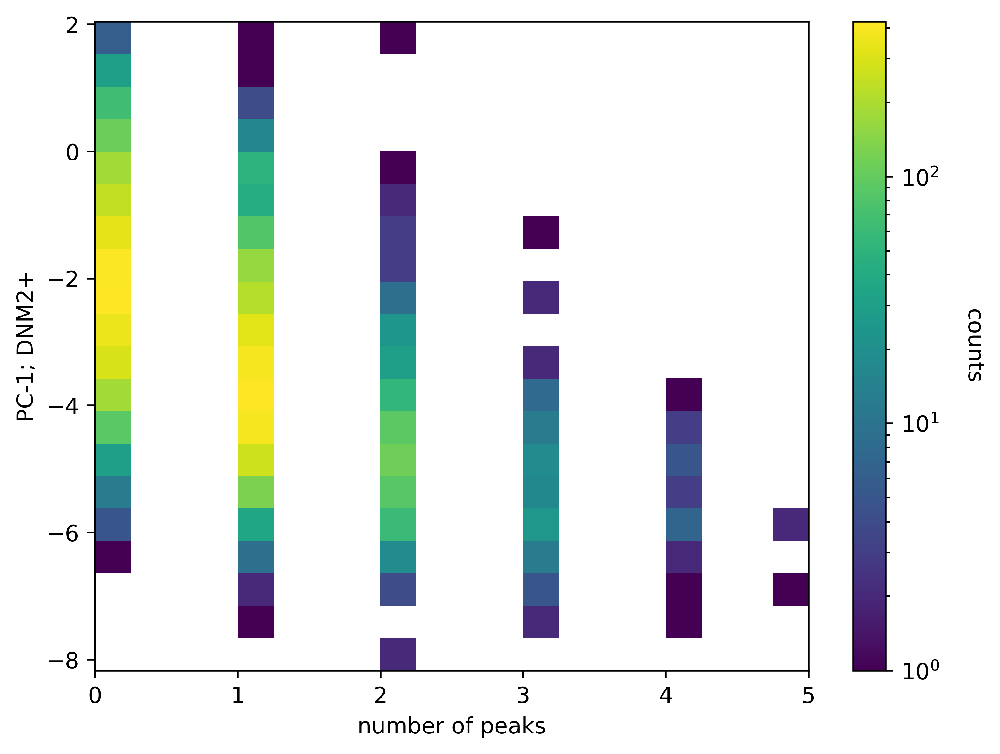

In [106]:
Image(filename=unique_user_saved_outputs+'/plots/pc1_vs_numpeaks.png', unconfined=True, height=700, width=700)

# classifiers using raw features

# classifier between CCPs amongst DNM2+ events

In [107]:
df = df_pcs_normal_scaled_with_gmm_cluster

indices_in_experiment_class_DNM2 = list(df[(df.gmm_predictions==index_DNM2positive)].index)

values_dnm2_positive = df_merged_features.values[:,:30][indices_in_experiment_class_DNM2,:]

all_indices = list(range(len(num_peaks)))

labels = [1 if num==1 else 0 for num in num_peaks]

X_train, X_test, y_train, y_test = train_test_split(values_dnm2_positive, labels, random_state=713, test_size=0.25)

clf = RandomForestClassifier(n_estimators=100, random_state=713)
clf.fit(X_train, y_train)

print("Accuracy on test data: {:.4f}".format(clf.score(X_test, y_test)))

Accuracy on test data: 0.8391


# classifier between non-peaked events amongst DNM2+ events

In [108]:
df = df_pcs_normal_scaled_with_gmm_cluster

indices_in_experiment_class_DNM2 = list(df[(df.gmm_predictions==index_DNM2positive)].index)

values_dnm2_positive = df_merged_features.values[:,:30][indices_in_experiment_class_DNM2,:]

# values_dnm2_positive = preprocessing.StandardScaler().fit_transform(values_dnm2_positive) 

all_indices = list(range(len(num_peaks)))

labels = [1 if num==0 else 0 for num in num_peaks]

X_train, X_test, y_train, y_test = train_test_split(values_dnm2_positive, labels, random_state=713, test_size=0.25)

clf = RandomForestClassifier(n_estimators=100, random_state=713)
clf.fit(X_train, y_train)

print("Accuracy on test data: {:.4f}".format(clf.score(X_test, y_test)))

Accuracy on test data: 0.9232


# classifier between multi-peaked events amongst DNM2+ events

In [109]:
df = df_pcs_normal_scaled_with_gmm_cluster

indices_in_experiment_class_DNM2 = list(df[(df.gmm_predictions==index_DNM2positive)].index)

values_dnm2_positive = df_merged_features.values[:,:30][indices_in_experiment_class_DNM2,:]

# values_dnm2_positive = preprocessing.StandardScaler().fit_transform(values_dnm2_positive) 

all_indices = list(range(len(num_peaks)))

labels = [1 if num>1 else 0 for num in num_peaks]

X_train, X_test, y_train, y_test = train_test_split(values_dnm2_positive, labels, random_state=713, test_size=0.25)

clf = RandomForestClassifier(n_estimators=100, random_state=713)
clf.fit(X_train, y_train)

print("Accuracy on test data: {:.4f}".format(clf.score(X_test, y_test)))

Accuracy on test data: 0.9165


# classifier between CCPs amongst DNM2+ events

In [110]:
df = df_pcs_normal_scaled_with_gmm_cluster

indices_in_experiment_class_DNM2 = list(df[(df.gmm_predictions==index_DNM2positive)].index)

values_dnm2_positive = df.values[:,:2][indices_in_experiment_class_DNM2,:]

# values_dnm2_positive = preprocessing.StandardScaler().fit_transform(values_dnm2_positive) 

all_indices = list(range(len(num_peaks)))

labels = [1 if num==1 else 0 for num in num_peaks]

X_train, X_test, y_train, y_test = train_test_split(values_dnm2_positive, labels, random_state=713, test_size=0.25)

clf = RandomForestClassifier(n_estimators=100, random_state=713)
clf.fit(X_train, y_train)

print("Accuracy on test data: {:.4f}".format(clf.score(X_test, y_test)))

Accuracy on test data: 0.7421


# classifier between non-peaked events amongst DNM2+ events

In [111]:
df = df_pcs_normal_scaled_with_gmm_cluster

indices_in_experiment_class_DNM2 = list(df[(df.gmm_predictions==index_DNM2positive)].index)

values_dnm2_positive = df.values[:,:2][indices_in_experiment_class_DNM2,:]

# values_dnm2_positive = preprocessing.StandardScaler().fit_transform(values_dnm2_positive) 

all_indices = list(range(len(num_peaks)))

labels = [1 if num==0 else 0 for num in num_peaks]

X_train, X_test, y_train, y_test = train_test_split(values_dnm2_positive, labels, random_state=713, test_size=0.25)

clf = RandomForestClassifier(n_estimators=100, random_state=713)
clf.fit(X_train, y_train)

print("Accuracy on test data: {:.4f}".format(clf.score(X_test, y_test)))

Accuracy on test data: 0.8384


# classifier between non-peaked events amongst DNM2+ events

In [112]:
df = df_pcs_normal_scaled_with_gmm_cluster

indices_in_experiment_class_DNM2 = list(df[(df.gmm_predictions==index_DNM2positive)].index)

values_dnm2_positive = df.values[:,:2][indices_in_experiment_class_DNM2,:]

# values_dnm2_positive = preprocessing.StandardScaler().fit_transform(values_dnm2_positive) 

all_indices = list(range(len(num_peaks)))

labels = [1 if num>1 else 0 for num in num_peaks]

X_train, X_test, y_train, y_test = train_test_split(values_dnm2_positive, labels, random_state=713, test_size=0.25)

clf = RandomForestClassifier(n_estimators=100, random_state=713)
clf.fit(X_train, y_train)

print("Accuracy on test data: {:.4f}".format(clf.score(X_test, y_test)))

Accuracy on test data: 0.9057


# cohort plots of all CCPs from 2 color cell line

In [113]:
merged_ccps = tracks_dnm2_positive[np.where(ccp_predictions==1)[0]]

lifetimes_all_ccps = []
channel_amplitudes_all_ccps = []

for i in range(len(merged_ccps)):
    
    lifetimes_all_ccps.append(return_track_attributes.return_track_lifetime(merged_ccps,i))
    
    channel_amplitudes_all_ccps.append([return_track_attributes.return_track_amplitude_no_buffer_channel(merged_ccps,i,0),
                                        return_track_attributes.return_track_amplitude_no_buffer_channel(merged_ccps,i,1)])

# cohort plots of CCPs

In [114]:
%%capture

plt.style.use('default')

fig, axes = plt.subplots(1, 1, dpi=500, figsize=(15,5))


cohorts = [[min(lifetimes_all_ccps),40],[40,60],[60,80],[80,max(lifetimes_all_ccps)]]

offsets, num_in_cohort, max_dnm2_cohort_indices = display_tracks.plot_separated_cohorts([axes], 
                                                                         channel_amplitudes_all_ccps, 
                                                                         1, 
                                                                         cohorts, 
                                                                         [0, 1], 
                                                                         [], 
                                                                         ['AP2', 'DNM2'],
                                                                         ['m', 'g'])

lines_0, labels_0 = axes.get_legend_handles_labels()
axes.legend(lines_0, labels_0, 
            loc='upper center', 
            bbox_to_anchor=(0.88, 0.8), 
            title="{:,}".format(len(channel_amplitudes_all_ccps)) + ' total events')

y_lines = np.arange(0,800,100)

for i in range(1,len(y_lines)):
    
    axes.axhline(y_lines[i], 0, 1, linestyle='--', color='black', alpha=0.2)

text_horizontal_shifts = 3
text_percentage_y = 630
text_bounds_y = 660

for i in range(len(cohorts)):

    if i==0:
        axes.text(text_horizontal_shifts, text_bounds_y, '$\mathregular{lifetime <}$'+str(cohorts[i][1])+' s', fontsize=8)
        axes.text(text_horizontal_shifts, text_percentage_y, "{:.2f}".format(100*num_in_cohort[i]/len(channel_amplitudes_all_ccps)) + '%')
    elif i==len(cohorts)-1:
        axes.text(offsets[i]+text_horizontal_shifts, text_bounds_y, '$\mathregular{lifetime >}$'+str(cohorts[i][0])+' s', fontsize=8)
        axes.text(offsets[i]+text_horizontal_shifts, text_percentage_y, "{:.2f}".format(100*num_in_cohort[i]/len(channel_amplitudes_all_ccps)) + '%')
    else:
        axes.text(offsets[i]+text_horizontal_shifts, text_bounds_y, str(cohorts[i][0])+'$\mathregular{s \leq lifetime <}$'+str(cohorts[i][1])+' s', fontsize=8)
        axes.text(offsets[i]+text_horizontal_shifts, text_percentage_y, "{:.2f}".format(100*num_in_cohort[i]/len(channel_amplitudes_all_ccps)) + '%')
        
x_positions_ticks = []
x_labels_ticks = []
max_ticks_per_cohort = [[1, 1], [2, 2], [3, 3], [6, 3]]

for i in range(len(max_dnm2_cohort_indices)):
    

    num_ticks_before = np.min((int(np.floor((max_dnm2_cohort_indices[i])/10)),max_ticks_per_cohort[i][0]))
    num_ticks_after = np.min((int(np.ceil((cohorts[i][1]-max_dnm2_cohort_indices[i])/10)-1),max_ticks_per_cohort[i][1]))
    for j in range(num_ticks_before):
        
        x_labels_ticks.append(-10*(j+1))
        x_positions_ticks.append(-10*(j+1) + offsets[i] + max_dnm2_cohort_indices[i])
    
    x_labels_ticks.append(0)
    x_positions_ticks.append(offsets[i] + max_dnm2_cohort_indices[i])
    
    for j in range(num_ticks_after):
        
        x_labels_ticks.append(10*(j+1))
        x_positions_ticks.append(10*(j+1) + offsets[i] + max_dnm2_cohort_indices[i])


axes.set_xticks(0.5+np.array(x_positions_ticks), minor=False)
axes.set_xticklabels(x_labels_ticks, minor=False)


axes.set_xlabel('time (s)') 
axes.set_ylabel('a.u. fluorescence')
axes.set_title('CCPs from AP2/DNM2 cell line \naligned to DNM2 peaks, binned in cohorts by AP2 lifetimes')
axes.set_xlim([0,offsets[-1]+cohorts[-1][-1]])    
axes.set_ylim([0,700])  
plt.tight_layout()   
plt.savefig(unique_user_saved_outputs+'/plots/all_overlaid_ap2dnm2_2colorcellline_cohorts_centered_zero.png', bbox_inches='tight')

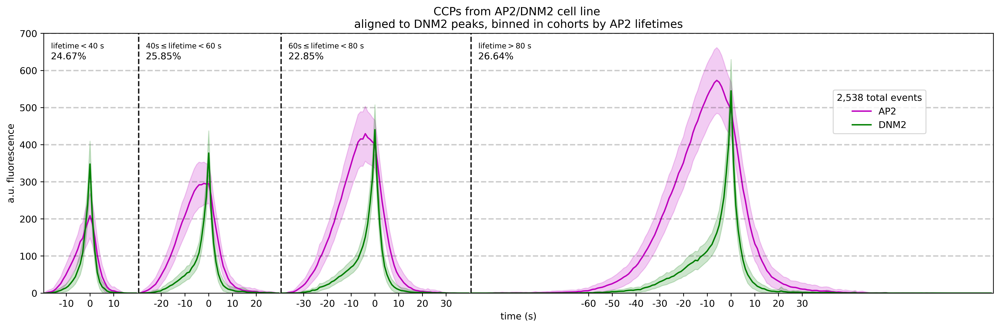

In [115]:
Image(filename=unique_user_saved_outputs+'/plots/all_overlaid_ap2dnm2_2colorcellline_cohorts_centered_zero.png', height=500, width=800)

# cohort plots of all non-peaked DNM2+ events

In [116]:
merged_non_peaked = tracks_dnm2_positive[np.where(np.array(num_peaks)==0)[0]]

lifetimes_non_peaked = []
channel_amplitudes_non_peaked = []

for i in range(len(merged_non_peaked)):
    
    lifetimes_non_peaked.append(return_track_attributes.return_track_lifetime(merged_non_peaked,i))
    
    channel_amplitudes_non_peaked.append([return_track_attributes.return_track_amplitude_no_buffer_channel(merged_non_peaked,i,0),
                                        return_track_attributes.return_track_amplitude_no_buffer_channel(merged_non_peaked,i,1)])

In [117]:
%%capture

plt.style.use('default')

fig, axes = plt.subplots(1, 1, dpi=500, figsize=(15,5))


cohorts = [[min(lifetimes_non_peaked),40],[40,60],[60,80],[80,max(lifetimes_non_peaked)]]

offsets, num_in_cohort, max_dnm2_cohort_indices = display_tracks.plot_separated_cohorts([axes], 
                                                                         channel_amplitudes_non_peaked, 
                                                                         1, 
                                                                         cohorts, 
                                                                         [0, 1], 
                                                                         [], 
                                                                         ['AP2', 'DNM2'],
                                                                         ['m', 'g'])

lines_0, labels_0 = axes.get_legend_handles_labels()
axes.legend(lines_0, labels_0, 
            loc='upper center', 
            bbox_to_anchor=(0.88, 0.8), 
            title="{:,}".format(len(channel_amplitudes_non_peaked)) + ' total events')

y_lines = np.arange(0,800,100)

for i in range(1,len(y_lines)):
    
    axes.axhline(y_lines[i], 0, 1, linestyle='--', color='black', alpha=0.2)

text_horizontal_shifts = 3
text_percentage_y = 630
text_bounds_y = 660

for i in range(len(cohorts)):

    if i==0:
        axes.text(text_horizontal_shifts, text_bounds_y, '$\mathregular{lifetime <}$'+str(cohorts[i][1])+' s', fontsize=8)
        axes.text(text_horizontal_shifts, text_percentage_y, "{:.2f}".format(100*num_in_cohort[i]/len(channel_amplitudes_non_peaked)) + '%')
    elif i==len(cohorts)-1:
        axes.text(offsets[i]+text_horizontal_shifts, text_bounds_y, '$\mathregular{lifetime >}$'+str(cohorts[i][0])+' s', fontsize=8)
        axes.text(offsets[i]+text_horizontal_shifts, text_percentage_y, "{:.2f}".format(100*num_in_cohort[i]/len(channel_amplitudes_non_peaked)) + '%')
    else:
        axes.text(offsets[i]+text_horizontal_shifts, text_bounds_y, str(cohorts[i][0])+'$\mathregular{s \leq lifetime <}$'+str(cohorts[i][1])+' s', fontsize=8)
        axes.text(offsets[i]+text_horizontal_shifts, text_percentage_y, "{:.2f}".format(100*num_in_cohort[i]/len(channel_amplitudes_non_peaked)) + '%')
        
x_positions_ticks = []
x_labels_ticks = []
max_ticks_per_cohort = [[1, 1], [2, 2], [3, 3], [6, 3]]

for i in range(len(max_dnm2_cohort_indices)):
    

    num_ticks_before = np.min((int(np.floor((max_dnm2_cohort_indices[i])/10)),max_ticks_per_cohort[i][0]))
    num_ticks_after = np.min((int(np.ceil((cohorts[i][1]-max_dnm2_cohort_indices[i])/10)-1),max_ticks_per_cohort[i][1]))
    for j in range(num_ticks_before):
        
        x_labels_ticks.append(-10*(j+1))
        x_positions_ticks.append(-10*(j+1) + offsets[i] + max_dnm2_cohort_indices[i])
    
    x_labels_ticks.append(0)
    x_positions_ticks.append(offsets[i] + max_dnm2_cohort_indices[i])
    
    for j in range(num_ticks_after):
        
        x_labels_ticks.append(10*(j+1))
        x_positions_ticks.append(10*(j+1) + offsets[i] + max_dnm2_cohort_indices[i])


axes.set_xticks(0.5+np.array(x_positions_ticks), minor=False)
axes.set_xticklabels(x_labels_ticks, minor=False)


axes.set_xlabel('time (s)') 
axes.set_ylabel('a.u. fluorescence')
axes.set_title('non-peaked events from AP2/DNM2 cell line \naligned to DNM2 peaks, binned in cohorts by AP2 lifetimes')
axes.set_xlim([0,offsets[-1]+cohorts[-1][-1]])    
axes.set_ylim([0,700])  
plt.tight_layout()   
plt.savefig(unique_user_saved_outputs+'/plots/all_overlaid_ap2dnm2_2colorcellline_cohorts_centered_zero_non_peaked.png', bbox_inches='tight')

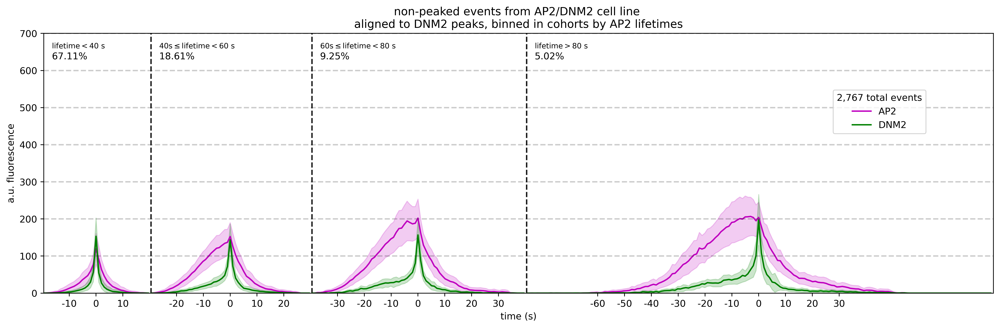

In [118]:
Image(filename=unique_user_saved_outputs+'/plots/all_overlaid_ap2dnm2_2colorcellline_cohorts_centered_zero_non_peaked.png', height=500, width=800)

# examples of non-peaked events

In [119]:
%%capture

plt.figure(dpi=500)
subplot_index = 1

num_plot = 25
number_of_columns = 5
number_of_channels = 2
tracks = tracks_dnm2_positive[np.where(np.array(num_peaks)==0)[0]]


track_indices = list(range(len(tracks)))
num_rows = int(np.ceil(num_plot/number_of_columns))

f = plt.figure(figsize=(3*number_of_columns+5,3*num_rows+5),dpi=100)

tracks_to_plot = tracks

random_indices = list(range(len(tracks_to_plot)))
random.shuffle(random_indices)
track_indices = random_indices[:num_plot]

tracks_to_plot = display_tracks.select_tracks_by_indices(tracks_to_plot, track_indices)    

lifetimes = []

for i in range(len(tracks_to_plot)):

    lifetimes.append(return_track_attributes.return_track_lifetime(tracks_to_plot,i))

sorted_lifetime_indices = sorted(range(len(lifetimes)), key=lambda k: lifetimes[k], reverse=True)

tracks_to_plot_list = [tracks_to_plot[i] for i in sorted_lifetime_indices][:num_plot]




for i in range(len(tracks_to_plot_list)):

    ax = f.add_subplot(num_rows,number_of_columns,subplot_index)

    raw_intensity = np.array(return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_to_plot_list,i,1))
    raw_intensity_ap2 = np.array(return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_to_plot_list,i,0))
    plt.plot(raw_intensity, label='raw DNM2 intensity')
    plt.plot(raw_intensity_ap2, label='raw AP2 intensity')
    sos = signal.butter(4, 0.2, 'lp', fs=1, output='sos')
    filtered_intensity = np.array(list(list(signal.sosfilt(sos, raw_intensity)) +  [0, 0, 0, 0, 0]))

    plt.plot(filtered_intensity, label='filtered DNM2 intensity')
    plt.xlabel('time (s)')
    plt.ylabel('a.u. fluorescence')
    plt.legend(loc='upper left')
    peaks = signal.find_peaks(filtered_intensity, distance=distance_best_fit, height=height_best_fit, width=width_best_fit)[0]
    plt.plot(peaks,filtered_intensity[peaks], 'x', markersize=10)

    subplot_index+=1

plt.tight_layout()    

plt.savefig(unique_user_saved_outputs+'/plots/sample_non_peaked_events_discarded.png', bbox_inches='tight')

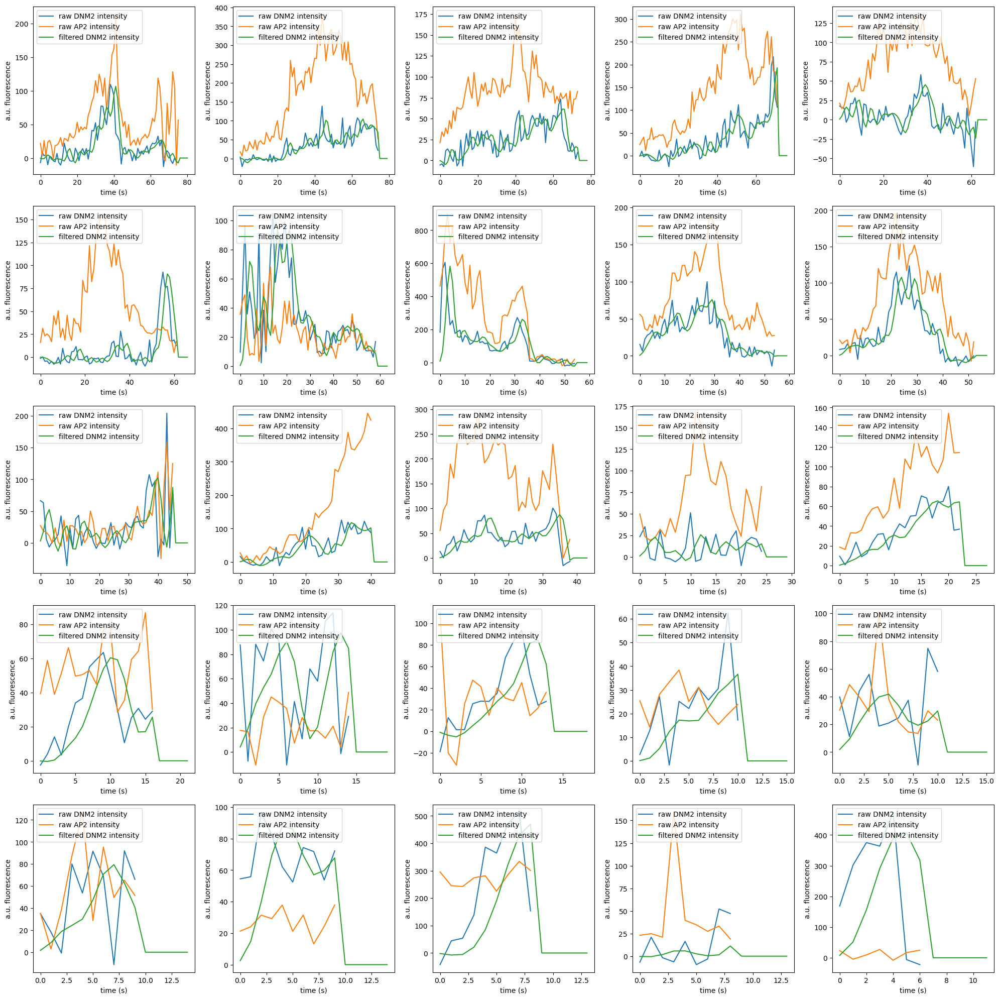

In [120]:
Image(filename=unique_user_saved_outputs+'/plots/sample_non_peaked_events_discarded.png', height=500, width=500)

# cohort plots of events in clusters

In [121]:
%%capture
all_clusters =list(range(number_of_clusters))

for cluster_num in all_clusters:
    
        tracks_to_plot = merged_all_valid_tracks[gmm_class_indices[cluster_num]]
        lifetimes_temp = []
        channel_amplitudes_temp = []

        for i in range(len(tracks_to_plot)):

            lifetimes_temp.append(return_track_attributes.return_track_lifetime(tracks_to_plot,i))

            channel_amplitudes_temp.append([return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_to_plot,i,0),
                                                return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_to_plot,i,1)])
        plt.style.use('default')

        fig, axes = plt.subplots(1, 1, dpi=500, figsize=(15,5))


        cohorts = [[min(lifetimes_temp),40],[40,60],[60,80],[80,max(lifetimes_temp)]]

        offsets, num_in_cohort, max_dnm2_cohort_indices = display_tracks.plot_separated_cohorts([axes], 
                                                                                 channel_amplitudes_temp, 
                                                                                 1, 
                                                                                 cohorts, 
                                                                                 [0, 1], 
                                                                                 [], 
                                                                                 ['AP2', 'DNM2'],
                                                                                 ['m', 'g'])

        lines_0, labels_0 = axes.get_legend_handles_labels()
        axes.legend(lines_0, labels_0, 
                    loc='upper center', 
                    bbox_to_anchor=(0.88, 0.8), 
                    title="{:,}".format(len(channel_amplitudes_temp)) + ' total events')

        y_lines = np.arange(0,800,100)

        for i in range(1,len(y_lines)):

            axes.axhline(y_lines[i], 0, 1, linestyle='--', color='black', alpha=0.2)

        text_horizontal_shifts = 3
        text_percentage_y = 630
        text_bounds_y = 660

        for i in range(len(cohorts)):

            if i==0:
                axes.text(text_horizontal_shifts, text_bounds_y, '$\mathregular{lifetime <}$'+str(cohorts[i][1])+' s', fontsize=8)
                axes.text(text_horizontal_shifts, text_percentage_y, "{:.2f}".format(100*num_in_cohort[i]/len(channel_amplitudes_temp)) + '%')
            elif i==len(cohorts)-1:
                axes.text(offsets[i]+text_horizontal_shifts, text_bounds_y, '$\mathregular{lifetime >}$'+str(cohorts[i][0])+' s', fontsize=8)
                axes.text(offsets[i]+text_horizontal_shifts, text_percentage_y, "{:.2f}".format(100*num_in_cohort[i]/len(channel_amplitudes_temp)) + '%')
            else:
                axes.text(offsets[i]+text_horizontal_shifts, text_bounds_y, str(cohorts[i][0])+'$\mathregular{s \leq lifetime <}$'+str(cohorts[i][1])+' s', fontsize=8)
                axes.text(offsets[i]+text_horizontal_shifts, text_percentage_y, "{:.2f}".format(100*num_in_cohort[i]/len(channel_amplitudes_temp)) + '%')

        x_positions_ticks = []
        x_labels_ticks = []
        max_ticks_per_cohort = [[1, 1], [2, 2], [3, 3], [6, 3]]

        for i in range(len(max_dnm2_cohort_indices)):


            num_ticks_before = np.min((int(np.floor((max_dnm2_cohort_indices[i])/10)),max_ticks_per_cohort[i][0]))
            num_ticks_after = np.min((int(np.ceil((cohorts[i][1]-max_dnm2_cohort_indices[i])/10)-1),max_ticks_per_cohort[i][1]))
            for j in range(num_ticks_before):

                x_labels_ticks.append(-10*(j+1))
                x_positions_ticks.append(-10*(j+1) + offsets[i] + max_dnm2_cohort_indices[i])

            x_labels_ticks.append(0)
            x_positions_ticks.append(offsets[i] + max_dnm2_cohort_indices[i])

            for j in range(num_ticks_after):

                x_labels_ticks.append(10*(j+1))
                x_positions_ticks.append(10*(j+1) + offsets[i] + max_dnm2_cohort_indices[i])


        axes.set_xticks(0.5+np.array(x_positions_ticks), minor=False)
        axes.set_xticklabels(x_labels_ticks, minor=False)


        axes.set_xlabel('time (s)') 
        axes.set_ylabel('a.u. fluorescence')
        axes.set_title('cluster number ' + str(cluster_num) + ' events from AP2/DNM2 cell line \naligned to DNM2 peaks, binned in cohorts by AP2 lifetimes')
        axes.set_xlim([0,offsets[-1]+cohorts[-1][-1]])    
        axes.set_ylim([0,750])  
        plt.tight_layout()
        plt.savefig(unique_user_saved_outputs+'/plots/all_overlaid_ap2dnm2_2colorcellline_cohorts_centered_zero_cluster_'+str(cluster_num)+'.png', bbox_inches='tight')

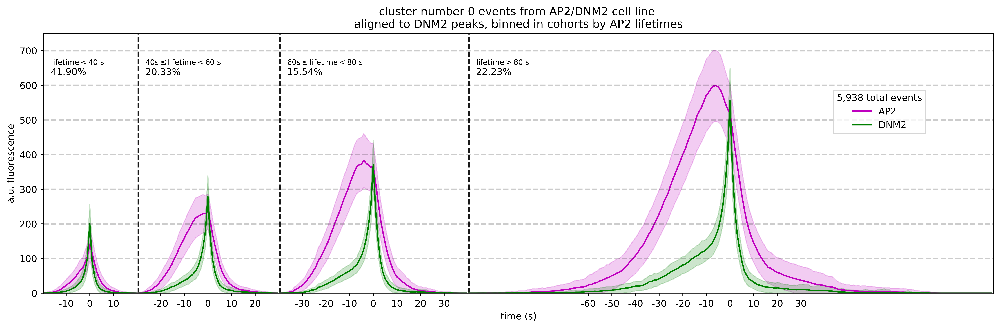

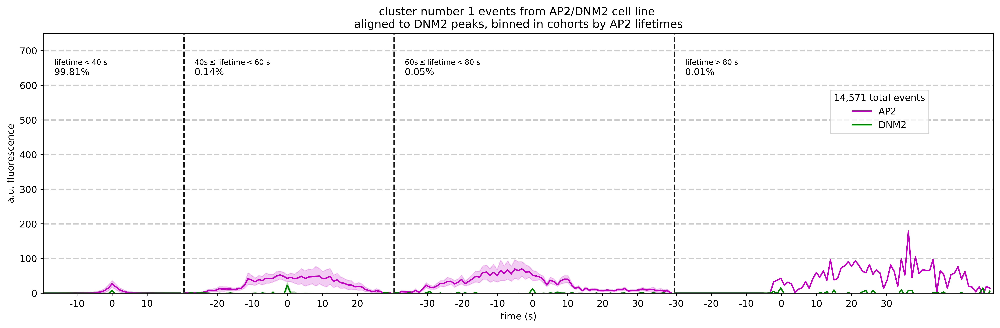

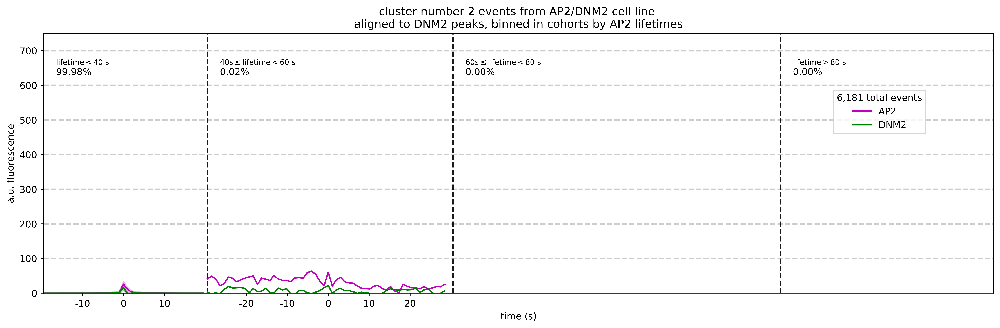

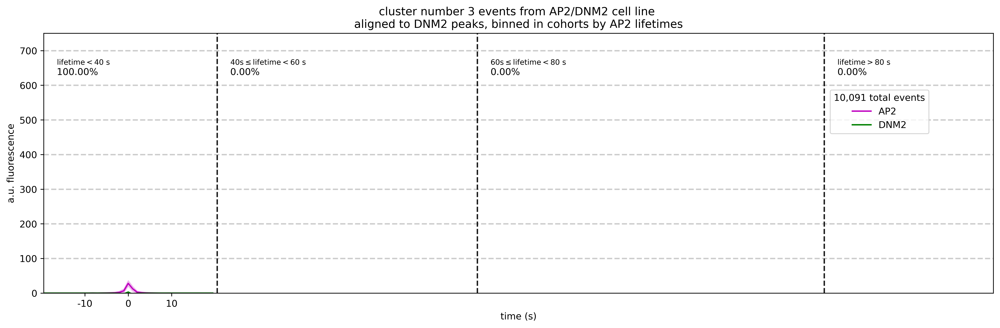

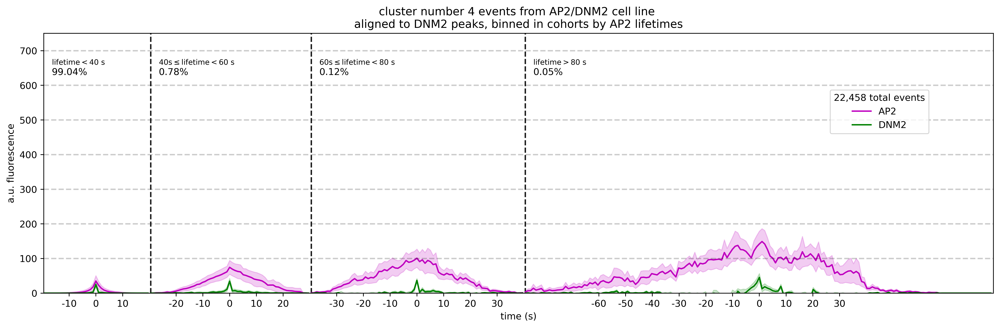

In [122]:
for cluster_num in all_clusters:
    display(Image(filename=unique_user_saved_outputs+'/plots/all_overlaid_ap2dnm2_2colorcellline_cohorts_centered_zero_cluster_'+str(cluster_num)+'.png', height=500, width=500))